In [1]:
# ----------------------------------------------------------------------------------------------------
# 라이브러리 목록

# 기본 라이브러리 
import numpy as np
import pandas as pd

# 시각화 라이브러리 
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns

# 개인 라이브러리 
from preparation_for_analysis.show_window import DataVisualizer

# pandas 설정
pd.set_option('display.max_rows', None)  # 모든 행 출력
pd.set_option('display.max_columns', None)  # 모든 열 출력

# matplotlib 설정
matplotlib.rcParams['font.family'] = 'Malgun Gothic'  # 윈도우에서 사용하는 한글 폰트
matplotlib.rcParams['axes.unicode_minus'] = False  # 음수 기호 문제 해결

# preparation_for_analysis 설정
visualizer = DataVisualizer(line="=", length=100, start="#")
# ----------------------------------------------------------------------------------------------------

In [2]:
# ----------------------------------------------------------------------------------------------------
# learning 불러오기 
learning = pd.read_csv(
    "C:\\Users\\ssalt\\Documents\\ev_price_predict_project\\data\\train\\A_df\\c_learning\\1_learning.csv",
    sep=",",
    header=0
)

visualizer.show_df_info(title="learning.info", df=learning)
# ----------------------------------------------------------------------------------------------------


# Title: learning.info


# DataFrame Information:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6747 entries, 0 to 6746
Data columns (total 11 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Id            6747 non-null   object 
 1   Model         6747 non-null   object 
 2   Manufacturer  6747 non-null   object 
 3   Model_year    6747 non-null   int64  
 4   Drivetrain    6747 non-null   object 
 5   Warranty      6747 non-null   int64  
 6   Accident      6747 non-null   object 
 7   Condition     6747 non-null   object 
 8   Battery       4311 non-null   float64
 9   Mileage       6747 non-null   int64  
 10  Price         6747 non-null   float64
dtypes: float64(2), int64(3), object(6)
memory usage: 579.9+ KB







In [3]:
# ----------------------------------------------------------------------------------------------------
# "Model" 별 가격의 최대, 최소 시각화 

# 모델 종류
model = learning["Model"].unique().tolist()
model.sort(reverse=False)

# 모델 별 최대 최소 값 계산
model_price = []
for i in model:
    price_max = learning.loc[learning["Model"]==i, "Price"].max()
    price_min = learning.loc[learning["Model"]==i, "Price"].min()

    model_price.append((price_min,price_max))

# 데이터프레임을 구성 
model_price = pd.DataFrame(data=model_price,
                           columns=["Price_min", "Price_max"])

# 모델 종류 추가
model_price["Model"] = model

# 컬럼 순서 재정렬 
model_price = model_price[["Model","Price_min","Price_max"]]

# model_price 확인 
visualizer.show_data(title="Model_Price", data=model_price)
# ----------------------------------------------------------------------------------------------------


# Title: Model_Price


# Data:

     Model  Price_min  Price_max
0      EV6      39.75      49.08
1      ID4      33.01      42.11
2     ION5      33.32      36.00
3     ION6      36.35      39.00
4    IONIQ       9.00      27.53
5      KNE      20.55      29.07
6       M3      45.72      55.00
7       MS      63.11      84.55
8       MX      70.89      94.75
9       MY      62.81      78.99
10    Niro      20.61      29.12
11    Q4eT      52.01      60.00
12  RSeTGT      94.00     101.19
13    Soul      16.56      24.09
14     Tay      95.00     122.07
15   TayCT     119.00     132.00
16  TayGTS     151.00     161.09
17      eT      58.92      74.75
18      i3      21.72      25.00
19      i5      59.79      66.06
20      iX      78.92      81.15







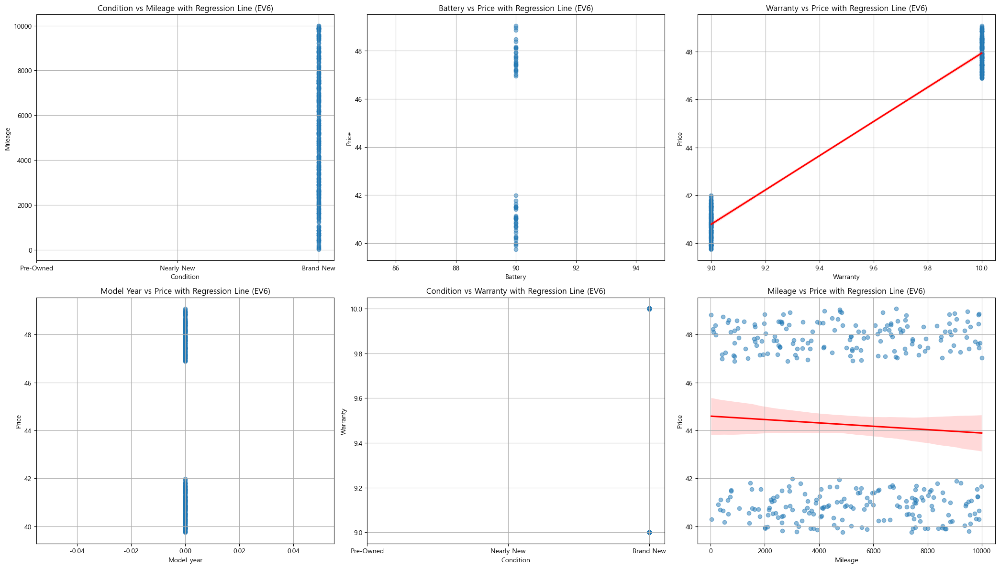

In [12]:
# ----------------------------------------------------------------------------------------------------
# EV6 모델 

model_name = "EV6"

result = learning.loc[(learning["Model"] == model_name), :]

result.loc[result["Condition"] == "Brand New","Condition"] = 2.0
result.loc[result["Condition"] == "Nearly New","Condition"] = 1.0
result.loc[result["Condition"] == "Pre-Owned","Condition"] = 0.0

result["Condition"] = result["Condition"].astype("float64")

# Figure 생성
plt.figure(figsize=(21, 12))

# 1행 3열 그래프
plt.subplot(2, 3, 1)  # (2행 3열) 중 1번째
sns.regplot(data=result, x="Condition", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Mileage")
plt.title(f"Condition vs Mileage with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 2)  # (2행 3열) 중 2번째
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 3)  # (2행 3열) 중 3번째
sns.regplot(data=result, x="Warranty", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Warranty")
plt.ylabel("Price")
plt.title(f"Warranty vs Price with Regression Line ({model_name})")
plt.grid(True)

# 2행 3열 그래프
plt.subplot(2, 3, 4)  # (2행 3열) 중 4번째
sns.regplot(data=result, x="Model_year", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Model_year")
plt.ylabel("Price")
plt.title(f"Model Year vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 5)  # (2행 3열) 중 5번째
sns.regplot(data=result, x="Condition", y="Warranty", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Warranty")
plt.title(f"Condition vs Warranty with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 6)  # (2행 3열) 중 6번째
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()  # 그래프 간 간격 자동 조정
plt.show()
# ----------------------------------------------------------------------------------------------------

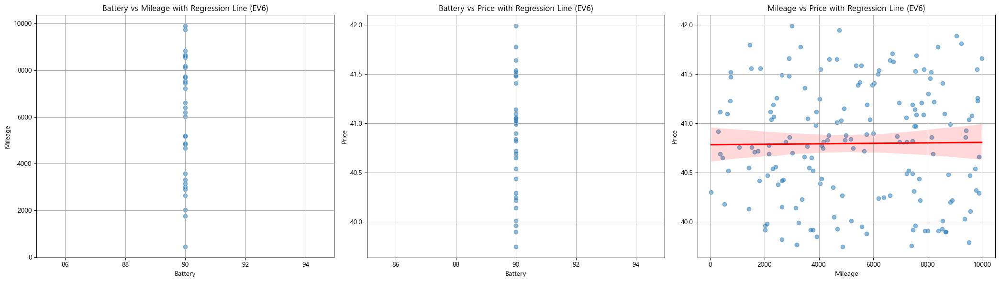

In [14]:
# ----------------------------------------------------------------------------------------------------
# EV6 모델

model_name = "EV6"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 9) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

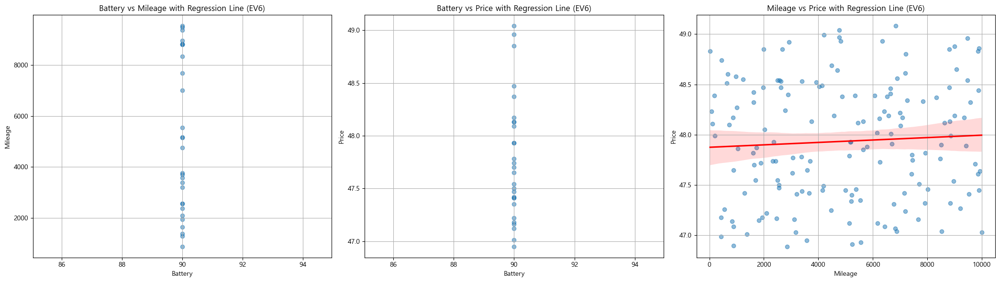

In [6]:
# ----------------------------------------------------------------------------------------------------
# EV6 모델 

model_name = "EV6"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 10) &
                      (learning["Condition"] == "Brand New"), :]


# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

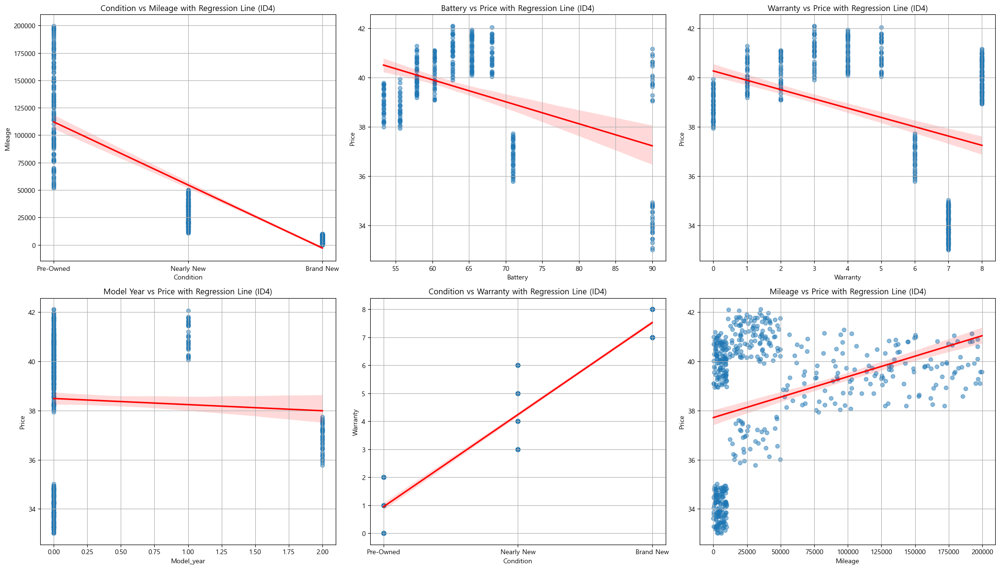

In [15]:
# ----------------------------------------------------------------------------------------------------
# ID4 모델 

model_name = "ID4"

result = learning.loc[(learning["Model"] == model_name), :]

result.loc[result["Condition"] == "Brand New","Condition"] = 2.0
result.loc[result["Condition"] == "Nearly New","Condition"] = 1.0
result.loc[result["Condition"] == "Pre-Owned","Condition"] = 0.0

result["Condition"] = result["Condition"].astype("float64")

# Figure 생성
plt.figure(figsize=(21, 12))

# 1행 3열 그래프
plt.subplot(2, 3, 1)  # (2행 3열) 중 1번째
sns.regplot(data=result, x="Condition", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Mileage")
plt.title(f"Condition vs Mileage with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 2)  # (2행 3열) 중 2번째
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 3)  # (2행 3열) 중 3번째
sns.regplot(data=result, x="Warranty", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Warranty")
plt.ylabel("Price")
plt.title(f"Warranty vs Price with Regression Line ({model_name})")
plt.grid(True)

# 2행 3열 그래프
plt.subplot(2, 3, 4)  # (2행 3열) 중 4번째
sns.regplot(data=result, x="Model_year", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Model_year")
plt.ylabel("Price")
plt.title(f"Model Year vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 5)  # (2행 3열) 중 5번째
sns.regplot(data=result, x="Condition", y="Warranty", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Warranty")
plt.title(f"Condition vs Warranty with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 6)  # (2행 3열) 중 6번째
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()  # 그래프 간 간격 자동 조정
plt.show()
# ----------------------------------------------------------------------------------------------------

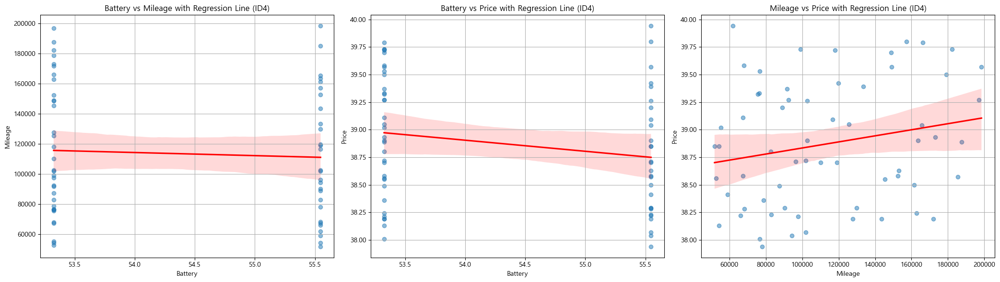

In [33]:
# ----------------------------------------------------------------------------------------------------
# ID4 모델 

model_name = "ID4"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 0) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

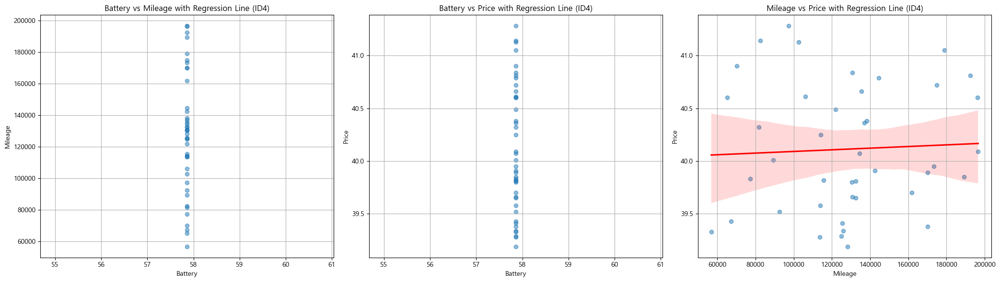

In [ ]:
# ----------------------------------------------------------------------------------------------------
# ID4 모델 

model_name = "ID4"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 1) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

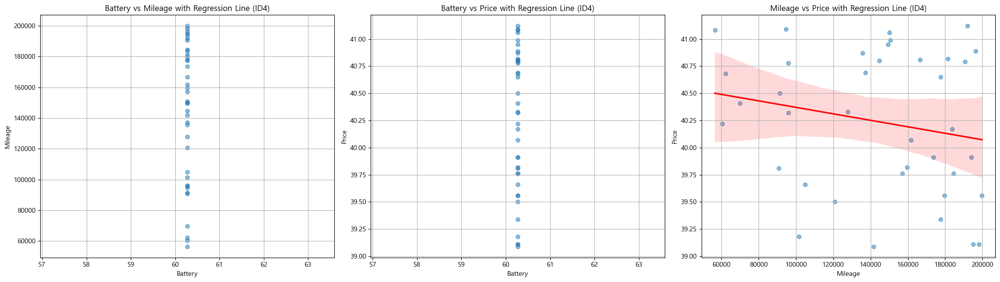

In [ ]:
# ----------------------------------------------------------------------------------------------------
# ID4 모델 

model_name = "ID4"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 2) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

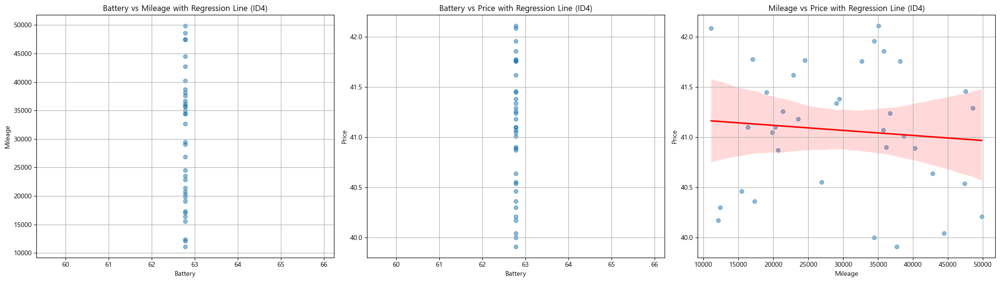

In [ ]:
# ----------------------------------------------------------------------------------------------------
# ID4 모델 

model_name = "ID4"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 3) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

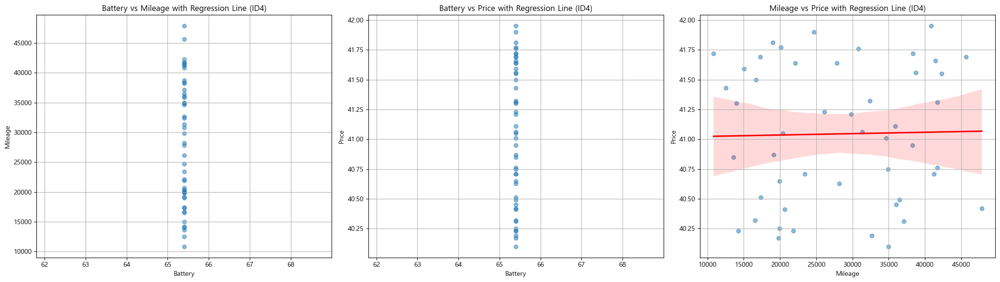

In [ ]:
# ----------------------------------------------------------------------------------------------------
# ID4 모델 

model_name = "ID4"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 4) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

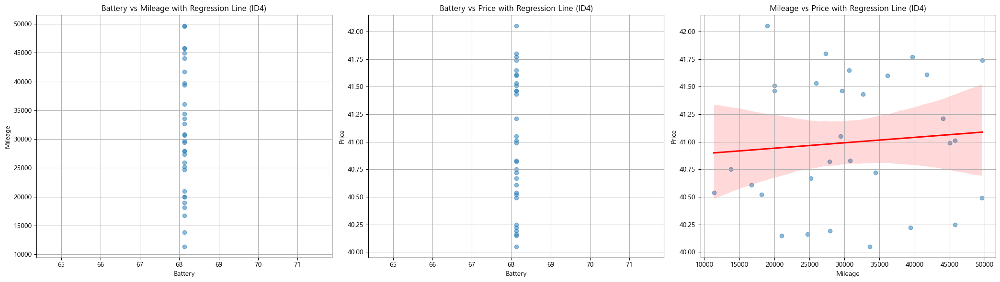

In [ ]:
# ----------------------------------------------------------------------------------------------------
# ID4 모델 

model_name = "ID4"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 5) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

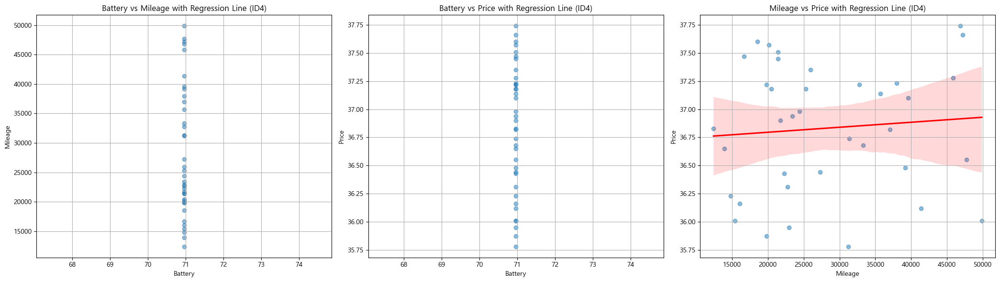

In [ ]:
# ----------------------------------------------------------------------------------------------------
# ID4 모델 

model_name = "ID4"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 6) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

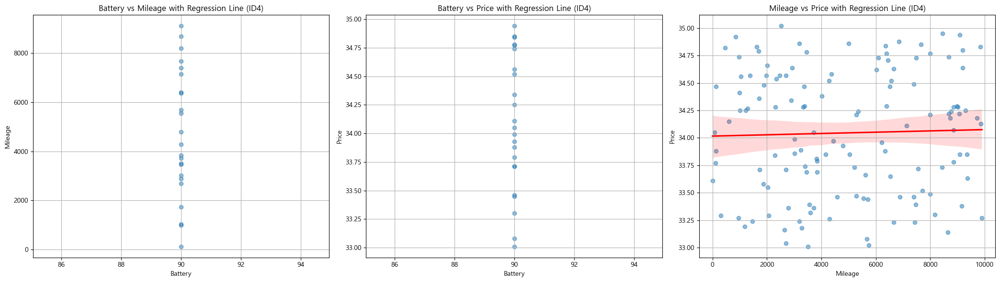

In [ ]:
# ----------------------------------------------------------------------------------------------------
# ID4 모델 

model_name = "ID4"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 7) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

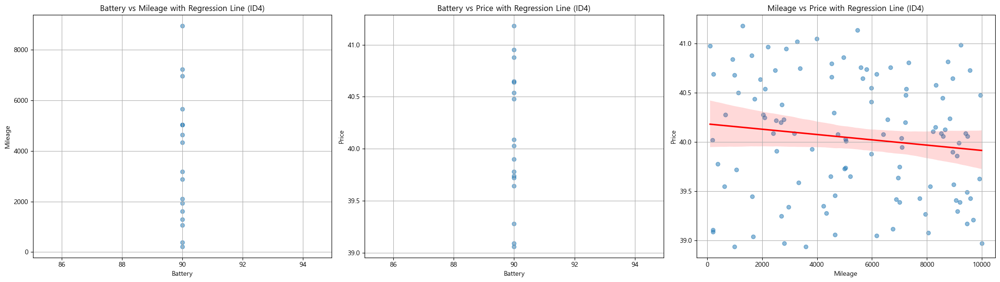

In [ ]:
# ----------------------------------------------------------------------------------------------------
# ID4 모델 

model_name = "ID4"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 8) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

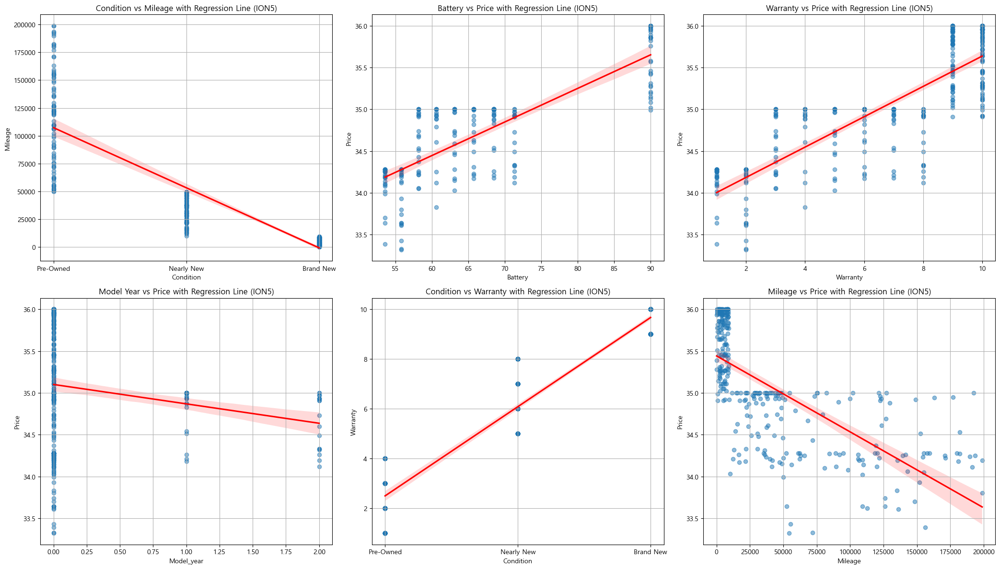

In [16]:
# ----------------------------------------------------------------------------------------------------
# ION5 모델 

model_name = "ION5"

result = learning.loc[(learning["Model"] == model_name), :]

result.loc[result["Condition"] == "Brand New","Condition"] = 2.0
result.loc[result["Condition"] == "Nearly New","Condition"] = 1.0
result.loc[result["Condition"] == "Pre-Owned","Condition"] = 0.0

result["Condition"] = result["Condition"].astype("float64")

# Figure 생성
plt.figure(figsize=(21, 12))

# 1행 3열 그래프
plt.subplot(2, 3, 1)  # (2행 3열) 중 1번째
sns.regplot(data=result, x="Condition", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Mileage")
plt.title(f"Condition vs Mileage with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 2)  # (2행 3열) 중 2번째
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 3)  # (2행 3열) 중 3번째
sns.regplot(data=result, x="Warranty", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Warranty")
plt.ylabel("Price")
plt.title(f"Warranty vs Price with Regression Line ({model_name})")
plt.grid(True)

# 2행 3열 그래프
plt.subplot(2, 3, 4)  # (2행 3열) 중 4번째
sns.regplot(data=result, x="Model_year", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Model_year")
plt.ylabel("Price")
plt.title(f"Model Year vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 5)  # (2행 3열) 중 5번째
sns.regplot(data=result, x="Condition", y="Warranty", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Warranty")
plt.title(f"Condition vs Warranty with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 6)  # (2행 3열) 중 6번째
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()  # 그래프 간 간격 자동 조정
plt.show()
# ----------------------------------------------------------------------------------------------------

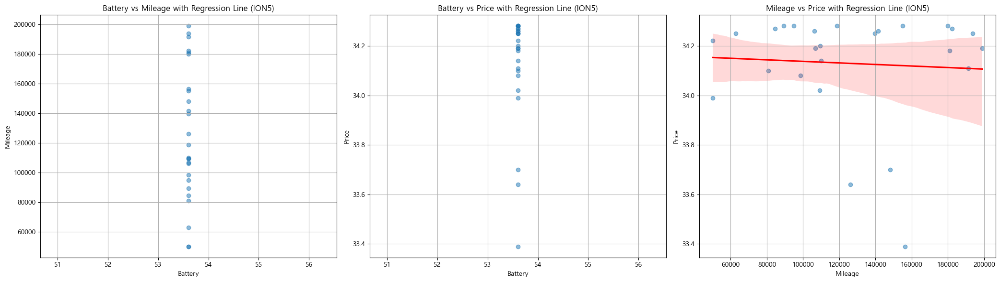

In [ ]:
# ----------------------------------------------------------------------------------------------------
# ION5 모델 

model_name = "ION5"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 1) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

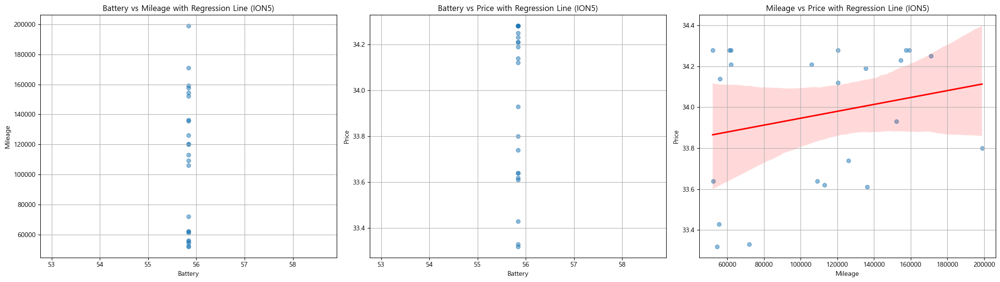

In [ ]:
# ----------------------------------------------------------------------------------------------------
# ION5 모델 

model_name = "ION5"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 2) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

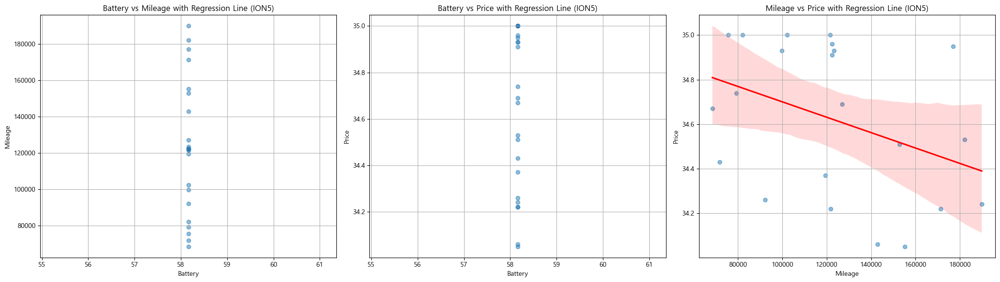

In [ ]:
# ----------------------------------------------------------------------------------------------------
# ION5 모델 

model_name = "ION5"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 3) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

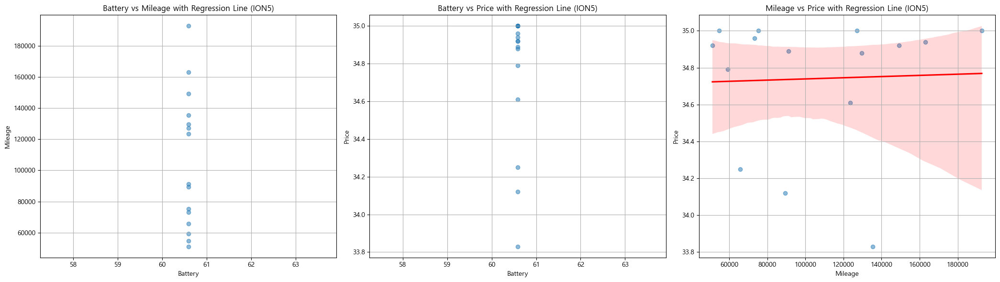

In [ ]:
# ----------------------------------------------------------------------------------------------------
# ION5 모델 

model_name = "ION5"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 4) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

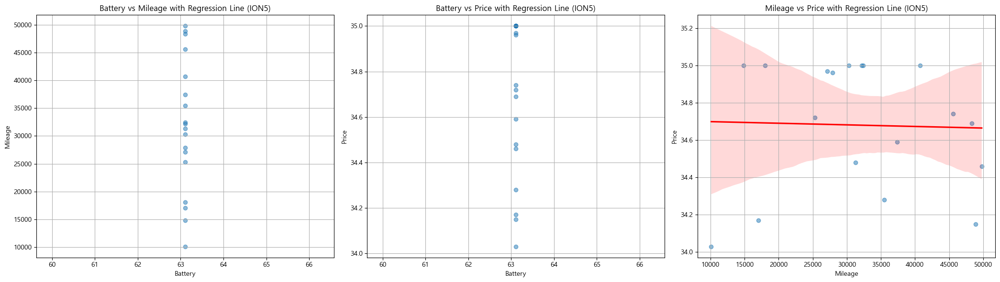

In [ ]:
# ----------------------------------------------------------------------------------------------------
# ION5 모델 

model_name = "ION5"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 5) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

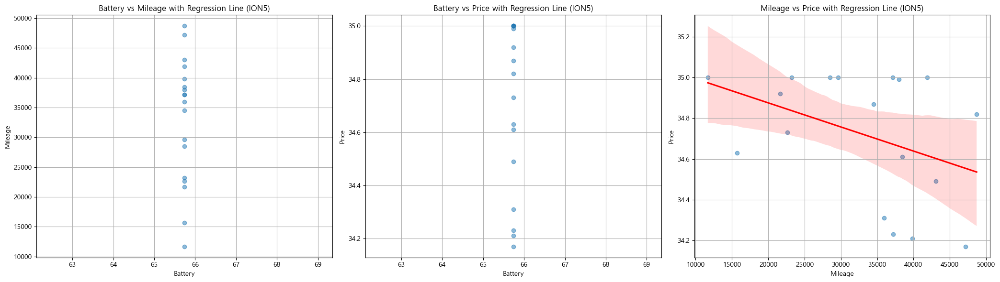

In [ ]:
# ----------------------------------------------------------------------------------------------------
# ION5 모델 

model_name = "ION5"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 6) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

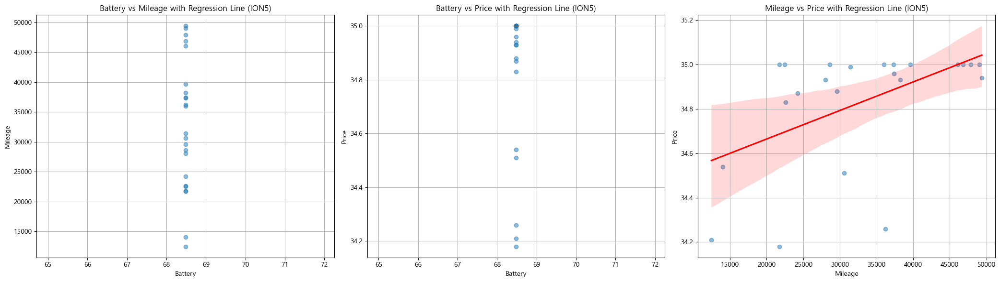

In [ ]:
# ----------------------------------------------------------------------------------------------------
# ION5 모델 

model_name = "ION5"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 7) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

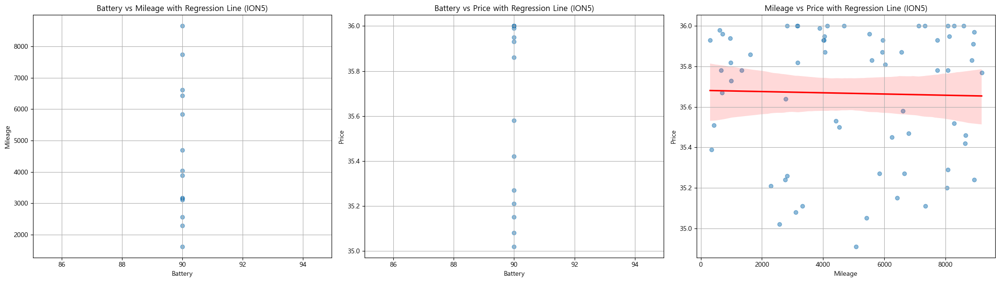

In [ ]:
# ----------------------------------------------------------------------------------------------------
# ION5 모델 

model_name = "ION5"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 9) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

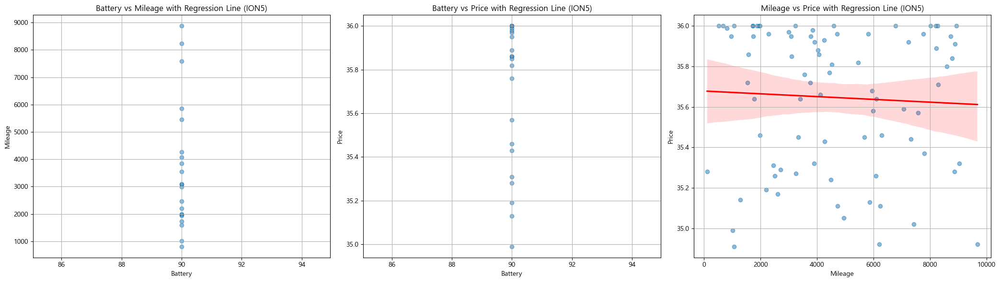

In [ ]:
# ----------------------------------------------------------------------------------------------------
# ION5 모델 

model_name = "ION5"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 10) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

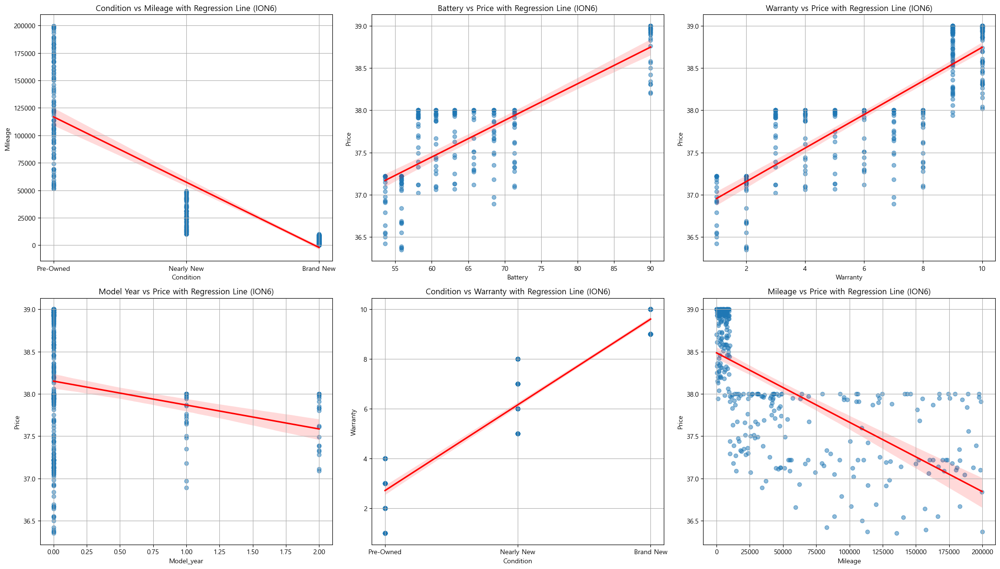

In [17]:
# ----------------------------------------------------------------------------------------------------
# ION6 모델 

model_name = "ION6"

result = learning.loc[(learning["Model"] == model_name), :]

result.loc[result["Condition"] == "Brand New","Condition"] = 2.0
result.loc[result["Condition"] == "Nearly New","Condition"] = 1.0
result.loc[result["Condition"] == "Pre-Owned","Condition"] = 0.0

result["Condition"] = result["Condition"].astype("float64")

# Figure 생성
plt.figure(figsize=(21, 12))

# 1행 3열 그래프
plt.subplot(2, 3, 1)  # (2행 3열) 중 1번째
sns.regplot(data=result, x="Condition", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Mileage")
plt.title(f"Condition vs Mileage with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 2)  # (2행 3열) 중 2번째
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 3)  # (2행 3열) 중 3번째
sns.regplot(data=result, x="Warranty", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Warranty")
plt.ylabel("Price")
plt.title(f"Warranty vs Price with Regression Line ({model_name})")
plt.grid(True)

# 2행 3열 그래프
plt.subplot(2, 3, 4)  # (2행 3열) 중 4번째
sns.regplot(data=result, x="Model_year", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Model_year")
plt.ylabel("Price")
plt.title(f"Model Year vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 5)  # (2행 3열) 중 5번째
sns.regplot(data=result, x="Condition", y="Warranty", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Warranty")
plt.title(f"Condition vs Warranty with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 6)  # (2행 3열) 중 6번째
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()  # 그래프 간 간격 자동 조정
plt.show()
# ----------------------------------------------------------------------------------------------------

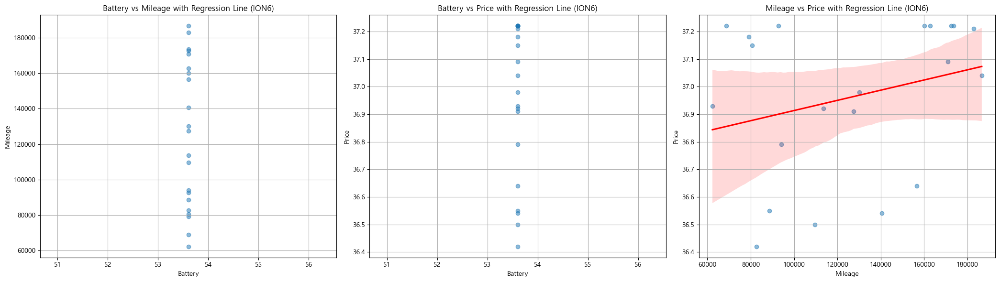

In [ ]:
# ----------------------------------------------------------------------------------------------------
# ION6 모델 

model_name = "ION6"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 1) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

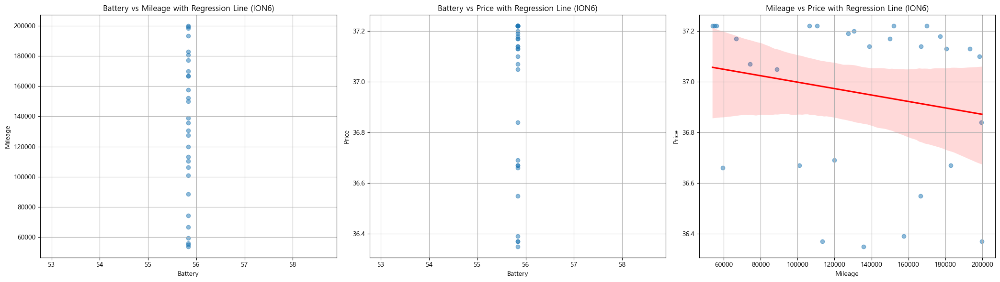

In [ ]:
# ----------------------------------------------------------------------------------------------------
# ION6 모델 

model_name = "ION6"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 2) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

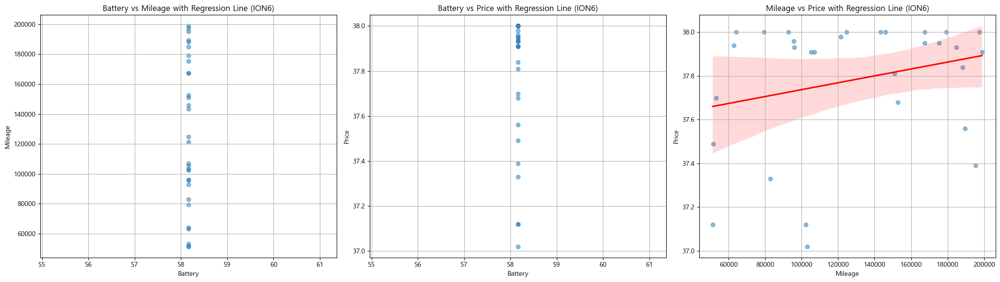

In [ ]:
# ----------------------------------------------------------------------------------------------------
# ION6 모델 

model_name = "ION6"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 3) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

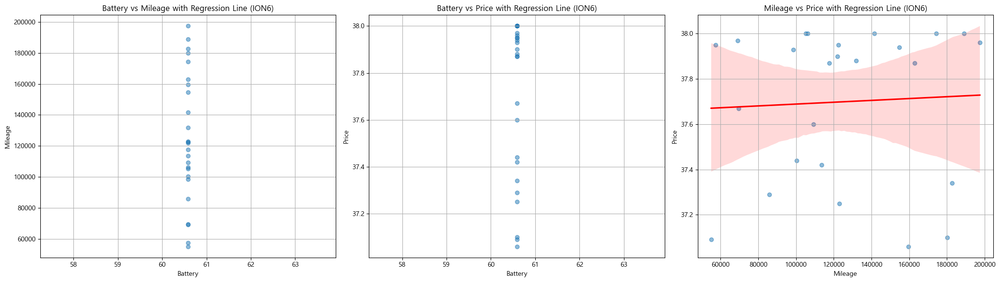

In [ ]:
# ----------------------------------------------------------------------------------------------------
# ION6 모델 

model_name = "ION6"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 4) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

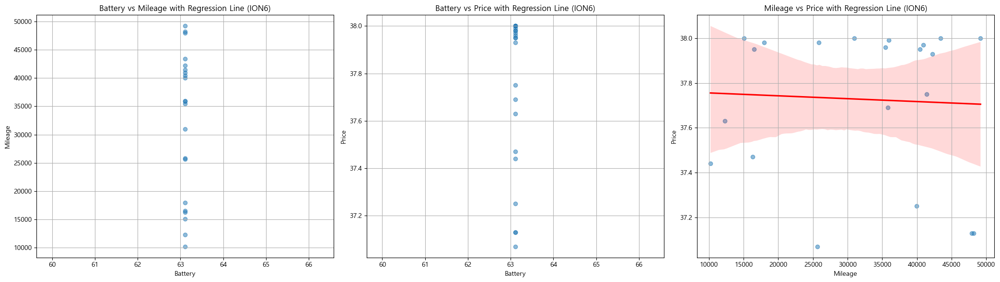

In [ ]:
# ----------------------------------------------------------------------------------------------------
# ION6 모델 

model_name = "ION6"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 5) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

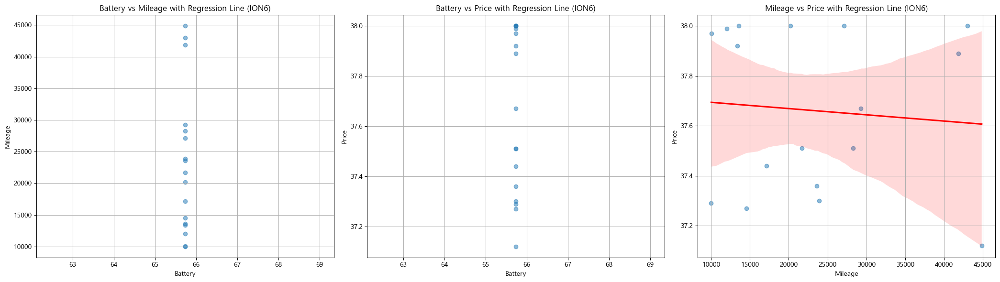

In [ ]:
# ----------------------------------------------------------------------------------------------------
# ION6 모델 

model_name = "ION6"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 6) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

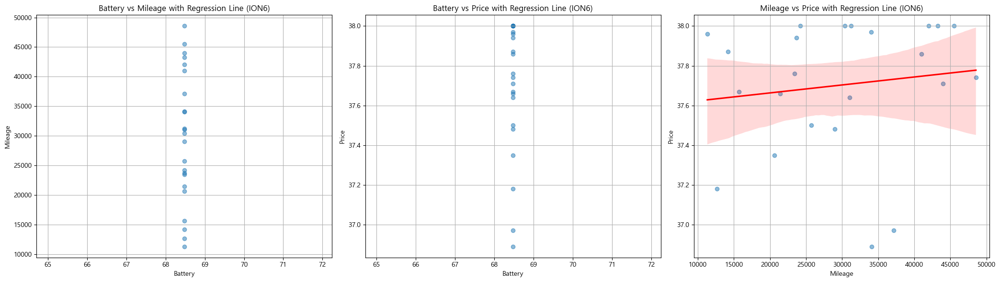

In [ ]:
# ----------------------------------------------------------------------------------------------------
# ION6 모델 

model_name = "ION6"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 7) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

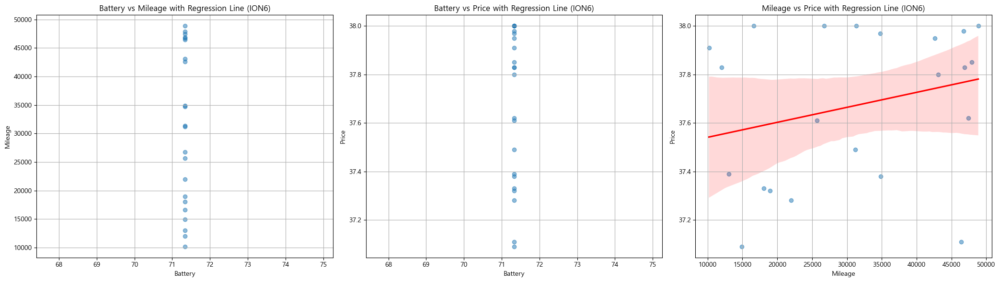

In [ ]:
# ----------------------------------------------------------------------------------------------------
# ION6 모델 

model_name = "ION6"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 8) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

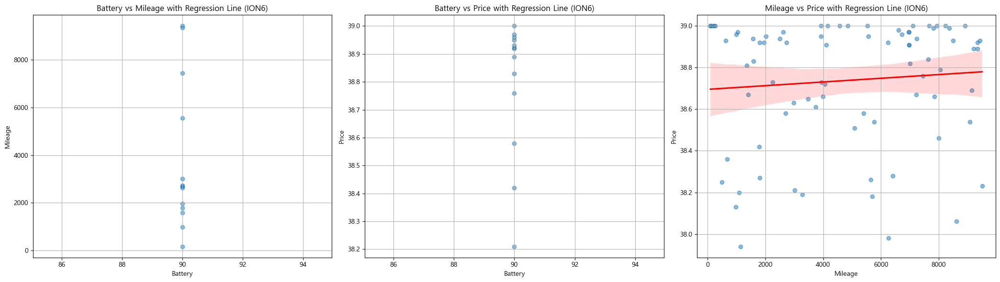

In [ ]:
# ----------------------------------------------------------------------------------------------------
# ION6 모델 

model_name = "ION6"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 9) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

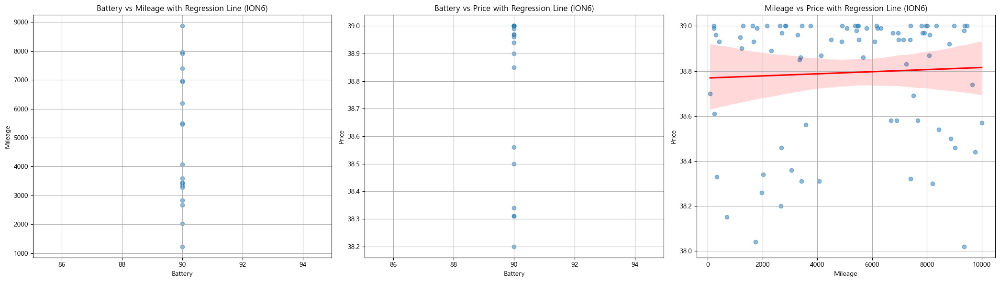

In [ ]:
# ----------------------------------------------------------------------------------------------------
# ION6 모델 

model_name = "ION6"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 10) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

In [1]:
# ----------------------------------------------------------------------------------------------------
# IONIQ 모델 

model_name = "IONIQ"

result = learning.loc[(learning["Model"] == model_name), :]

result.loc[result["Condition"] == "Brand New","Condition"] = 2.0
result.loc[result["Condition"] == "Nearly New","Condition"] = 1.0
result.loc[result["Condition"] == "Pre-Owned","Condition"] = 0.0

result["Condition"] = result["Condition"].astype("float64")

# Figure 생성
plt.figure(figsize=(21, 12))

# 1행 3열 그래프
plt.subplot(2, 3, 1)  # (2행 3열) 중 1번째
sns.regplot(data=result, x="Condition", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Mileage")
plt.title(f"Condition vs Mileage with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 2)  # (2행 3열) 중 2번째
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 3)  # (2행 3열) 중 3번째
sns.regplot(data=result, x="Warranty", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Warranty")
plt.ylabel("Price")
plt.title(f"Warranty vs Price with Regression Line ({model_name})")
plt.grid(True)

# 2행 3열 그래프
plt.subplot(2, 3, 4)  # (2행 3열) 중 4번째
sns.regplot(data=result, x="Model_year", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Model_year")
plt.ylabel("Price")
plt.title(f"Model Year vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 5)  # (2행 3열) 중 5번째
sns.regplot(data=result, x="Condition", y="Warranty", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Warranty")
plt.title(f"Condition vs Warranty with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 6)  # (2행 3열) 중 6번째
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()  # 그래프 간 간격 자동 조정
plt.show()
# ----------------------------------------------------------------------------------------------------

NameError: name 'learning' is not defined

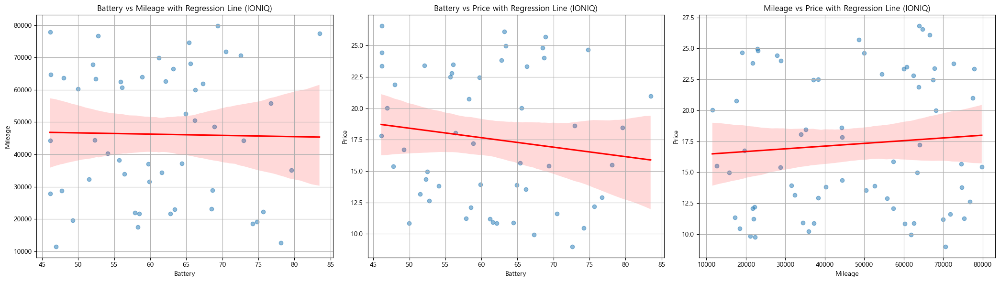

In [19]:
# ----------------------------------------------------------------------------------------------------
# IONIQ 모델 

model_name = "IONIQ"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 1) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

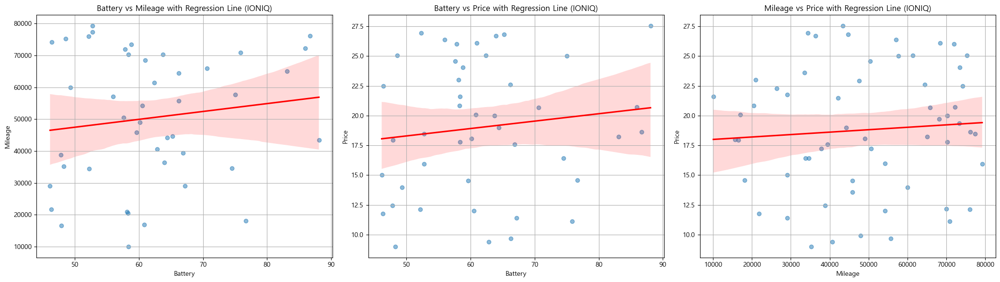

In [20]:
# ----------------------------------------------------------------------------------------------------
# IONIQ 모델 

model_name = "IONIQ"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 3) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

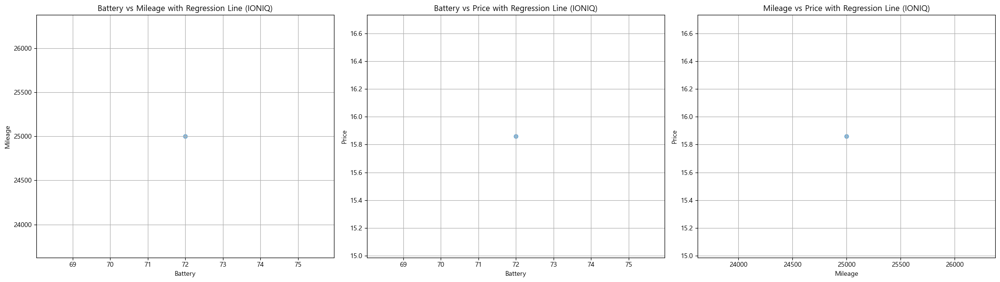

In [21]:
# ----------------------------------------------------------------------------------------------------
# IONIQ 모델 

model_name = "IONIQ"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 8) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

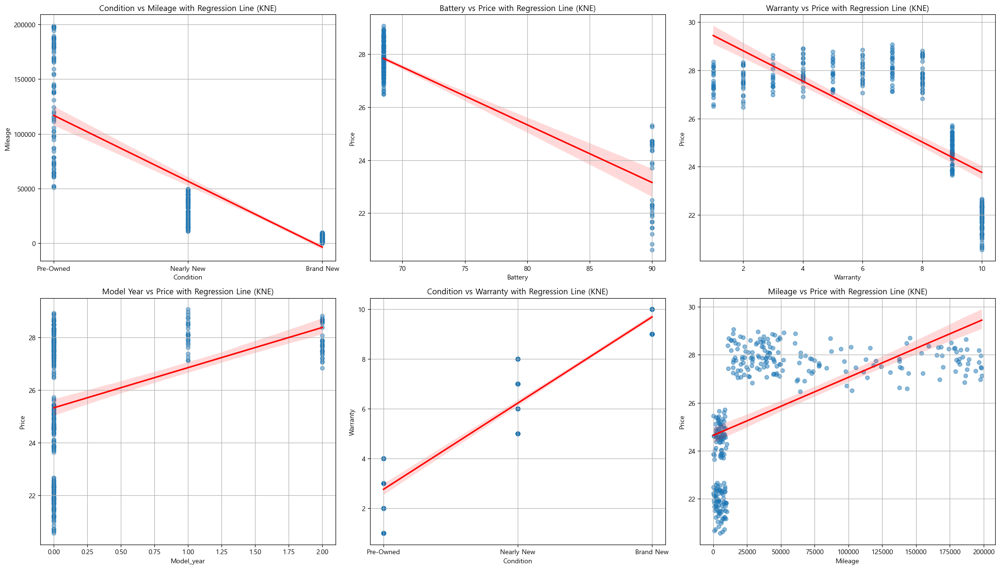

In [23]:
# ----------------------------------------------------------------------------------------------------
# KNE 모델 

model_name = "KNE"

result = learning.loc[(learning["Model"] == model_name), :]

result.loc[result["Condition"] == "Brand New","Condition"] = 2.0
result.loc[result["Condition"] == "Nearly New","Condition"] = 1.0
result.loc[result["Condition"] == "Pre-Owned","Condition"] = 0.0

result["Condition"] = result["Condition"].astype("float64")

# Figure 생성
plt.figure(figsize=(21, 12))

# 1행 3열 그래프
plt.subplot(2, 3, 1)  # (2행 3열) 중 1번째
sns.regplot(data=result, x="Condition", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Mileage")
plt.title(f"Condition vs Mileage with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 2)  # (2행 3열) 중 2번째
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 3)  # (2행 3열) 중 3번째
sns.regplot(data=result, x="Warranty", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Warranty")
plt.ylabel("Price")
plt.title(f"Warranty vs Price with Regression Line ({model_name})")
plt.grid(True)

# 2행 3열 그래프
plt.subplot(2, 3, 4)  # (2행 3열) 중 4번째
sns.regplot(data=result, x="Model_year", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Model_year")
plt.ylabel("Price")
plt.title(f"Model Year vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 5)  # (2행 3열) 중 5번째
sns.regplot(data=result, x="Condition", y="Warranty", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Warranty")
plt.title(f"Condition vs Warranty with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 6)  # (2행 3열) 중 6번째
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()  # 그래프 간 간격 자동 조정
plt.show()
# ----------------------------------------------------------------------------------------------------

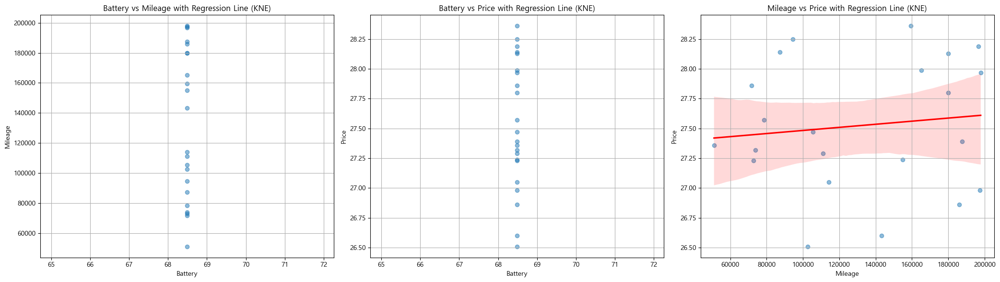

In [ ]:
# ----------------------------------------------------------------------------------------------------
# KNE 모델 

model_name = "KNE"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 1) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

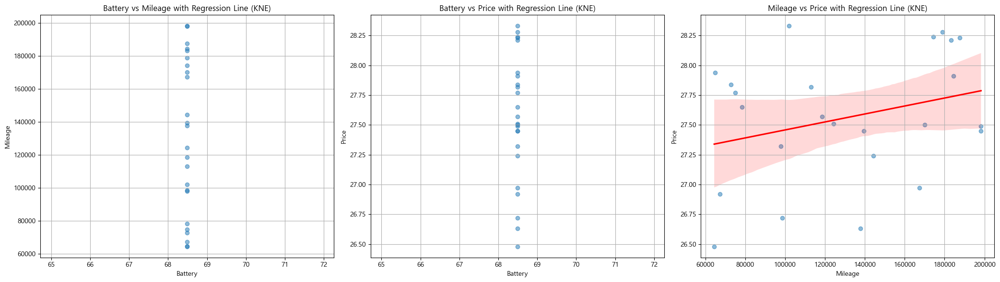

In [ ]:
# ----------------------------------------------------------------------------------------------------
# KNE 모델 

model_name = "KNE"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 2) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

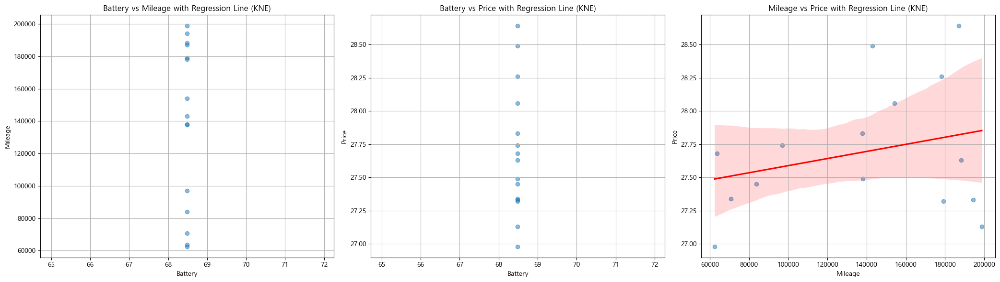

In [ ]:
# ----------------------------------------------------------------------------------------------------
# KNE 모델 

model_name = "KNE"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 3) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

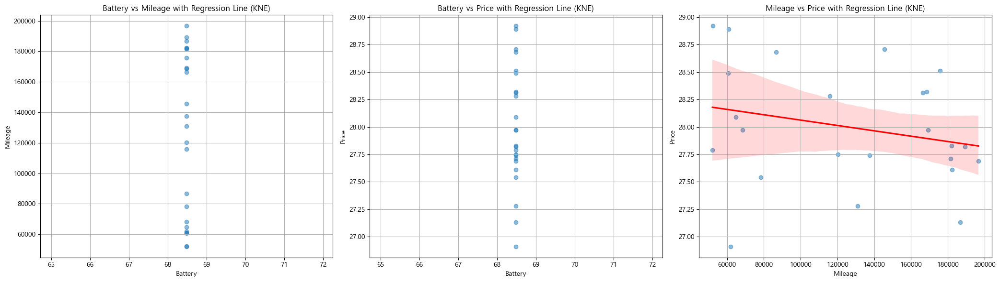

In [ ]:
# ----------------------------------------------------------------------------------------------------
# KNE 모델 

model_name = "KNE"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 4) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

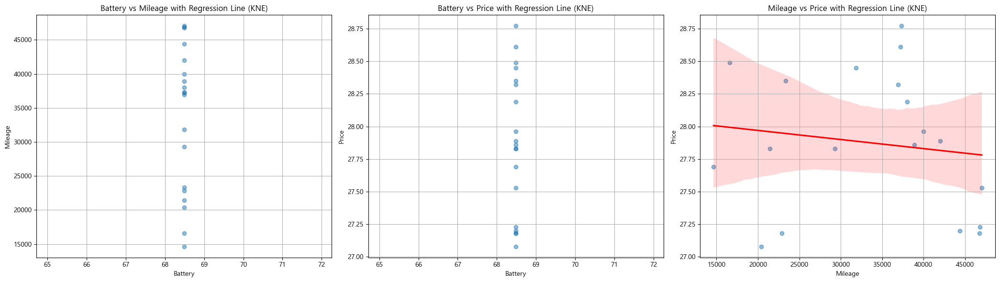

In [ ]:
# ----------------------------------------------------------------------------------------------------
# KNE 모델 

model_name = "KNE"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 5) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

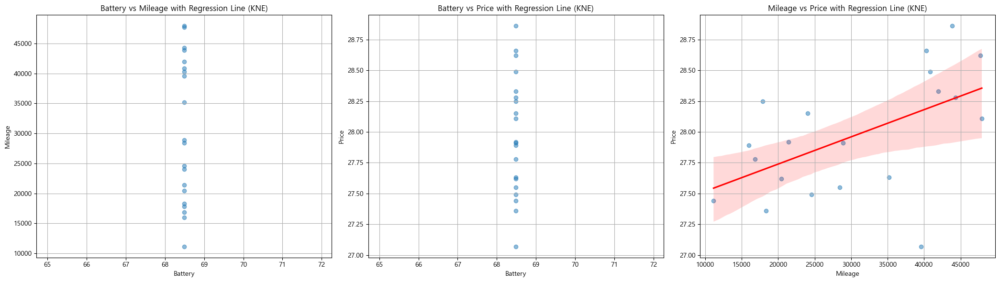

In [ ]:
# ----------------------------------------------------------------------------------------------------
# KNE 모델 

model_name = "KNE"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 6) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

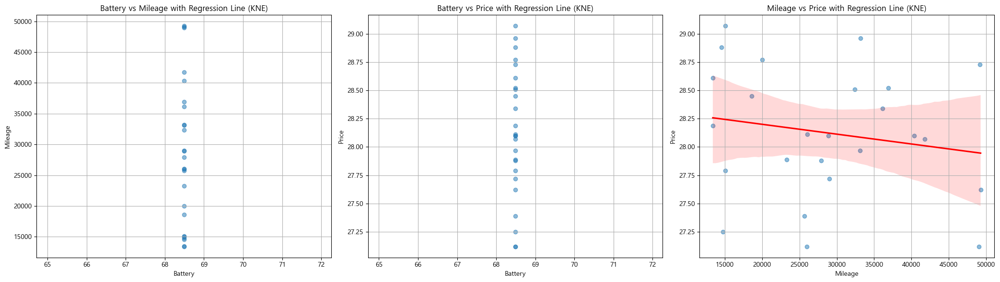

In [ ]:
# ----------------------------------------------------------------------------------------------------
# KNE 모델 

model_name = "KNE"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 7) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

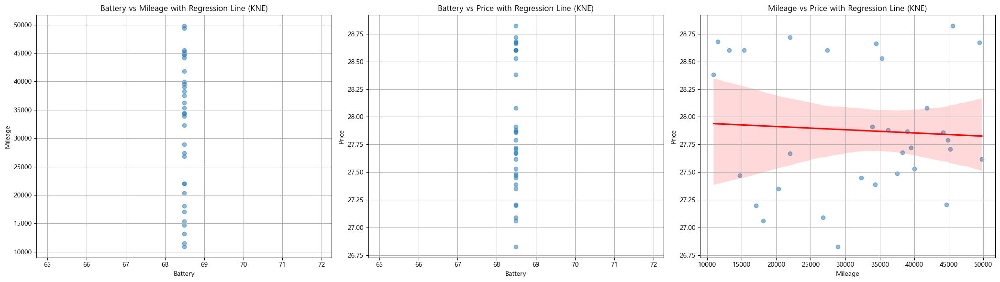

In [ ]:
# ----------------------------------------------------------------------------------------------------
# KNE 모델 

model_name = "KNE"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 8) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

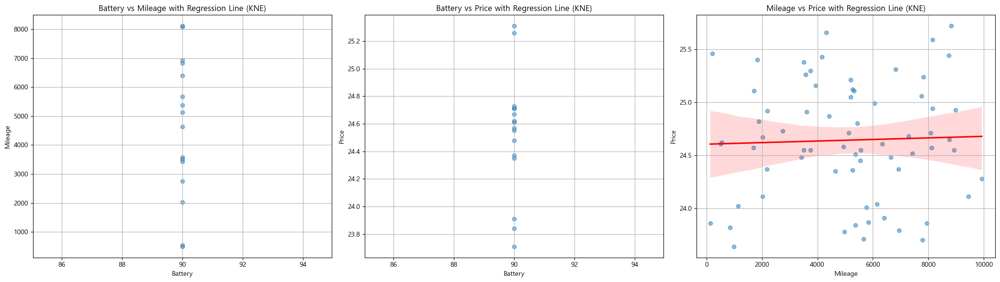

In [ ]:
# ----------------------------------------------------------------------------------------------------
# KNE 모델 

model_name = "KNE"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 9) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

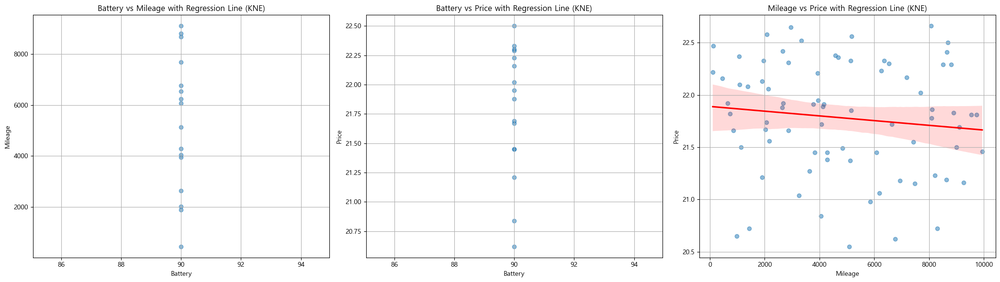

In [ ]:
# ----------------------------------------------------------------------------------------------------
# KNE 모델 

model_name = "KNE"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 10) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

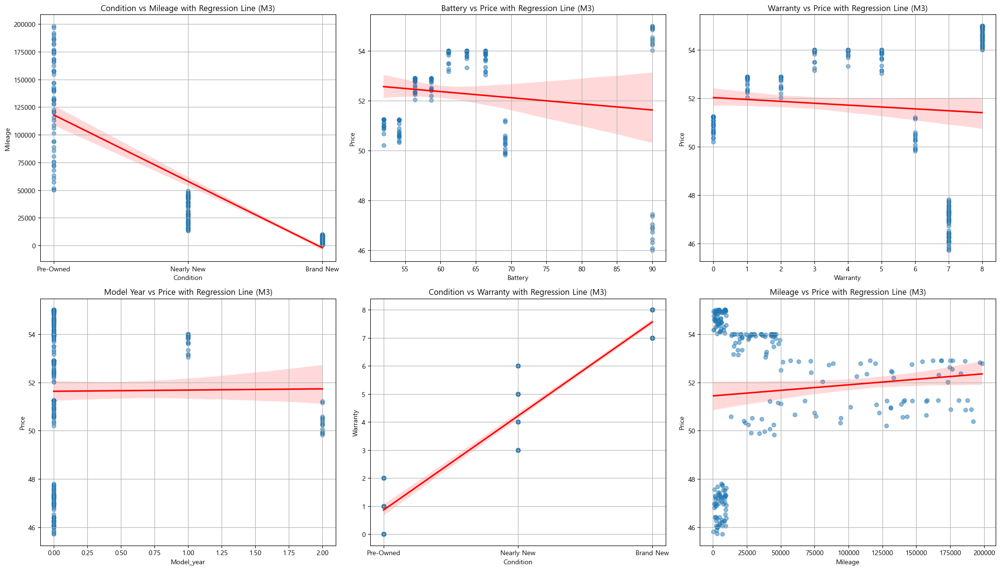

In [24]:
# ----------------------------------------------------------------------------------------------------
# M3 모델 

model_name = "M3"

result = learning.loc[(learning["Model"] == model_name), :]

result.loc[result["Condition"] == "Brand New","Condition"] = 2.0
result.loc[result["Condition"] == "Nearly New","Condition"] = 1.0
result.loc[result["Condition"] == "Pre-Owned","Condition"] = 0.0

result["Condition"] = result["Condition"].astype("float64")

# Figure 생성
plt.figure(figsize=(21, 12))

# 1행 3열 그래프
plt.subplot(2, 3, 1)  # (2행 3열) 중 1번째
sns.regplot(data=result, x="Condition", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Mileage")
plt.title(f"Condition vs Mileage with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 2)  # (2행 3열) 중 2번째
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 3)  # (2행 3열) 중 3번째
sns.regplot(data=result, x="Warranty", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Warranty")
plt.ylabel("Price")
plt.title(f"Warranty vs Price with Regression Line ({model_name})")
plt.grid(True)

# 2행 3열 그래프
plt.subplot(2, 3, 4)  # (2행 3열) 중 4번째
sns.regplot(data=result, x="Model_year", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Model_year")
plt.ylabel("Price")
plt.title(f"Model Year vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 5)  # (2행 3열) 중 5번째
sns.regplot(data=result, x="Condition", y="Warranty", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Warranty")
plt.title(f"Condition vs Warranty with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 6)  # (2행 3열) 중 6번째
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()  # 그래프 간 간격 자동 조정
plt.show()
# ----------------------------------------------------------------------------------------------------

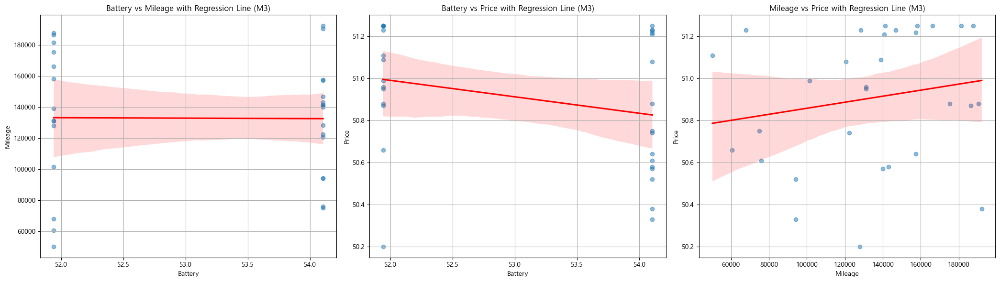

In [ ]:
# ----------------------------------------------------------------------------------------------------
# M3 모델 

model_name = "M3"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 0) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

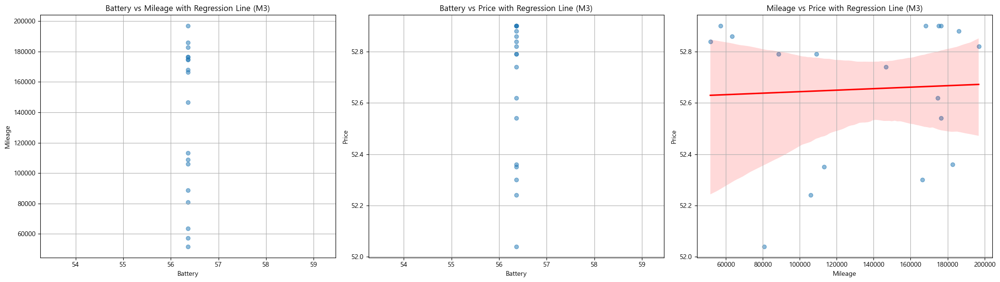

In [ ]:
# ----------------------------------------------------------------------------------------------------
# M3 모델 

model_name = "M3"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 1) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

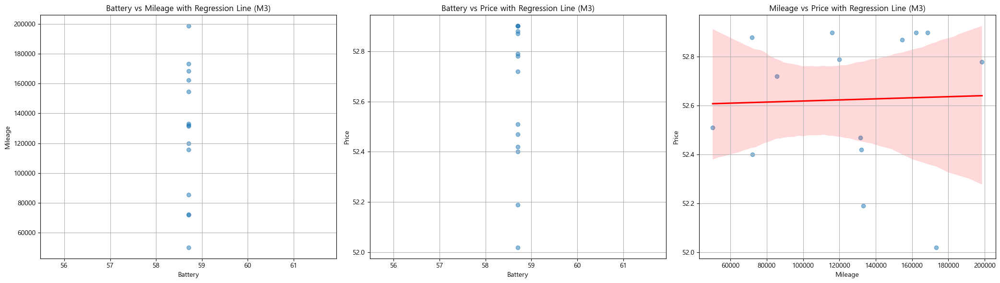

In [ ]:
# ----------------------------------------------------------------------------------------------------
# M3 모델 

model_name = "M3"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 2) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

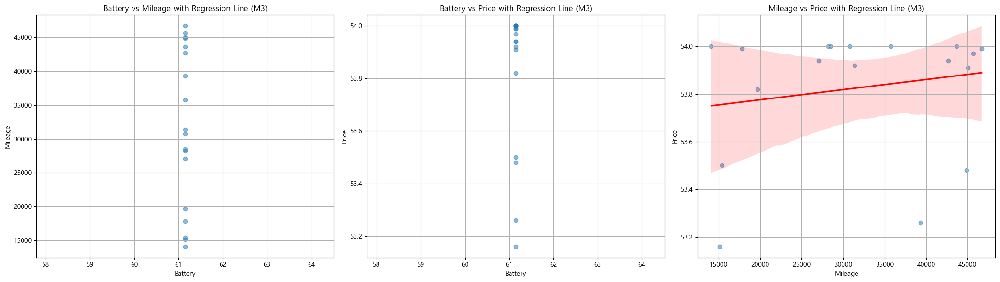

In [ ]:
# ----------------------------------------------------------------------------------------------------
# M3 모델 

model_name = "M3"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 3) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

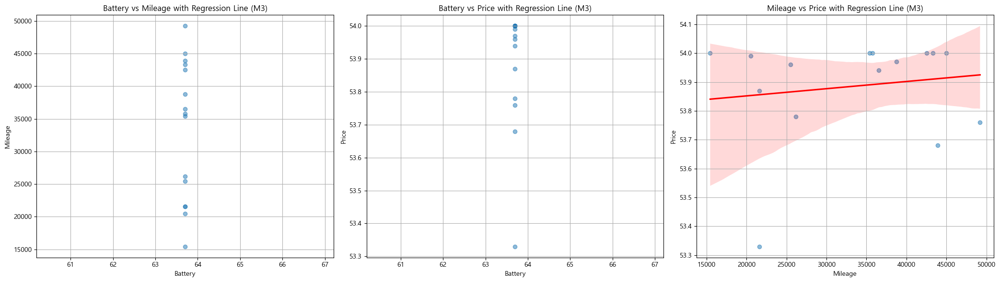

In [ ]:
# ----------------------------------------------------------------------------------------------------
# M3 모델 

model_name = "M3"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 4) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

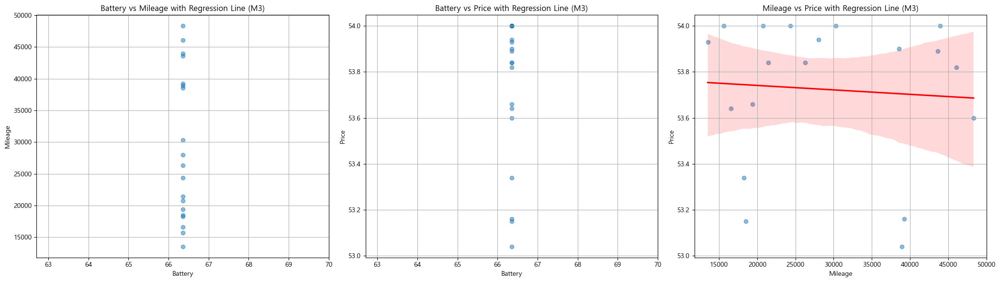

In [ ]:
# ----------------------------------------------------------------------------------------------------
# M3 모델 

model_name = "M3"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 5) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

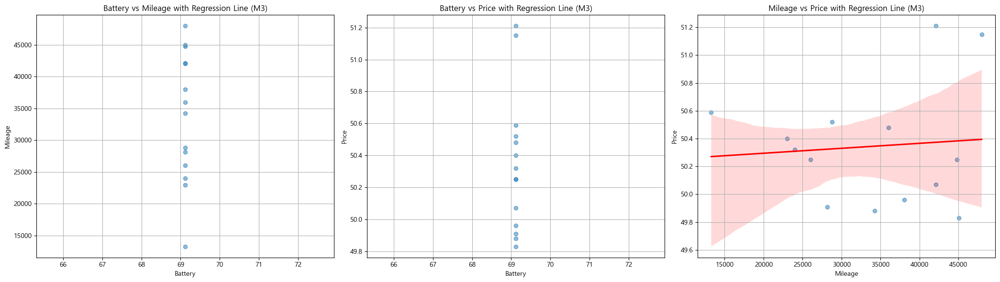

In [ ]:
# ----------------------------------------------------------------------------------------------------
# M3 모델 

model_name = "M3"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 6) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

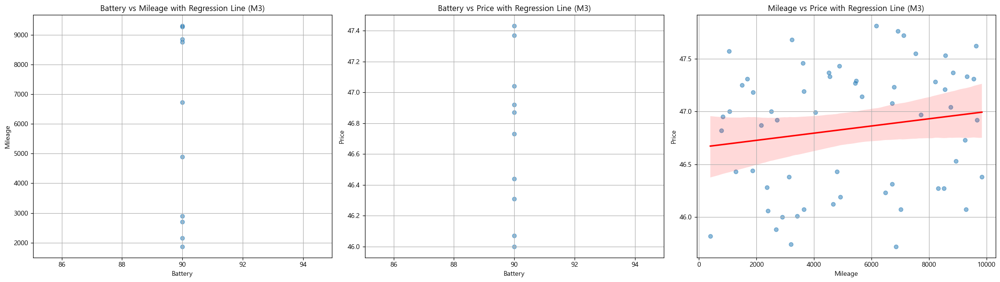

In [ ]:
# ----------------------------------------------------------------------------------------------------
# M3 모델 

model_name = "M3"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 7) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

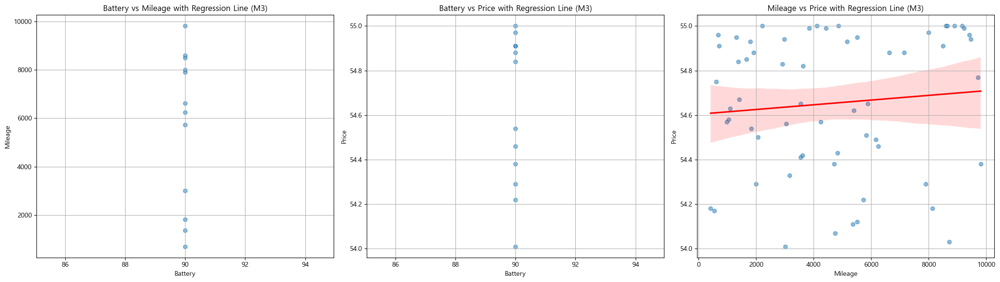

In [ ]:
# ----------------------------------------------------------------------------------------------------
# M3 모델 

model_name = "M3"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 8) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

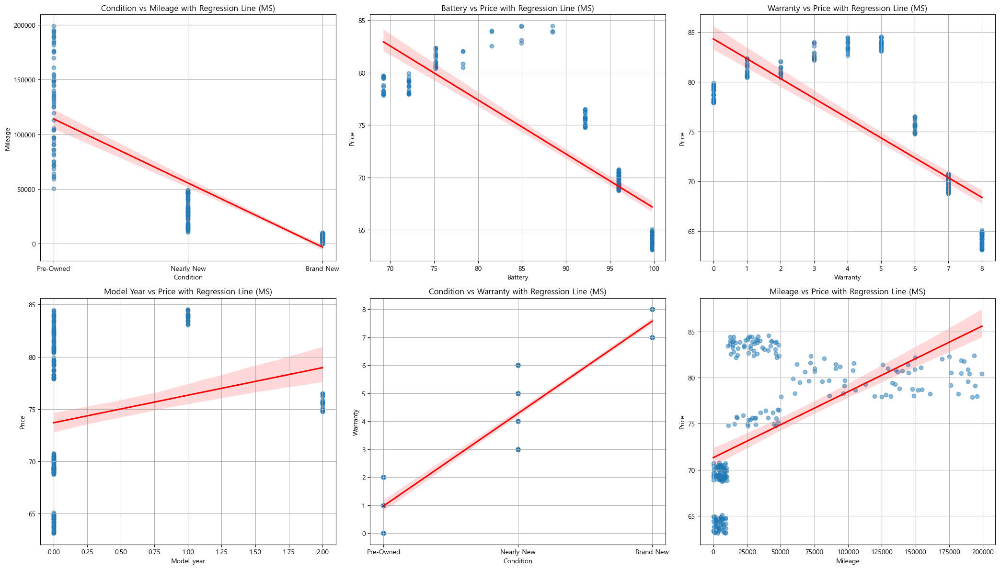

In [25]:
# ----------------------------------------------------------------------------------------------------
# MS 모델 

model_name = "MS"

result = learning.loc[(learning["Model"] == model_name), :]

result.loc[result["Condition"] == "Brand New","Condition"] = 2.0
result.loc[result["Condition"] == "Nearly New","Condition"] = 1.0
result.loc[result["Condition"] == "Pre-Owned","Condition"] = 0.0

result["Condition"] = result["Condition"].astype("float64")

# Figure 생성
plt.figure(figsize=(21, 12))

# 1행 3열 그래프
plt.subplot(2, 3, 1)  # (2행 3열) 중 1번째
sns.regplot(data=result, x="Condition", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Mileage")
plt.title(f"Condition vs Mileage with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 2)  # (2행 3열) 중 2번째
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 3)  # (2행 3열) 중 3번째
sns.regplot(data=result, x="Warranty", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Warranty")
plt.ylabel("Price")
plt.title(f"Warranty vs Price with Regression Line ({model_name})")
plt.grid(True)

# 2행 3열 그래프
plt.subplot(2, 3, 4)  # (2행 3열) 중 4번째
sns.regplot(data=result, x="Model_year", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Model_year")
plt.ylabel("Price")
plt.title(f"Model Year vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 5)  # (2행 3열) 중 5번째
sns.regplot(data=result, x="Condition", y="Warranty", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Warranty")
plt.title(f"Condition vs Warranty with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 6)  # (2행 3열) 중 6번째
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()  # 그래프 간 간격 자동 조정
plt.show()
# ----------------------------------------------------------------------------------------------------

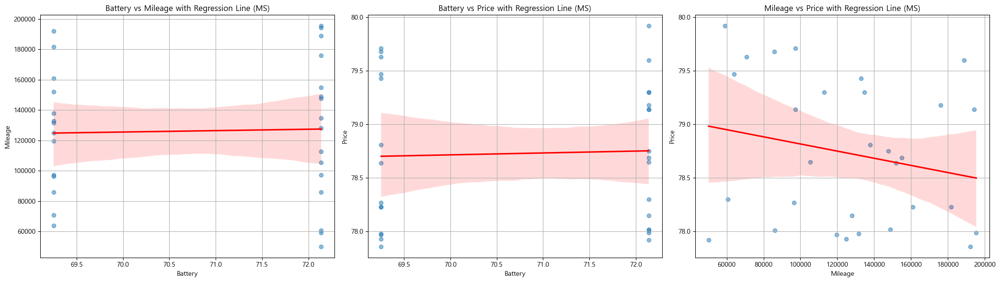

In [22]:
# ----------------------------------------------------------------------------------------------------
# MS 모델 

model_name = "MS"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 0) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

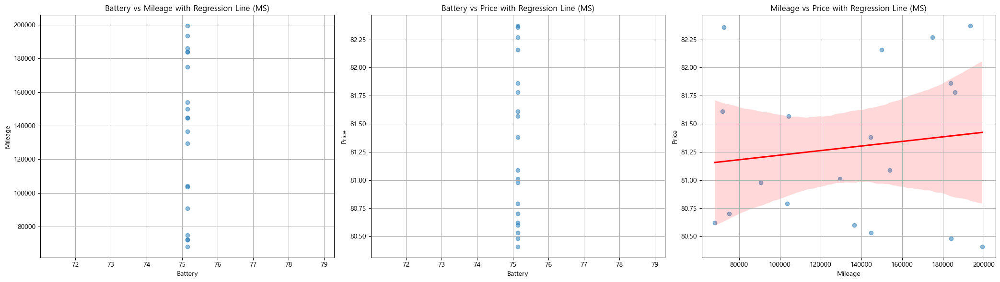

In [ ]:
# ----------------------------------------------------------------------------------------------------
# MS 모델 

model_name = "MS"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 1) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

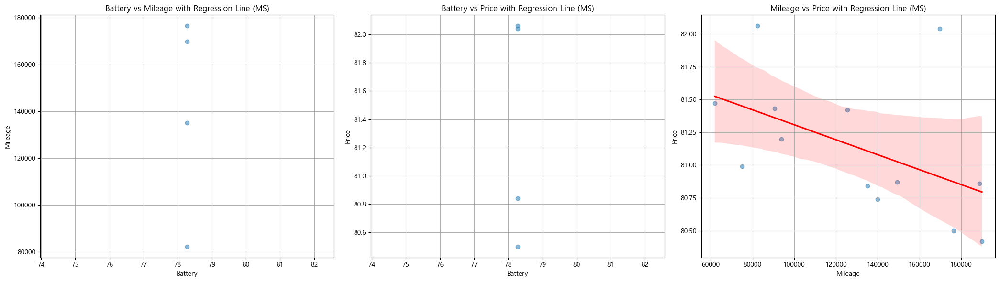

In [ ]:
# ----------------------------------------------------------------------------------------------------
# MS 모델 

model_name = "MS"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 2) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

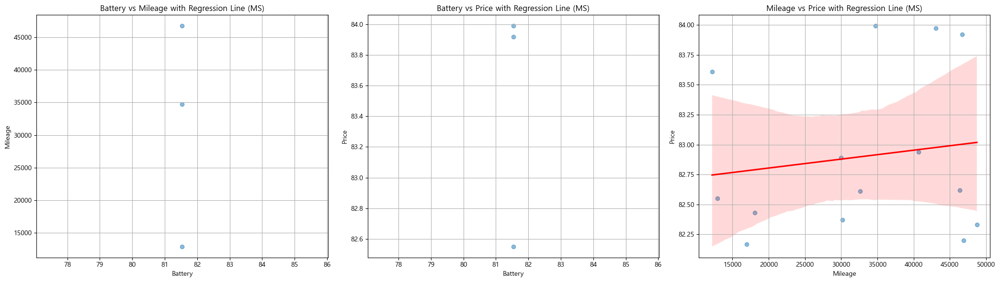

In [ ]:
# ----------------------------------------------------------------------------------------------------
# MS 모델 

model_name = "MS"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 3) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

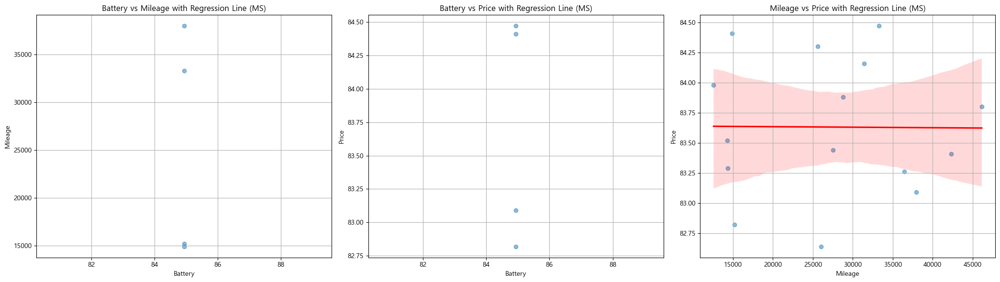

In [ ]:
# ----------------------------------------------------------------------------------------------------
# MS 모델 

model_name = "MS"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 4) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

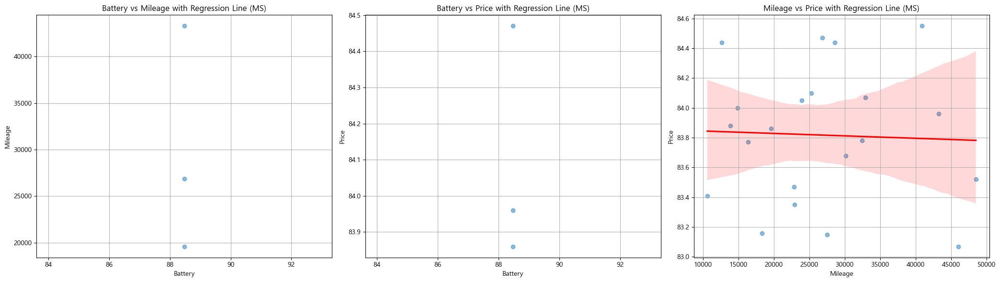

In [ ]:
# ----------------------------------------------------------------------------------------------------
# MS 모델 

model_name = "MS"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 5) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

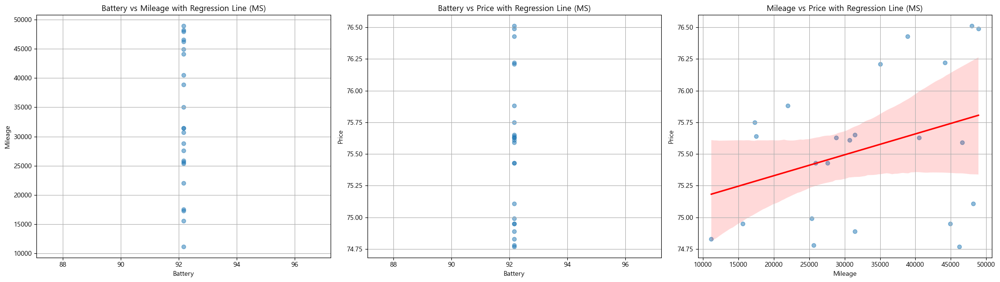

In [ ]:
# ----------------------------------------------------------------------------------------------------
# MS 모델 

model_name = "MS"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 6) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

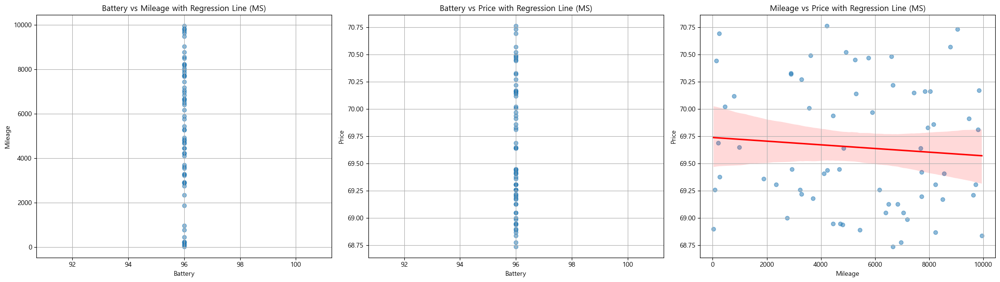

In [ ]:
# ----------------------------------------------------------------------------------------------------
# MS 모델 

model_name = "MS"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 7) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

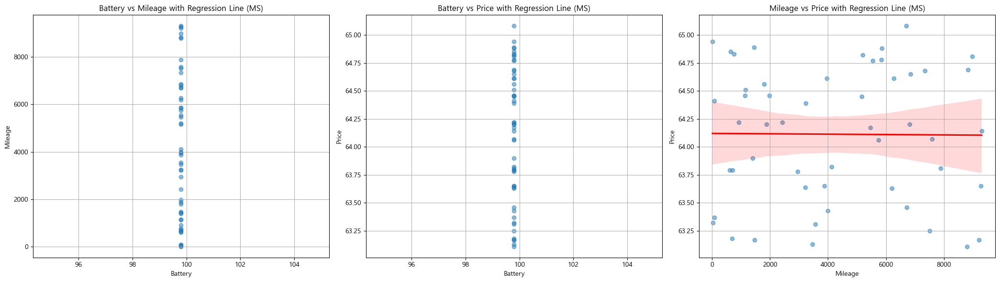

In [ ]:
# ----------------------------------------------------------------------------------------------------
# MS 모델 

model_name = "MS"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 8) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

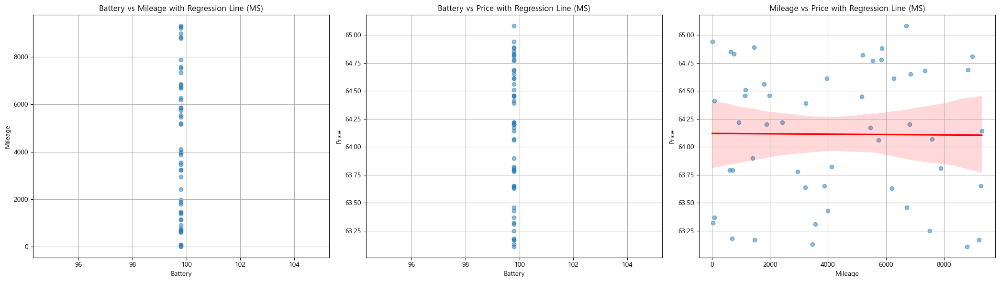

In [ ]:
# ----------------------------------------------------------------------------------------------------
# MS 모델 

model_name = "MS"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 8) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

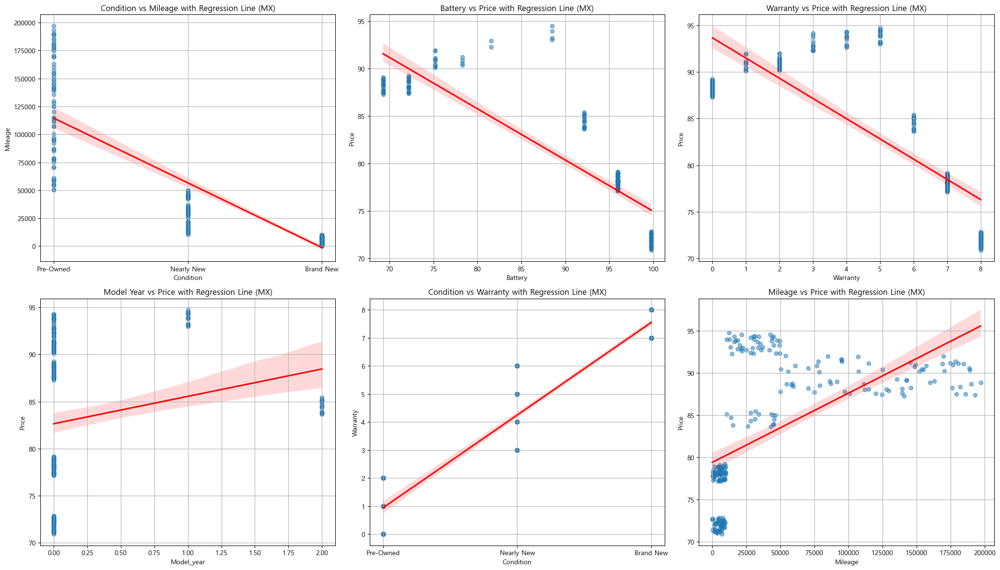

In [26]:
# ----------------------------------------------------------------------------------------------------
# MX 모델 

model_name = "MX"

result = learning.loc[(learning["Model"] == model_name), :]

result.loc[result["Condition"] == "Brand New","Condition"] = 2.0
result.loc[result["Condition"] == "Nearly New","Condition"] = 1.0
result.loc[result["Condition"] == "Pre-Owned","Condition"] = 0.0

result["Condition"] = result["Condition"].astype("float64")

# Figure 생성
plt.figure(figsize=(21, 12))

# 1행 3열 그래프
plt.subplot(2, 3, 1)  # (2행 3열) 중 1번째
sns.regplot(data=result, x="Condition", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Mileage")
plt.title(f"Condition vs Mileage with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 2)  # (2행 3열) 중 2번째
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 3)  # (2행 3열) 중 3번째
sns.regplot(data=result, x="Warranty", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Warranty")
plt.ylabel("Price")
plt.title(f"Warranty vs Price with Regression Line ({model_name})")
plt.grid(True)

# 2행 3열 그래프
plt.subplot(2, 3, 4)  # (2행 3열) 중 4번째
sns.regplot(data=result, x="Model_year", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Model_year")
plt.ylabel("Price")
plt.title(f"Model Year vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 5)  # (2행 3열) 중 5번째
sns.regplot(data=result, x="Condition", y="Warranty", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Warranty")
plt.title(f"Condition vs Warranty with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 6)  # (2행 3열) 중 6번째
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()  # 그래프 간 간격 자동 조정
plt.show()
# ----------------------------------------------------------------------------------------------------

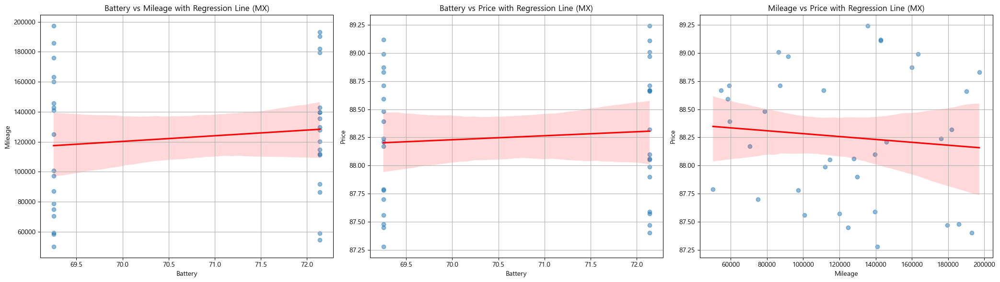

In [ ]:
# ----------------------------------------------------------------------------------------------------
# MX 모델 

model_name = "MX"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 0) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

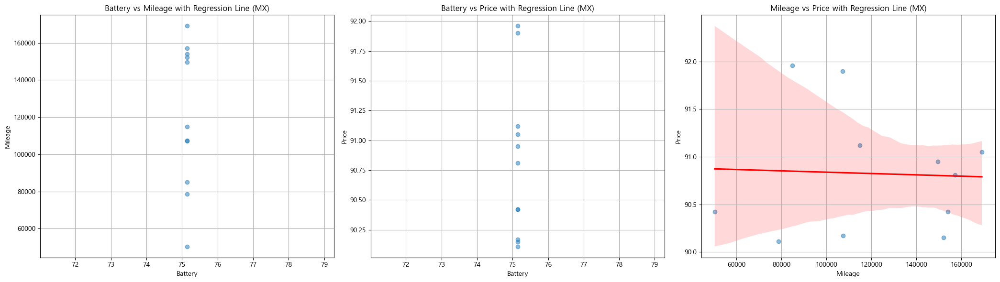

In [ ]:
# ----------------------------------------------------------------------------------------------------
# MX 모델 

model_name = "MX"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 1) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

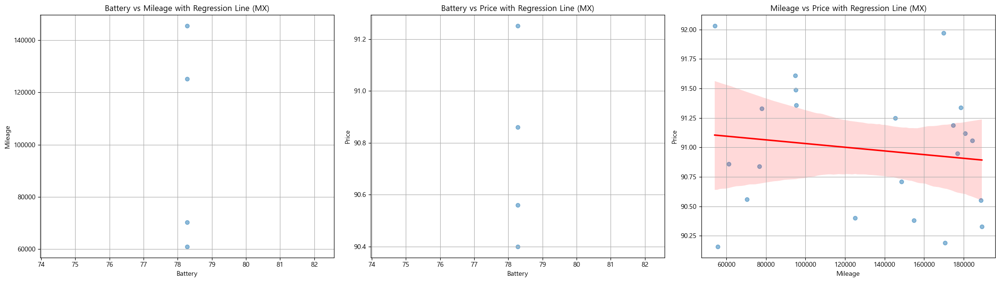

In [ ]:
# ----------------------------------------------------------------------------------------------------
# MX 모델 

model_name = "MX"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 2) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

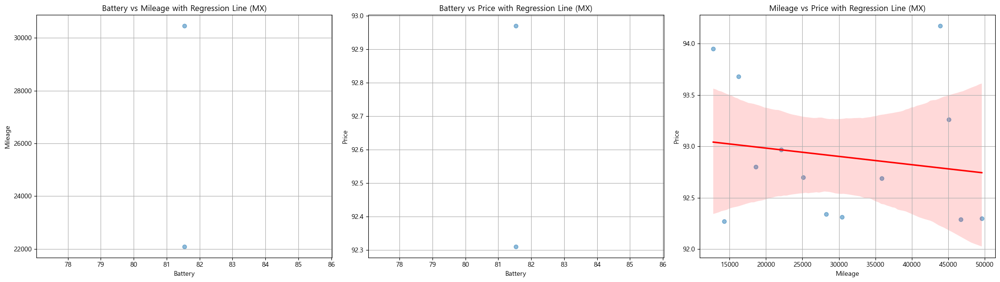

In [ ]:
# ----------------------------------------------------------------------------------------------------
# MX 모델 

model_name = "MX"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 3) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

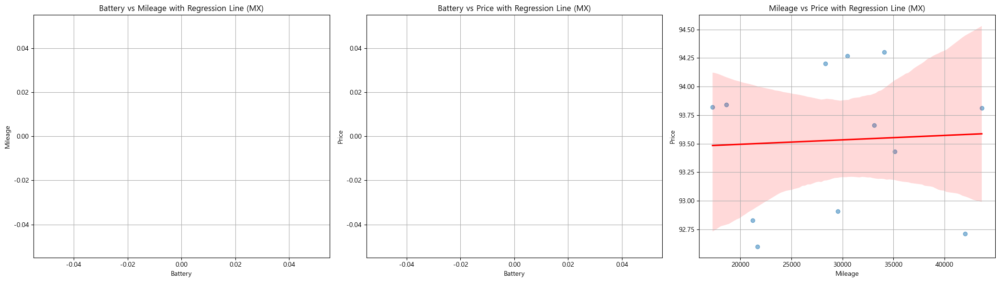

In [ ]:
# ----------------------------------------------------------------------------------------------------
# MX 모델 

model_name = "MX"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 4) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

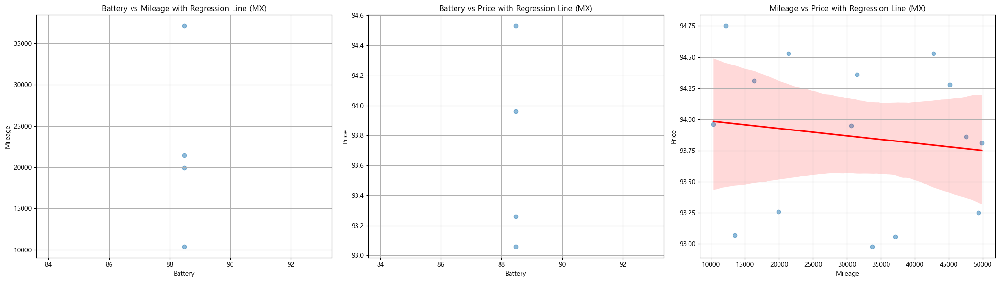

In [ ]:
# ----------------------------------------------------------------------------------------------------
# MX 모델 

model_name = "MX"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 5) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

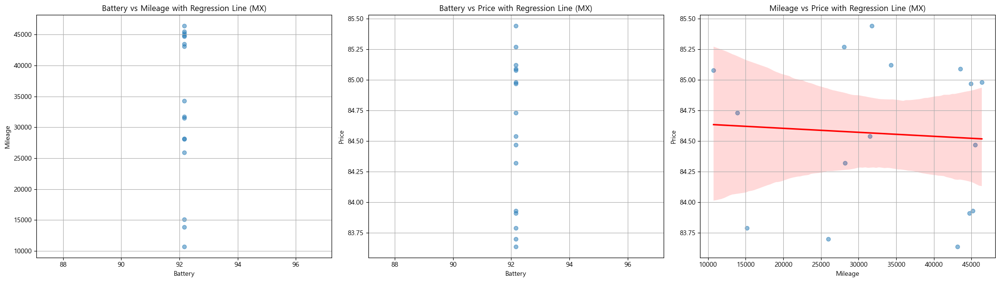

In [ ]:
# ----------------------------------------------------------------------------------------------------
# MX 모델 

model_name = "MX"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 6) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

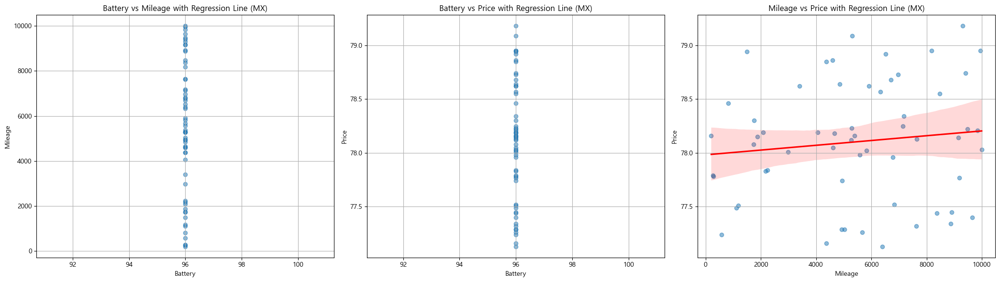

In [ ]:
# ----------------------------------------------------------------------------------------------------
# MX 모델 

model_name = "MX"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 7) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

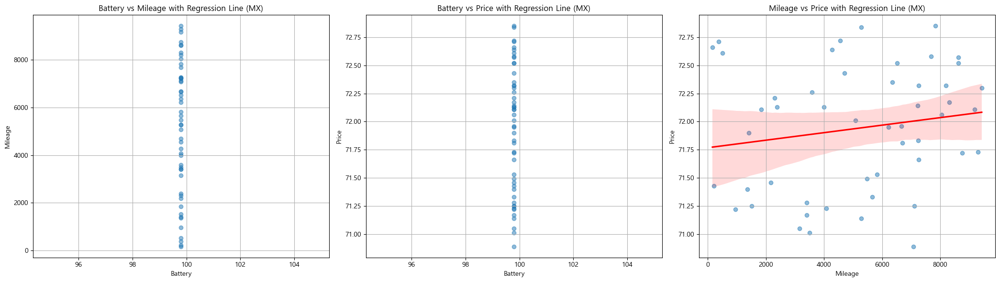

In [ ]:
# ----------------------------------------------------------------------------------------------------
# MX 모델 

model_name = "MX"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 8) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

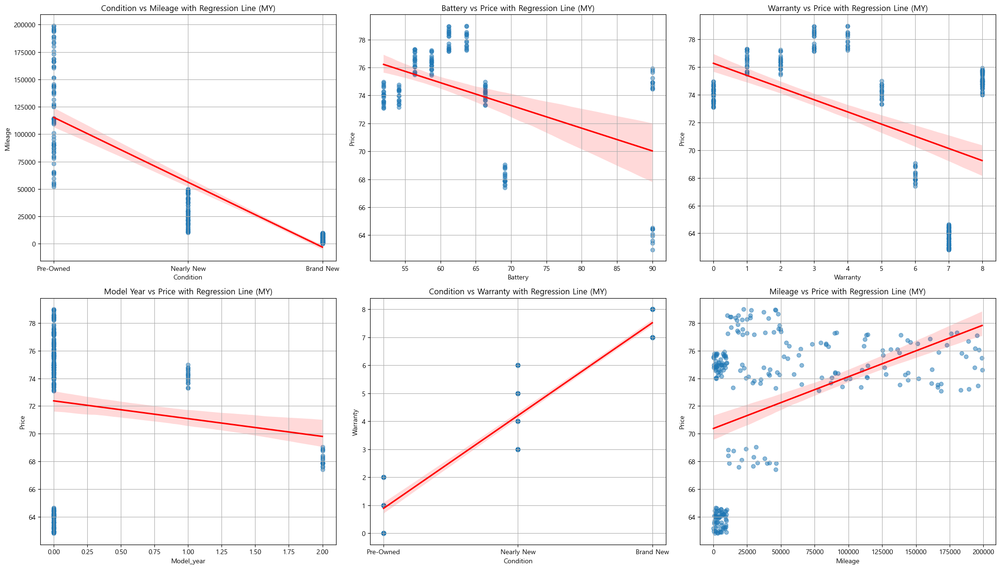

In [27]:
# ----------------------------------------------------------------------------------------------------
# MY 모델 

model_name = "MY"

result = learning.loc[(learning["Model"] == model_name), :]

result.loc[result["Condition"] == "Brand New","Condition"] = 2.0
result.loc[result["Condition"] == "Nearly New","Condition"] = 1.0
result.loc[result["Condition"] == "Pre-Owned","Condition"] = 0.0

result["Condition"] = result["Condition"].astype("float64")

# Figure 생성
plt.figure(figsize=(21, 12))

# 1행 3열 그래프
plt.subplot(2, 3, 1)  # (2행 3열) 중 1번째
sns.regplot(data=result, x="Condition", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Mileage")
plt.title(f"Condition vs Mileage with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 2)  # (2행 3열) 중 2번째
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 3)  # (2행 3열) 중 3번째
sns.regplot(data=result, x="Warranty", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Warranty")
plt.ylabel("Price")
plt.title(f"Warranty vs Price with Regression Line ({model_name})")
plt.grid(True)

# 2행 3열 그래프
plt.subplot(2, 3, 4)  # (2행 3열) 중 4번째
sns.regplot(data=result, x="Model_year", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Model_year")
plt.ylabel("Price")
plt.title(f"Model Year vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 5)  # (2행 3열) 중 5번째
sns.regplot(data=result, x="Condition", y="Warranty", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Warranty")
plt.title(f"Condition vs Warranty with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 6)  # (2행 3열) 중 6번째
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()  # 그래프 간 간격 자동 조정
plt.show()
# ----------------------------------------------------------------------------------------------------

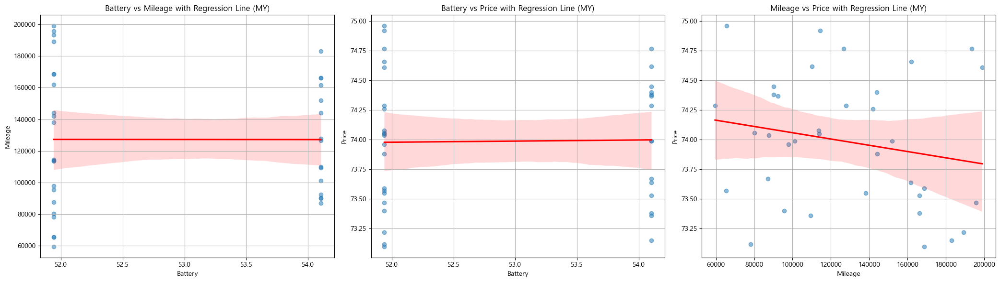

In [ ]:
# ----------------------------------------------------------------------------------------------------
# MY 모델 

model_name = "MY"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 0) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

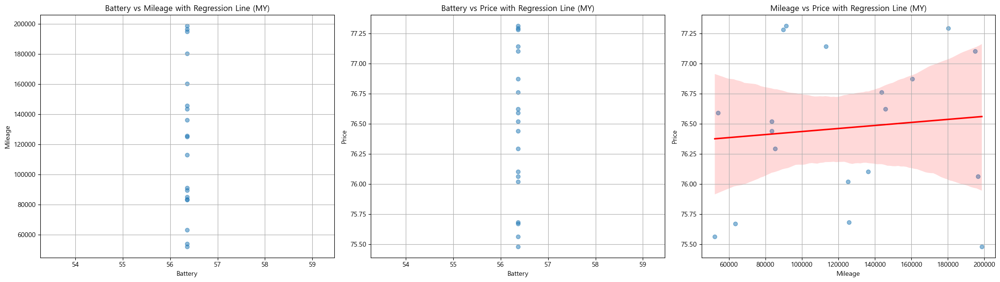

In [ ]:
# ----------------------------------------------------------------------------------------------------
# MY 모델 

model_name = "MY"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 1) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

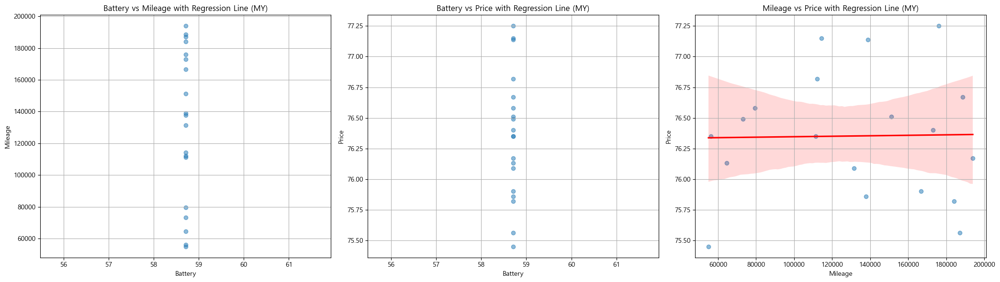

In [ ]:
# ----------------------------------------------------------------------------------------------------
# MY 모델 

model_name = "MY"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 2) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

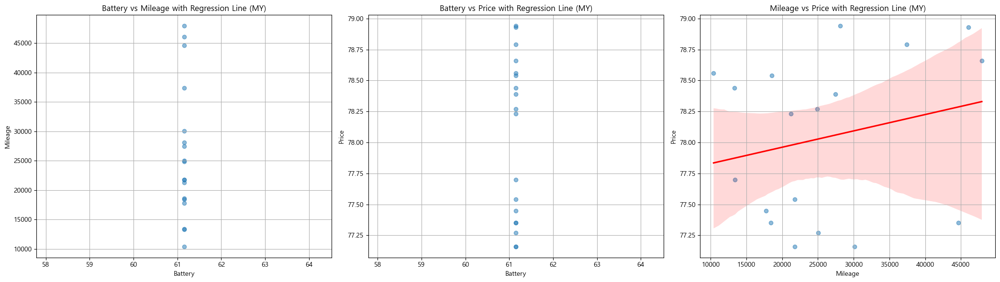

In [ ]:
# ----------------------------------------------------------------------------------------------------
# MY 모델 

model_name = "MY"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 3) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

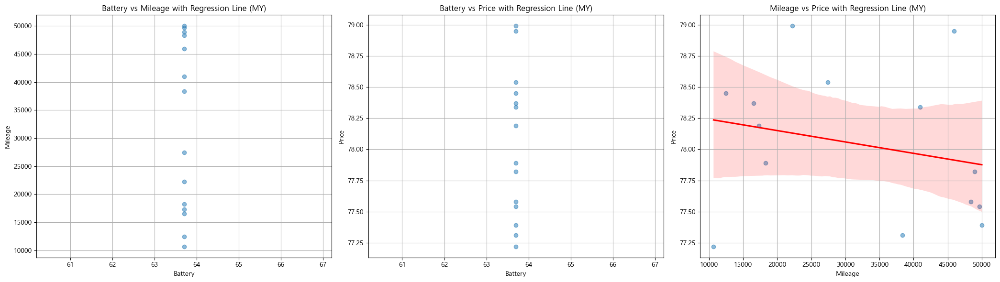

In [ ]:
# ----------------------------------------------------------------------------------------------------
# MY 모델 

model_name = "MY"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 4) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

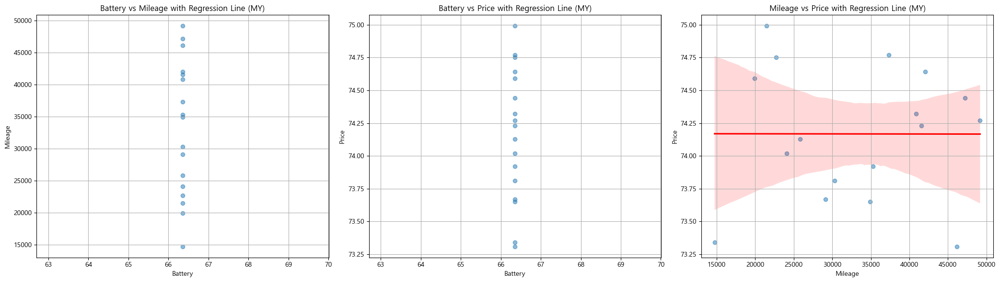

In [ ]:
# ----------------------------------------------------------------------------------------------------
# MY 모델 

model_name = "MY"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 5) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

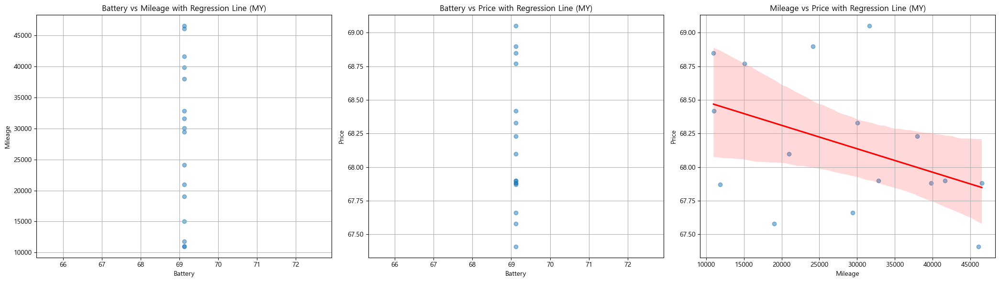

In [ ]:
# ----------------------------------------------------------------------------------------------------
# MY 모델 

model_name = "MY"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 6) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

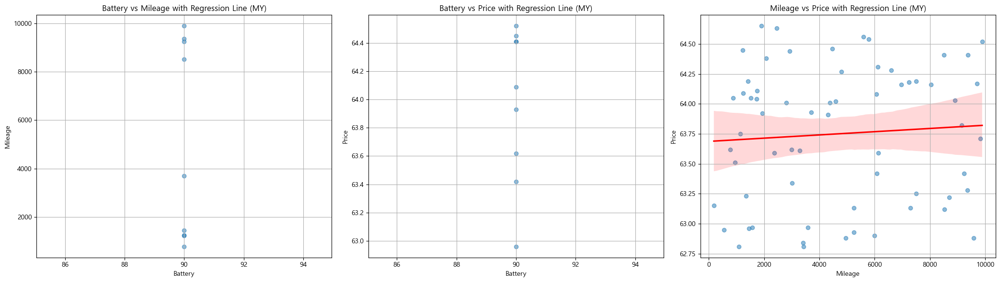

In [ ]:
# ----------------------------------------------------------------------------------------------------
# MY 모델 

model_name = "MY"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 7) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

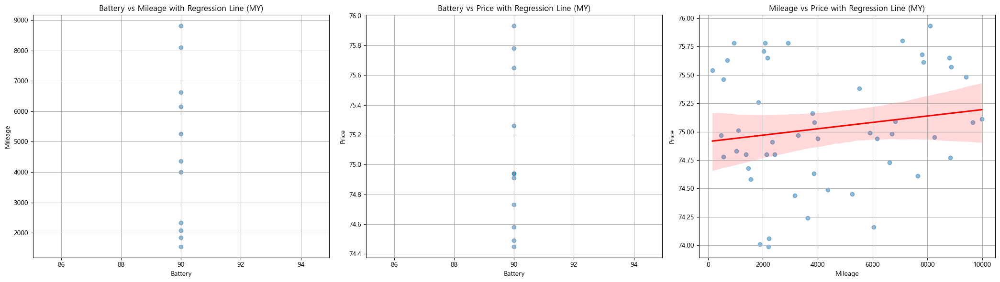

In [ ]:
# ----------------------------------------------------------------------------------------------------
# MY 모델 

model_name = "MY"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 8) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

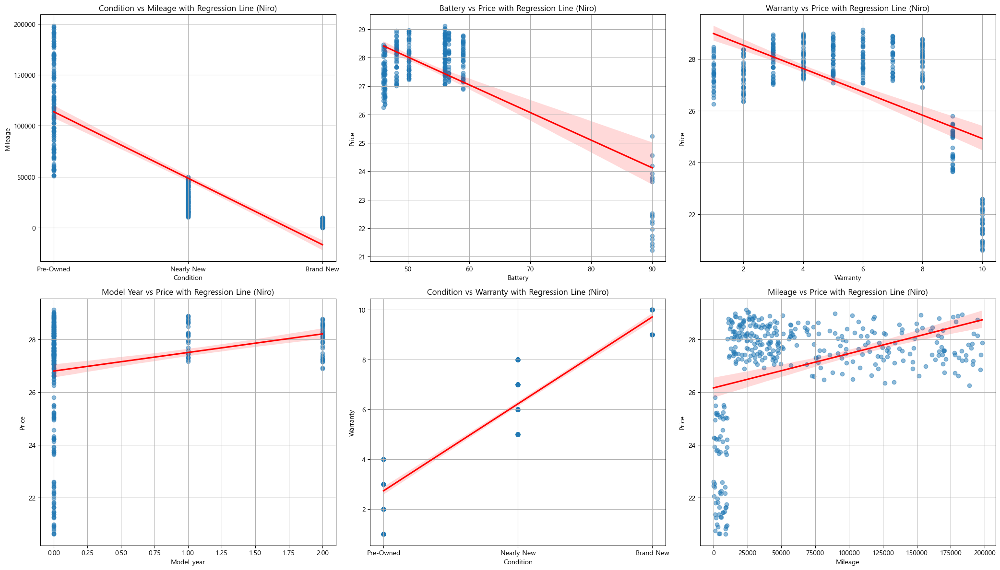

In [28]:
# ----------------------------------------------------------------------------------------------------
# Niro 모델 

model_name = "Niro"

result = learning.loc[(learning["Model"] == model_name), :]

result.loc[result["Condition"] == "Brand New","Condition"] = 2.0
result.loc[result["Condition"] == "Nearly New","Condition"] = 1.0
result.loc[result["Condition"] == "Pre-Owned","Condition"] = 0.0

result["Condition"] = result["Condition"].astype("float64")

# Figure 생성
plt.figure(figsize=(21, 12))

# 1행 3열 그래프
plt.subplot(2, 3, 1)  # (2행 3열) 중 1번째
sns.regplot(data=result, x="Condition", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Mileage")
plt.title(f"Condition vs Mileage with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 2)  # (2행 3열) 중 2번째
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 3)  # (2행 3열) 중 3번째
sns.regplot(data=result, x="Warranty", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Warranty")
plt.ylabel("Price")
plt.title(f"Warranty vs Price with Regression Line ({model_name})")
plt.grid(True)

# 2행 3열 그래프
plt.subplot(2, 3, 4)  # (2행 3열) 중 4번째
sns.regplot(data=result, x="Model_year", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Model_year")
plt.ylabel("Price")
plt.title(f"Model Year vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 5)  # (2행 3열) 중 5번째
sns.regplot(data=result, x="Condition", y="Warranty", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Warranty")
plt.title(f"Condition vs Warranty with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 6)  # (2행 3열) 중 6번째
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()  # 그래프 간 간격 자동 조정
plt.show()
# ----------------------------------------------------------------------------------------------------

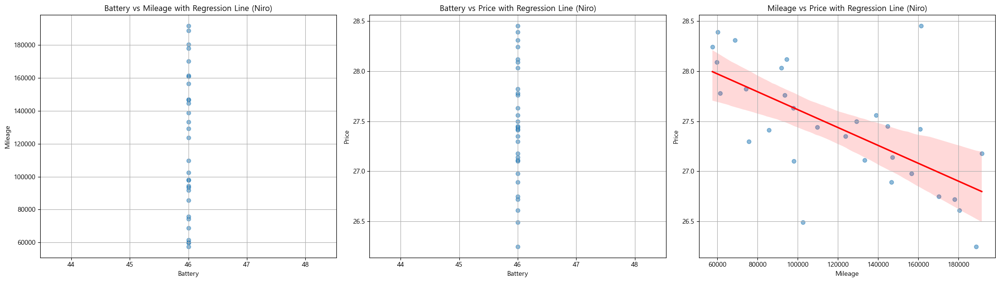

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Niro 모델 

model_name = "Niro"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 1) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

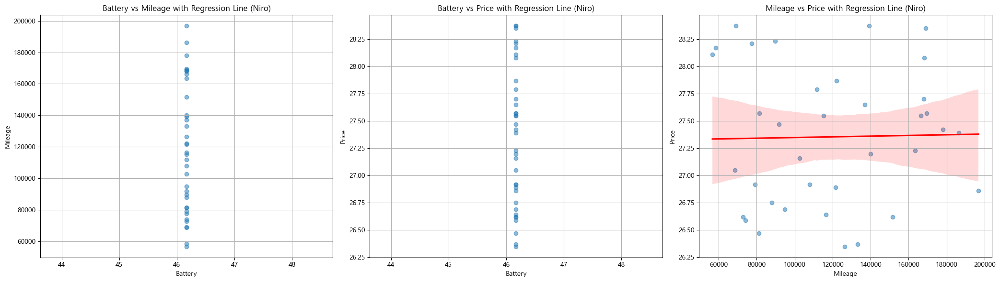

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Niro 모델 

model_name = "Niro"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 2) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

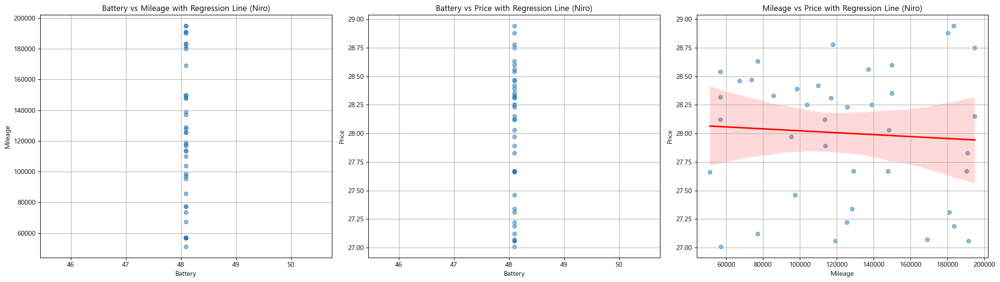

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Niro 모델 

model_name = "Niro"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 3) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

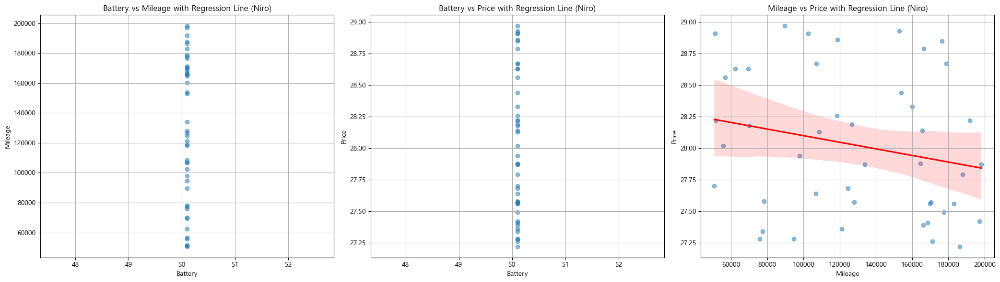

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Niro 모델 

model_name = "Niro"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 4) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

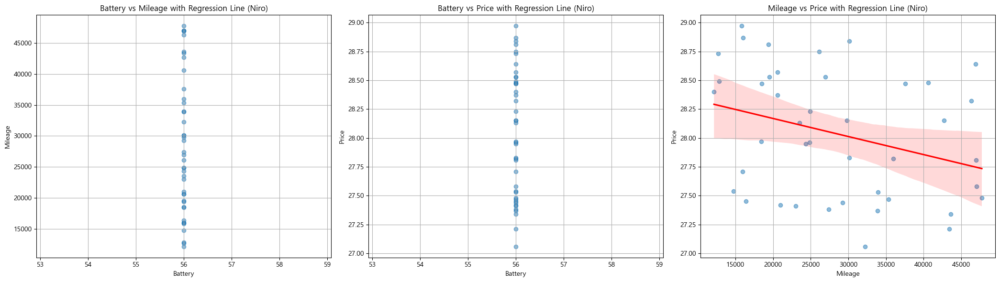

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Niro 모델 

model_name = "Niro"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 5) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

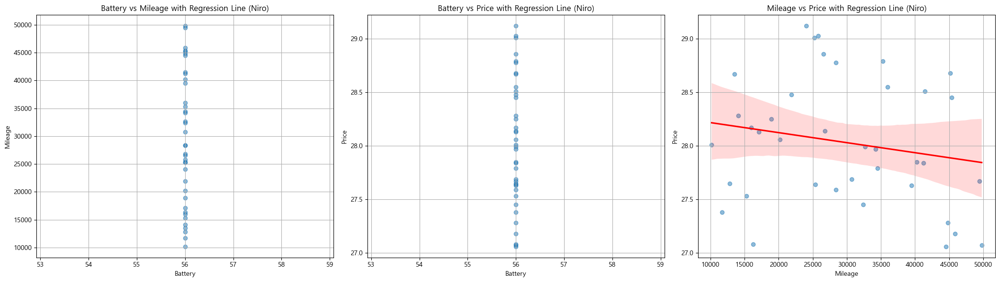

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Niro 모델 

model_name = "Niro"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 6) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

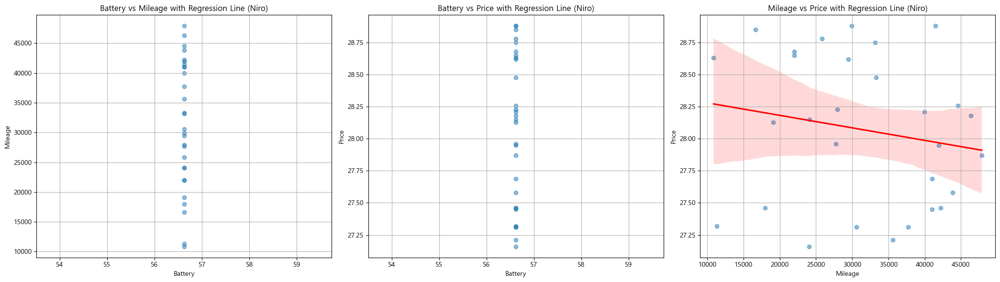

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Niro 모델 

model_name = "Niro"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 7) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

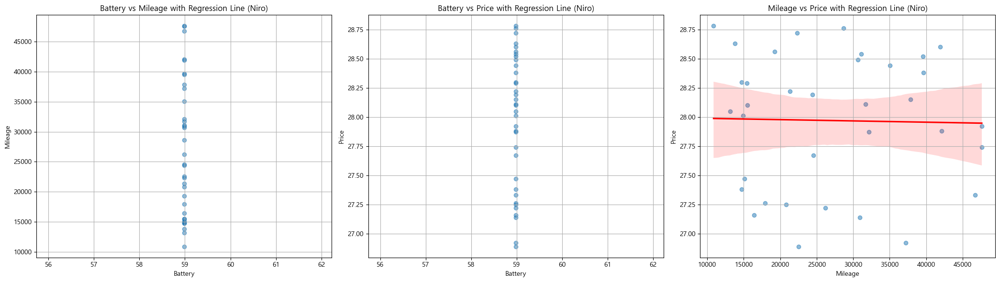

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Niro 모델 

model_name = "Niro"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 8) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

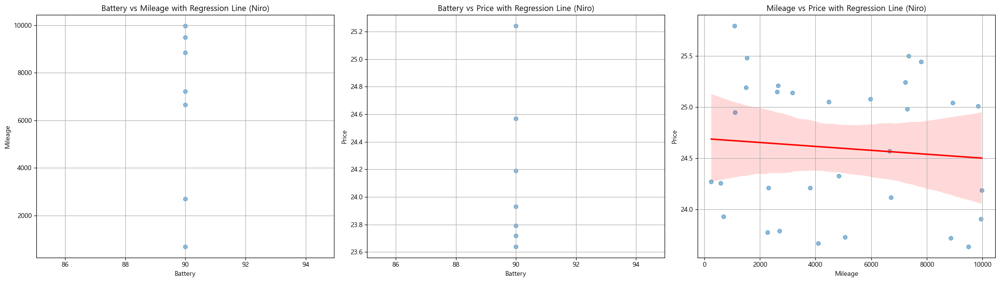

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Niro 모델 

model_name = "Niro"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 9) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

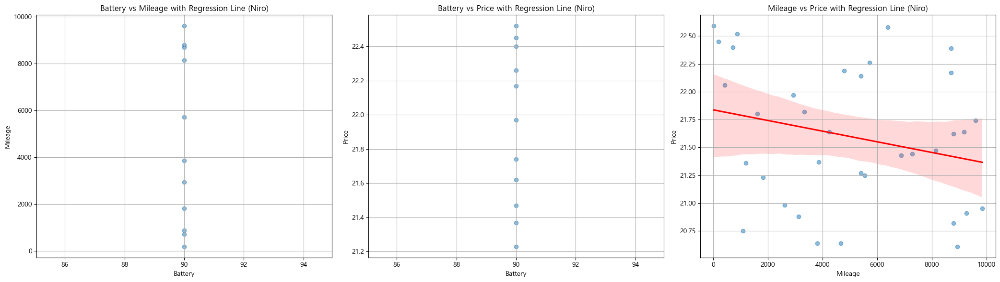

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Niro 모델 

model_name = "Niro"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 10) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

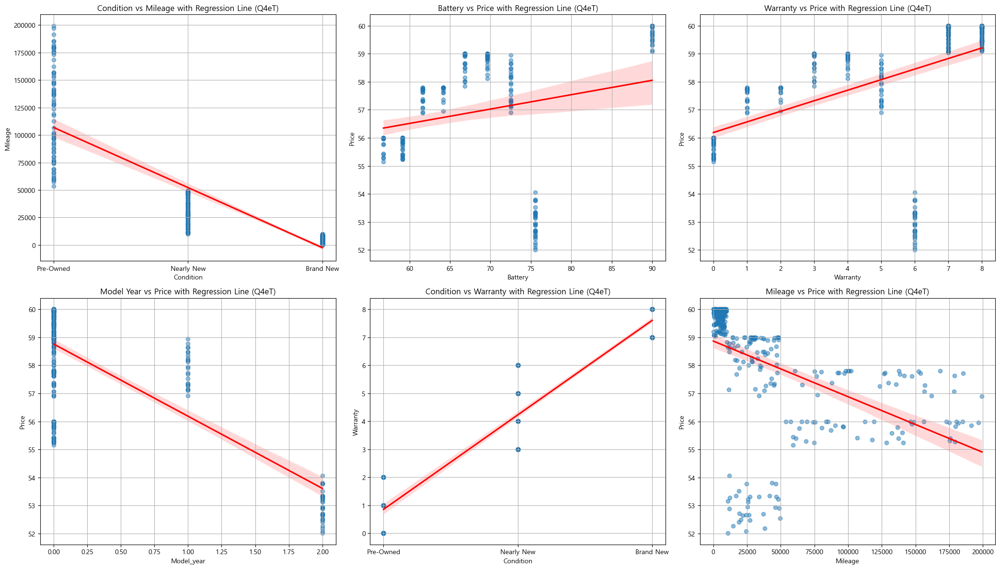

In [29]:
# ----------------------------------------------------------------------------------------------------
# Q4eT 모델 

model_name = "Q4eT"

result = learning.loc[(learning["Model"] == model_name), :]

result.loc[result["Condition"] == "Brand New","Condition"] = 2.0
result.loc[result["Condition"] == "Nearly New","Condition"] = 1.0
result.loc[result["Condition"] == "Pre-Owned","Condition"] = 0.0

result["Condition"] = result["Condition"].astype("float64")

# Figure 생성
plt.figure(figsize=(21, 12))

# 1행 3열 그래프
plt.subplot(2, 3, 1)  # (2행 3열) 중 1번째
sns.regplot(data=result, x="Condition", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Mileage")
plt.title(f"Condition vs Mileage with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 2)  # (2행 3열) 중 2번째
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 3)  # (2행 3열) 중 3번째
sns.regplot(data=result, x="Warranty", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Warranty")
plt.ylabel("Price")
plt.title(f"Warranty vs Price with Regression Line ({model_name})")
plt.grid(True)

# 2행 3열 그래프
plt.subplot(2, 3, 4)  # (2행 3열) 중 4번째
sns.regplot(data=result, x="Model_year", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Model_year")
plt.ylabel("Price")
plt.title(f"Model Year vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 5)  # (2행 3열) 중 5번째
sns.regplot(data=result, x="Condition", y="Warranty", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Warranty")
plt.title(f"Condition vs Warranty with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 6)  # (2행 3열) 중 6번째
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()  # 그래프 간 간격 자동 조정
plt.show()
# ----------------------------------------------------------------------------------------------------

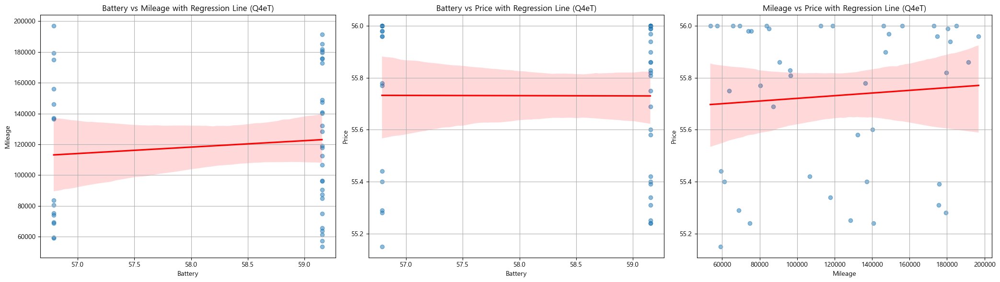

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Q4eT 모델 

model_name = "Q4eT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 0) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

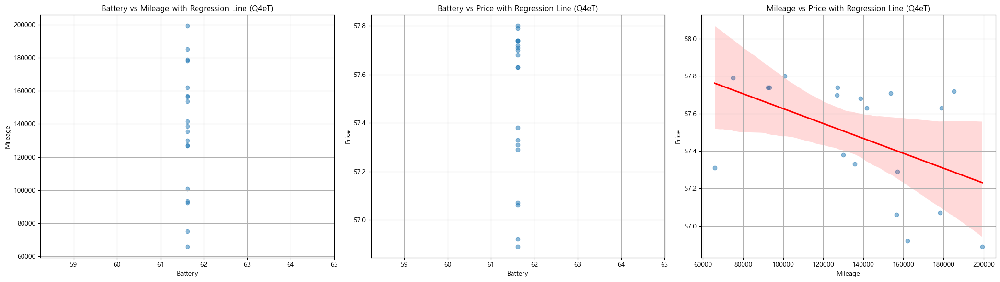

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Q4eT 모델 

model_name = "Q4eT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 1) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

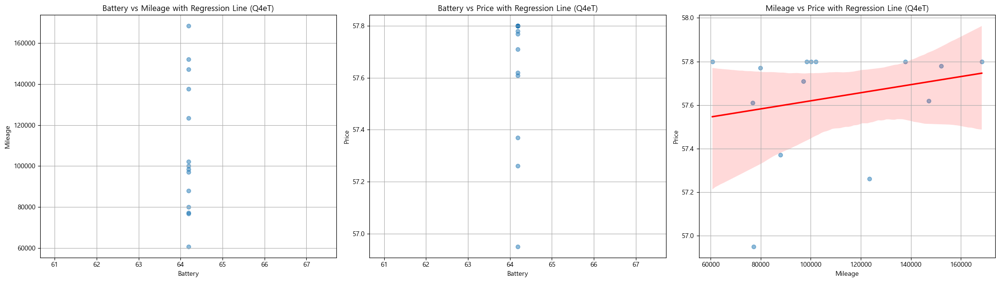

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Q4eT 모델 

model_name = "Q4eT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 2) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

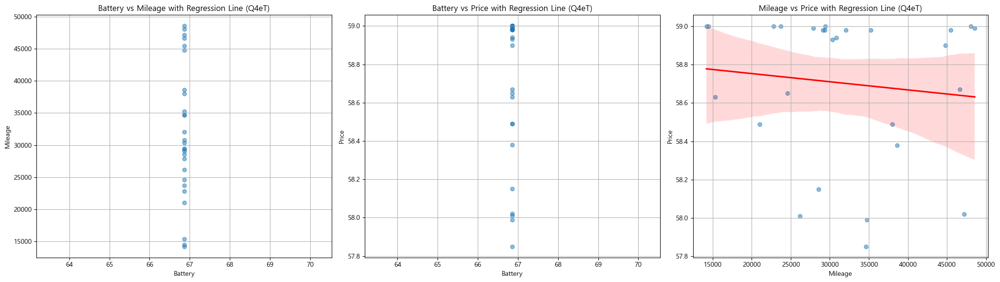

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Q4eT 모델 

model_name = "Q4eT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 3) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

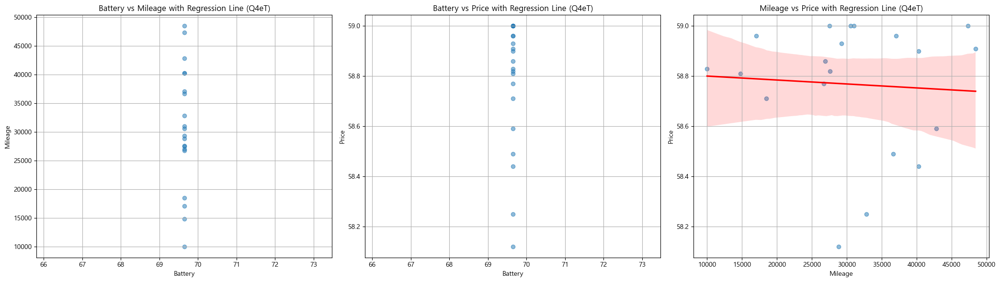

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Q4eT 모델 

model_name = "Q4eT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 4) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

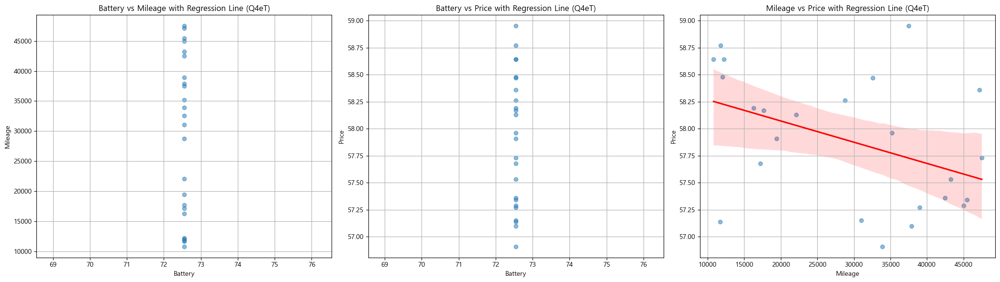

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Q4eT 모델 

model_name = "Q4eT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 5) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

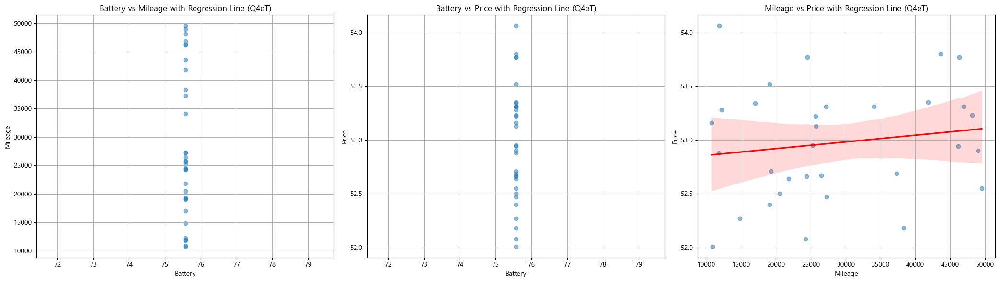

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Q4eT 모델 

model_name = "Q4eT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 6) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

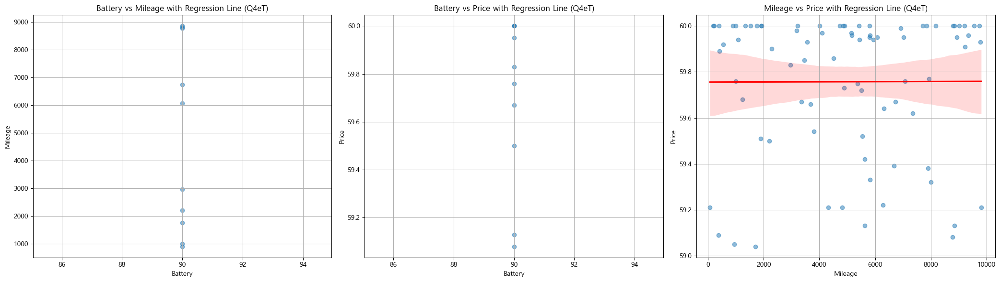

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Q4eT 모델 

model_name = "Q4eT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 7) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

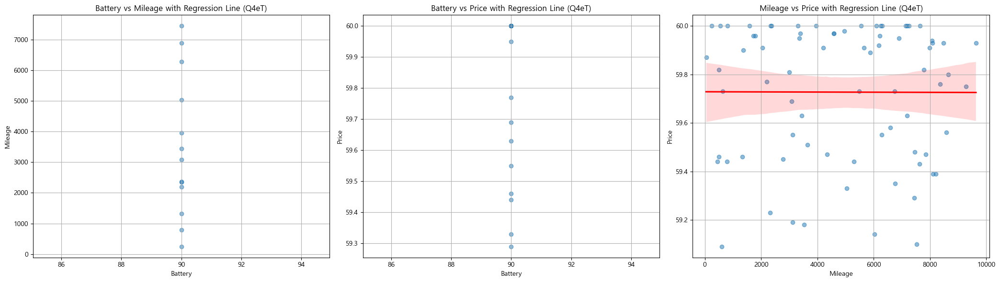

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Q4eT 모델 

model_name = "Q4eT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 8) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

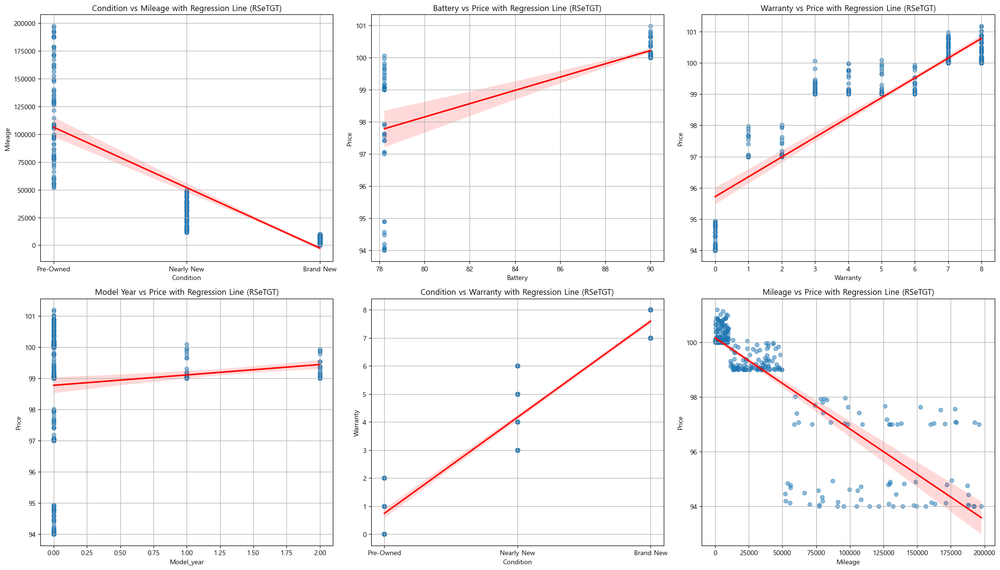

In [30]:
# ----------------------------------------------------------------------------------------------------
# RSeTGT 모델 

model_name = "RSeTGT"

result = learning.loc[(learning["Model"] == model_name), :]

result.loc[result["Condition"] == "Brand New","Condition"] = 2.0
result.loc[result["Condition"] == "Nearly New","Condition"] = 1.0
result.loc[result["Condition"] == "Pre-Owned","Condition"] = 0.0

result["Condition"] = result["Condition"].astype("float64")

# Figure 생성
plt.figure(figsize=(21, 12))

# 1행 3열 그래프
plt.subplot(2, 3, 1)  # (2행 3열) 중 1번째
sns.regplot(data=result, x="Condition", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Mileage")
plt.title(f"Condition vs Mileage with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 2)  # (2행 3열) 중 2번째
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 3)  # (2행 3열) 중 3번째
sns.regplot(data=result, x="Warranty", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Warranty")
plt.ylabel("Price")
plt.title(f"Warranty vs Price with Regression Line ({model_name})")
plt.grid(True)

# 2행 3열 그래프
plt.subplot(2, 3, 4)  # (2행 3열) 중 4번째
sns.regplot(data=result, x="Model_year", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Model_year")
plt.ylabel("Price")
plt.title(f"Model Year vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 5)  # (2행 3열) 중 5번째
sns.regplot(data=result, x="Condition", y="Warranty", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Warranty")
plt.title(f"Condition vs Warranty with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 6)  # (2행 3열) 중 6번째
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()  # 그래프 간 간격 자동 조정
plt.show()
# ----------------------------------------------------------------------------------------------------

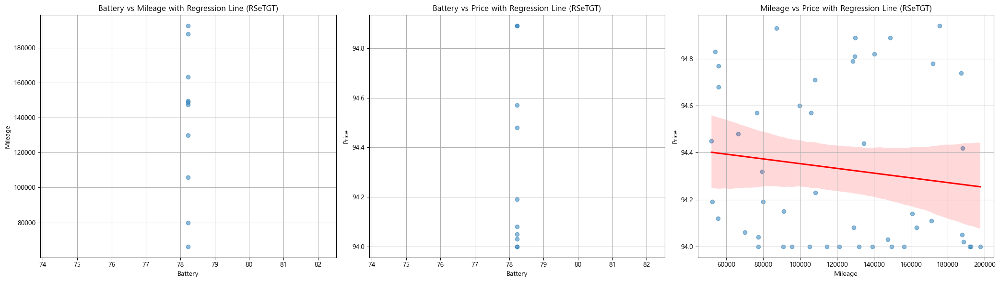

In [ ]:
# ----------------------------------------------------------------------------------------------------
# RSeTGT 모델 

model_name = "RSeTGT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 0) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

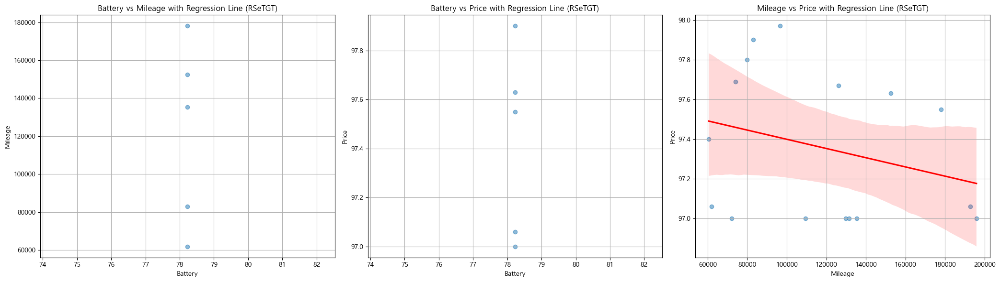

In [ ]:
# ----------------------------------------------------------------------------------------------------
# RSeTGT 모델 

model_name = "RSeTGT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 1) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

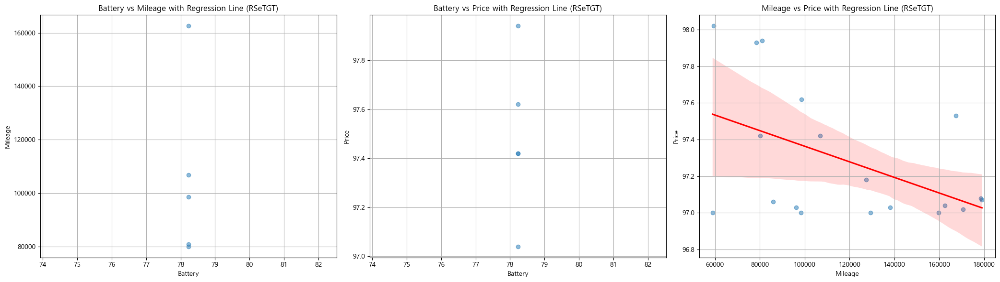

In [ ]:
# ----------------------------------------------------------------------------------------------------
# RSeTGT 모델 

model_name = "RSeTGT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 2) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

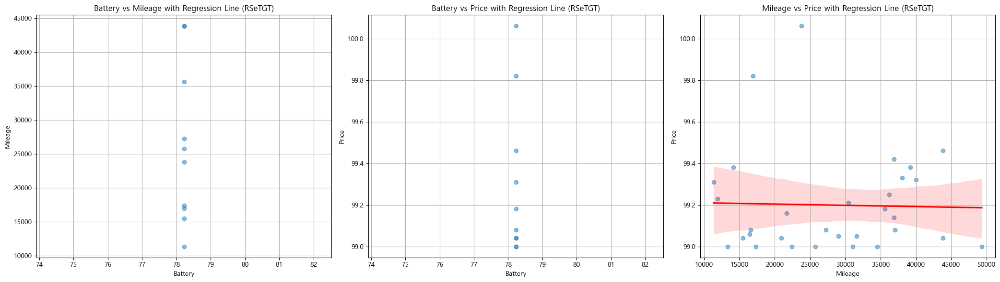

In [ ]:
# ----------------------------------------------------------------------------------------------------
# RSeTGT 모델 

model_name = "RSeTGT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 3) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

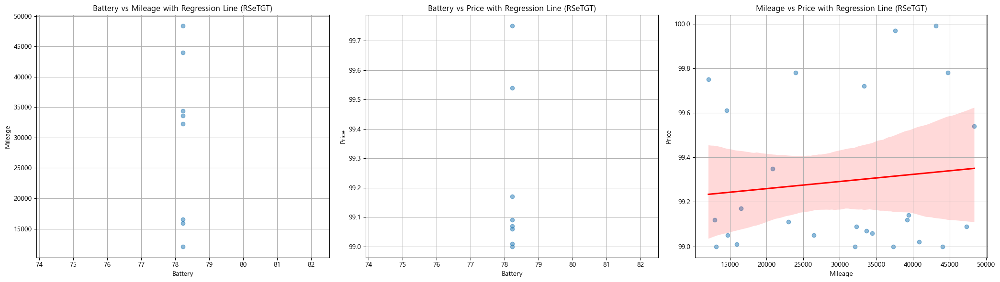

In [ ]:
# ----------------------------------------------------------------------------------------------------
# RSeTGT 모델 

model_name = "RSeTGT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 4) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

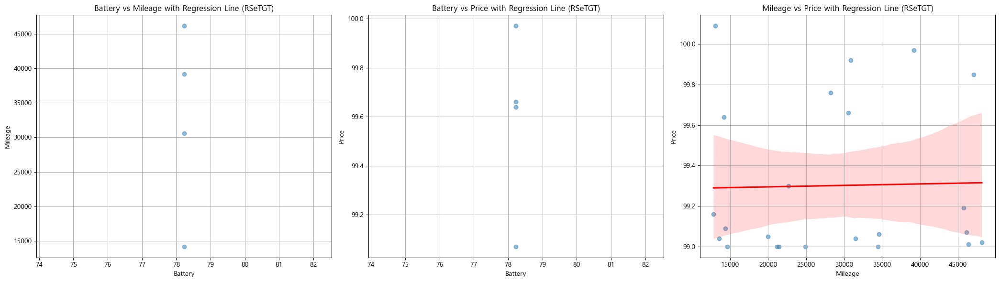

In [ ]:
# ----------------------------------------------------------------------------------------------------
# RSeTGT 모델 

model_name = "RSeTGT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 5) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

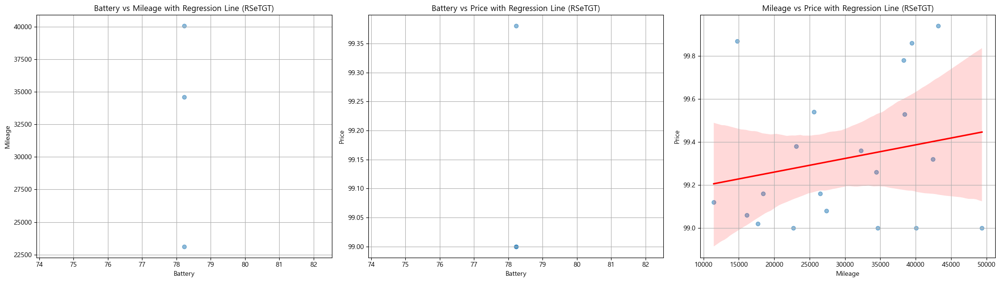

In [ ]:
# ----------------------------------------------------------------------------------------------------
# RSeTGT 모델 

model_name = "RSeTGT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 6) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

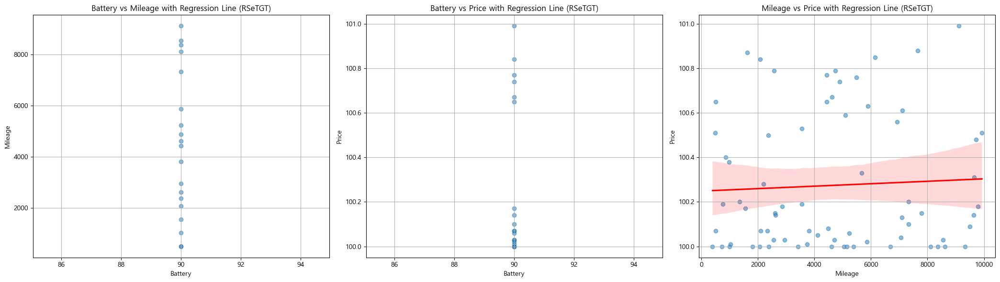

In [ ]:
# ----------------------------------------------------------------------------------------------------
# RSeTGT 모델 

model_name = "RSeTGT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 7) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

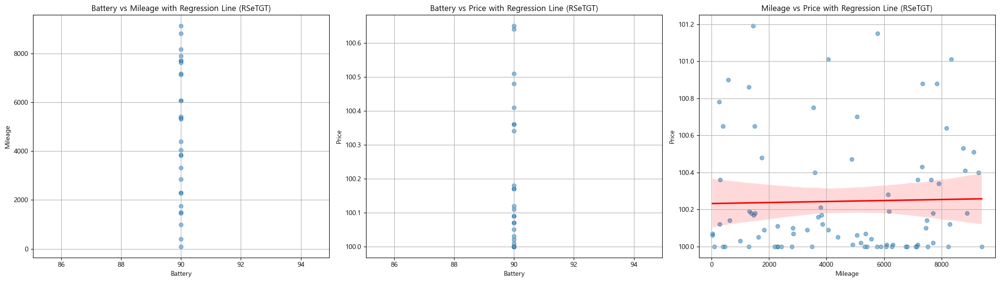

In [ ]:
# ----------------------------------------------------------------------------------------------------
# RSeTGT 모델 

model_name = "RSeTGT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 8) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

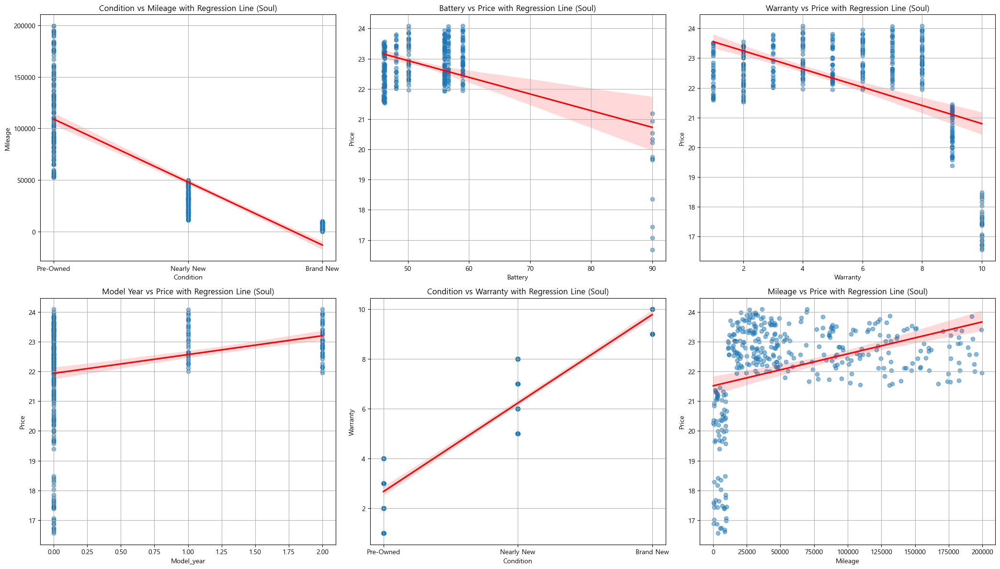

In [31]:
# ----------------------------------------------------------------------------------------------------
# Soul 모델 

model_name = "Soul"

result = learning.loc[(learning["Model"] == model_name), :]

result.loc[result["Condition"] == "Brand New","Condition"] = 2.0
result.loc[result["Condition"] == "Nearly New","Condition"] = 1.0
result.loc[result["Condition"] == "Pre-Owned","Condition"] = 0.0

result["Condition"] = result["Condition"].astype("float64")

# Figure 생성
plt.figure(figsize=(21, 12))

# 1행 3열 그래프
plt.subplot(2, 3, 1)  # (2행 3열) 중 1번째
sns.regplot(data=result, x="Condition", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Mileage")
plt.title(f"Condition vs Mileage with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 2)  # (2행 3열) 중 2번째
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 3)  # (2행 3열) 중 3번째
sns.regplot(data=result, x="Warranty", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Warranty")
plt.ylabel("Price")
plt.title(f"Warranty vs Price with Regression Line ({model_name})")
plt.grid(True)

# 2행 3열 그래프
plt.subplot(2, 3, 4)  # (2행 3열) 중 4번째
sns.regplot(data=result, x="Model_year", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Model_year")
plt.ylabel("Price")
plt.title(f"Model Year vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 5)  # (2행 3열) 중 5번째
sns.regplot(data=result, x="Condition", y="Warranty", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Warranty")
plt.title(f"Condition vs Warranty with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 6)  # (2행 3열) 중 6번째
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()  # 그래프 간 간격 자동 조정
plt.show()
# ----------------------------------------------------------------------------------------------------

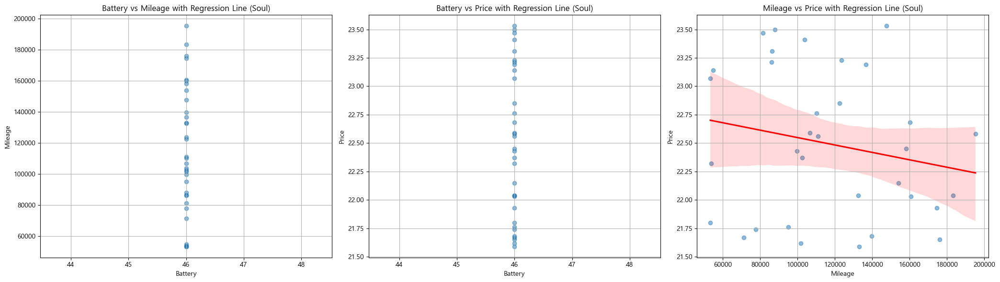

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Soul 모델 

model_name = "Soul"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 1) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

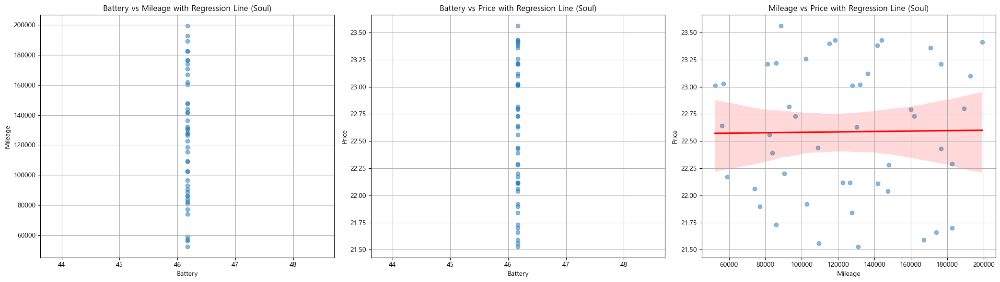

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Soul 모델 

model_name = "Soul"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 2) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

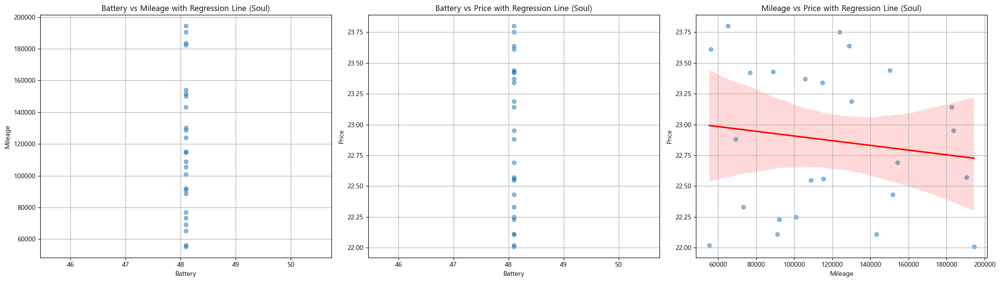

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Soul 모델 

model_name = "Soul"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 3) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

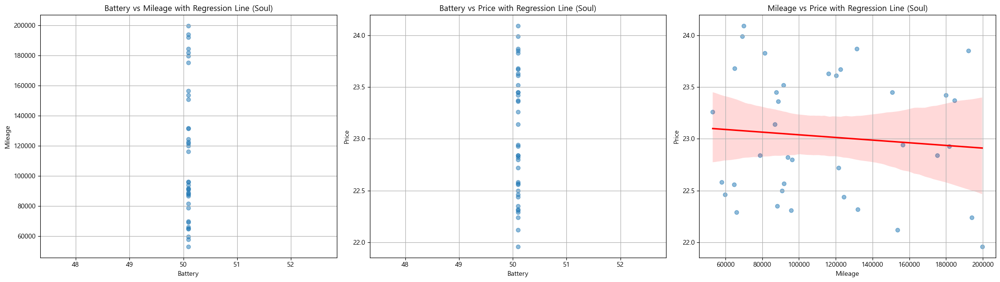

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Soul 모델 

model_name = "Soul"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 4) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

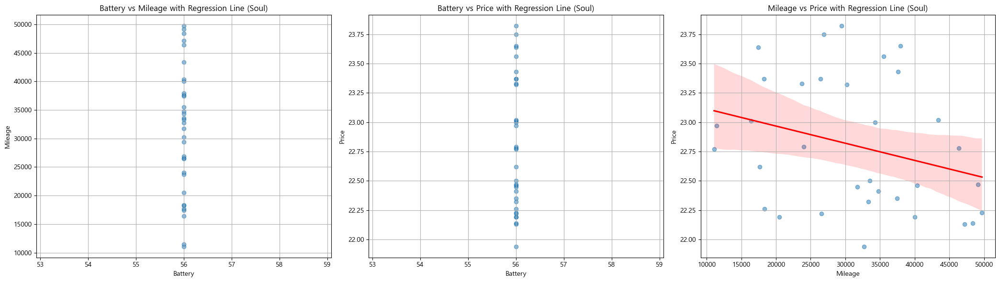

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Soul 모델 

model_name = "Soul"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 5) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

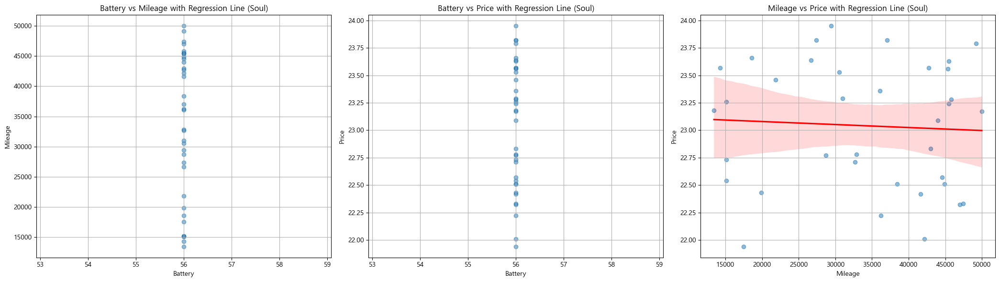

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Soul 모델 

model_name = "Soul"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 6) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

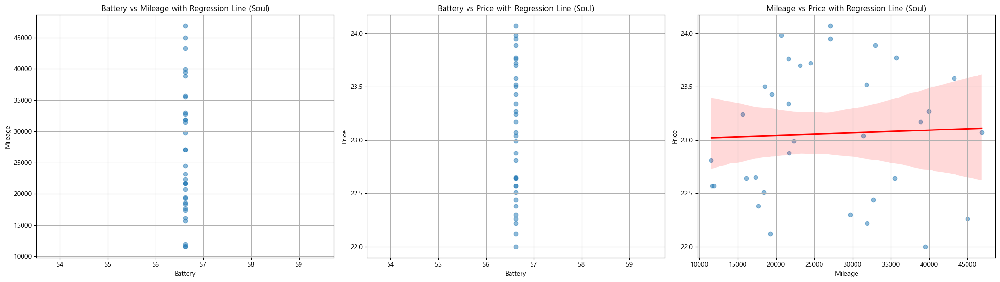

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Soul 모델 

model_name = "Soul"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 7) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

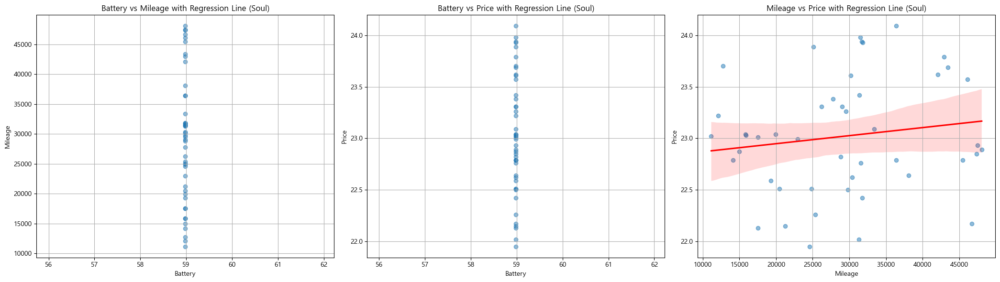

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Soul 모델 

model_name = "Soul"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 8) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

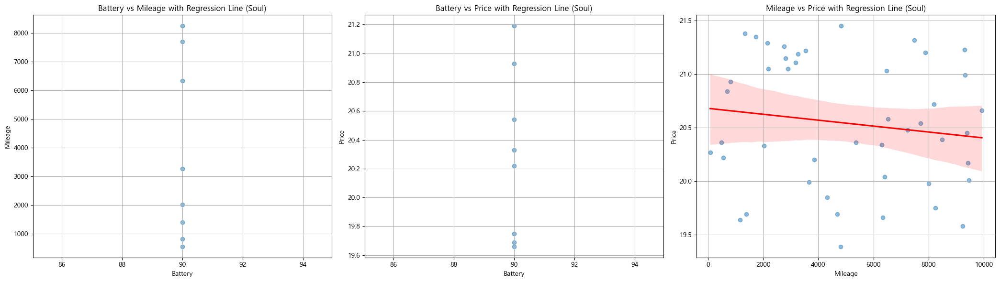

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Soul 모델 

model_name = "Soul"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 9) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

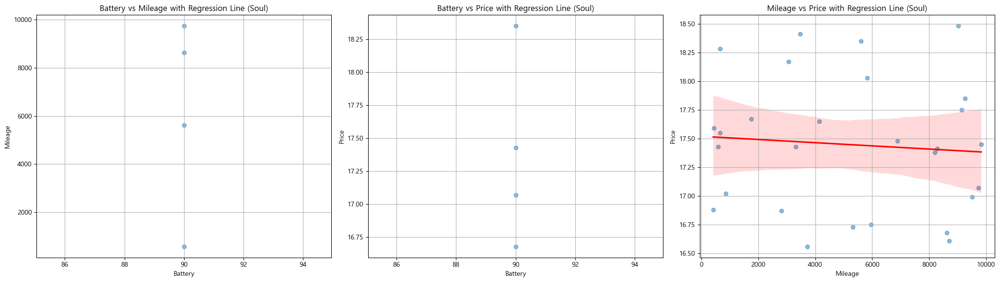

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Soul 모델 

model_name = "Soul"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 10) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

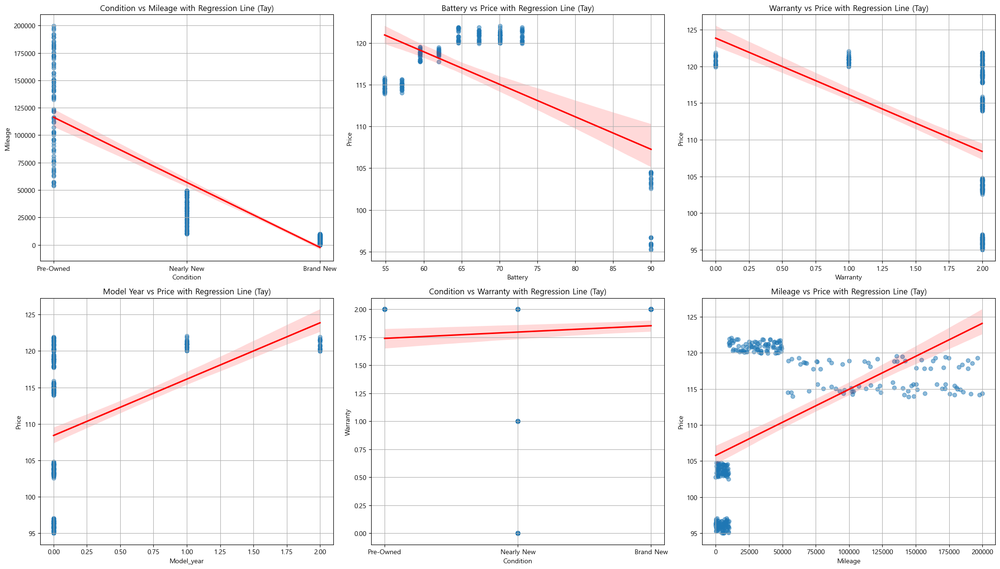

In [32]:
# ----------------------------------------------------------------------------------------------------
# Tay 모델 

model_name = "Tay"

result = learning.loc[(learning["Model"] == model_name), :]

result.loc[result["Condition"] == "Brand New","Condition"] = 2.0
result.loc[result["Condition"] == "Nearly New","Condition"] = 1.0
result.loc[result["Condition"] == "Pre-Owned","Condition"] = 0.0

result["Condition"] = result["Condition"].astype("float64")

# Figure 생성
plt.figure(figsize=(21, 12))

# 1행 3열 그래프
plt.subplot(2, 3, 1)  # (2행 3열) 중 1번째
sns.regplot(data=result, x="Condition", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Mileage")
plt.title(f"Condition vs Mileage with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 2)  # (2행 3열) 중 2번째
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 3)  # (2행 3열) 중 3번째
sns.regplot(data=result, x="Warranty", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Warranty")
plt.ylabel("Price")
plt.title(f"Warranty vs Price with Regression Line ({model_name})")
plt.grid(True)

# 2행 3열 그래프
plt.subplot(2, 3, 4)  # (2행 3열) 중 4번째
sns.regplot(data=result, x="Model_year", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Model_year")
plt.ylabel("Price")
plt.title(f"Model Year vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 5)  # (2행 3열) 중 5번째
sns.regplot(data=result, x="Condition", y="Warranty", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Warranty")
plt.title(f"Condition vs Warranty with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 6)  # (2행 3열) 중 6번째
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()  # 그래프 간 간격 자동 조정
plt.show()
# ----------------------------------------------------------------------------------------------------

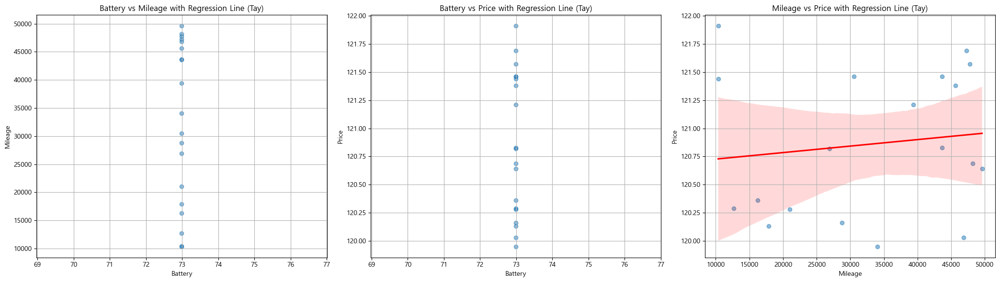

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Tay 모델 

model_name = "Tay"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 0) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

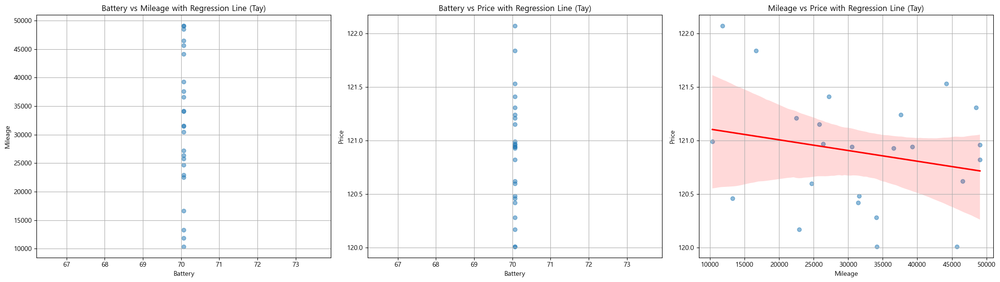

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Tay 모델 

model_name = "Tay"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 1) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

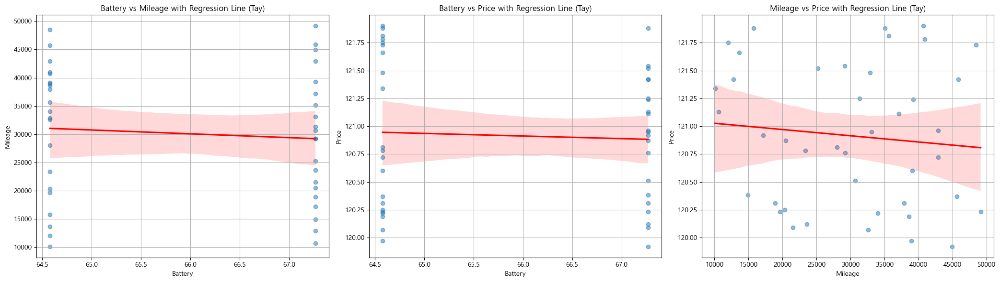

In [ ]:
# ----------------------------------------------------------------------------------------------------
# Tay 모델 

model_name = "Tay"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 2) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

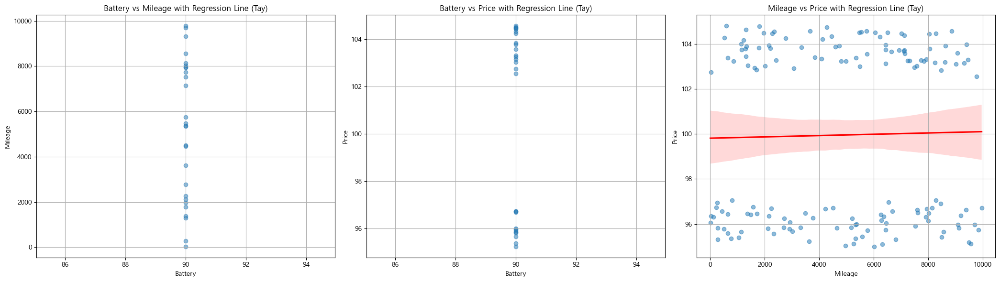

In [19]:
# ----------------------------------------------------------------------------------------------------
# Tay 모델 

model_name = "Tay"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 2) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

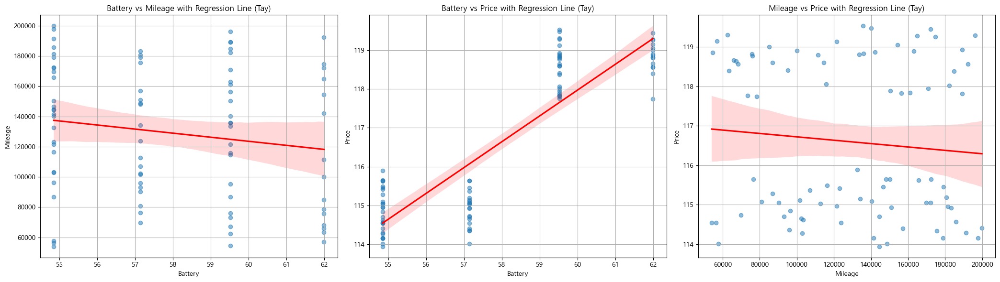

In [15]:
# ----------------------------------------------------------------------------------------------------
# Tay 모델 

model_name = "Tay"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 2) & 
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

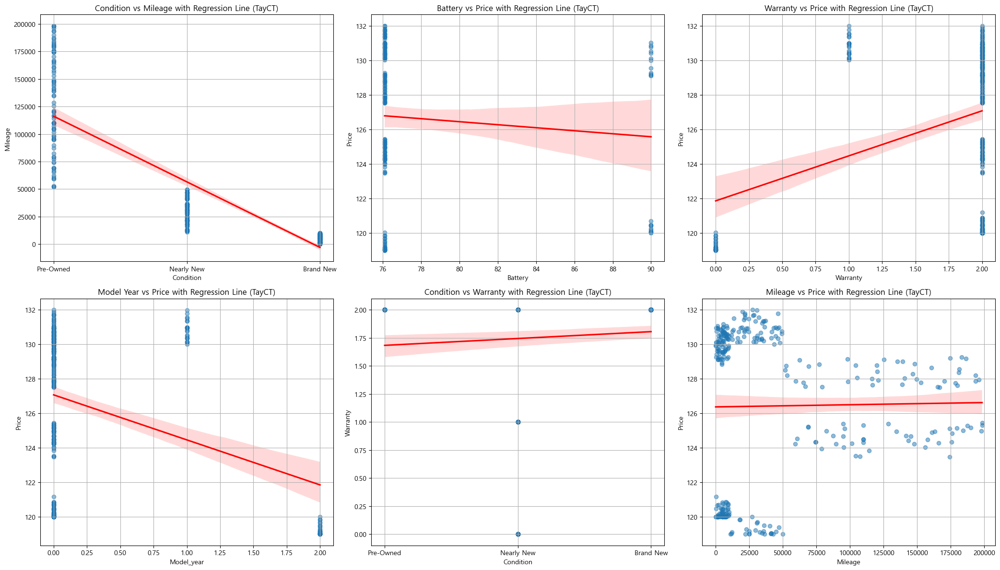

In [33]:
# ----------------------------------------------------------------------------------------------------
# TayCT 모델 

model_name = "TayCT"

result = learning.loc[(learning["Model"] == model_name), :]

result.loc[result["Condition"] == "Brand New","Condition"] = 2.0
result.loc[result["Condition"] == "Nearly New","Condition"] = 1.0
result.loc[result["Condition"] == "Pre-Owned","Condition"] = 0.0

result["Condition"] = result["Condition"].astype("float64")

# Figure 생성
plt.figure(figsize=(21, 12))

# 1행 3열 그래프
plt.subplot(2, 3, 1)  # (2행 3열) 중 1번째
sns.regplot(data=result, x="Condition", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Mileage")
plt.title(f"Condition vs Mileage with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 2)  # (2행 3열) 중 2번째
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 3)  # (2행 3열) 중 3번째
sns.regplot(data=result, x="Warranty", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Warranty")
plt.ylabel("Price")
plt.title(f"Warranty vs Price with Regression Line ({model_name})")
plt.grid(True)

# 2행 3열 그래프
plt.subplot(2, 3, 4)  # (2행 3열) 중 4번째
sns.regplot(data=result, x="Model_year", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Model_year")
plt.ylabel("Price")
plt.title(f"Model Year vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 5)  # (2행 3열) 중 5번째
sns.regplot(data=result, x="Condition", y="Warranty", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Warranty")
plt.title(f"Condition vs Warranty with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 6)  # (2행 3열) 중 6번째
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()  # 그래프 간 간격 자동 조정
plt.show()
# ----------------------------------------------------------------------------------------------------

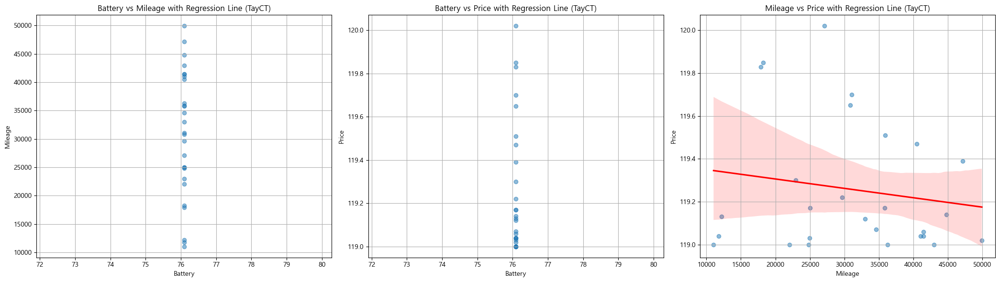

In [ ]:
# ----------------------------------------------------------------------------------------------------
# TayCT 모델 

model_name = "TayCT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 0) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

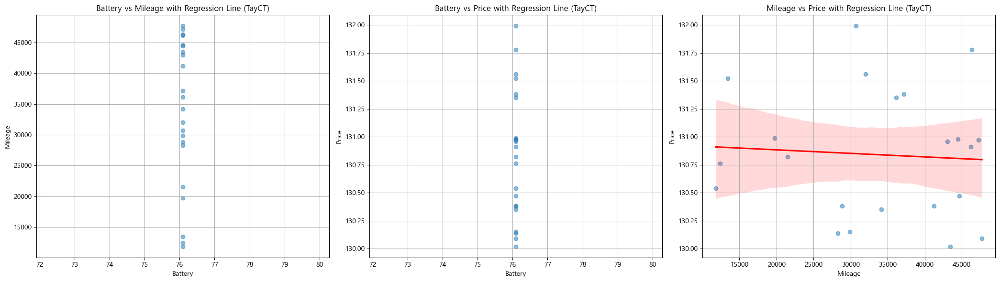

In [ ]:
# ----------------------------------------------------------------------------------------------------
# TayCT 모델 

model_name = "TayCT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 1) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

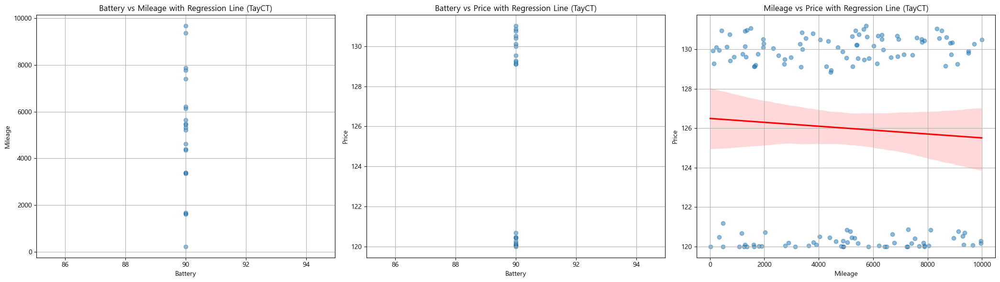

In [44]:
# ----------------------------------------------------------------------------------------------------
# TayCT 모델 

model_name = "TayCT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 2) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

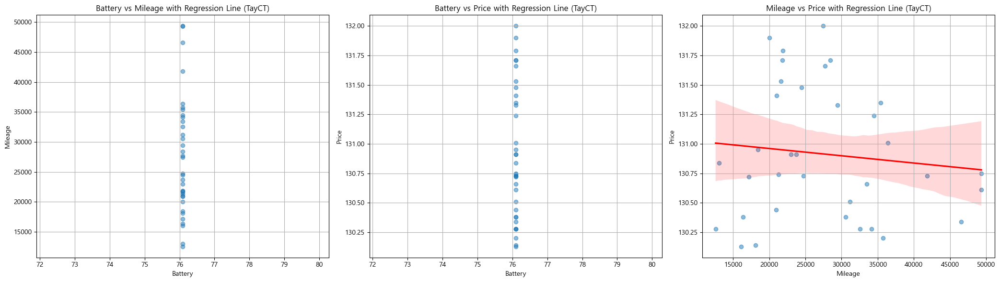

In [ ]:
# ----------------------------------------------------------------------------------------------------
# TayCT 모델 

model_name = "TayCT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 2) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

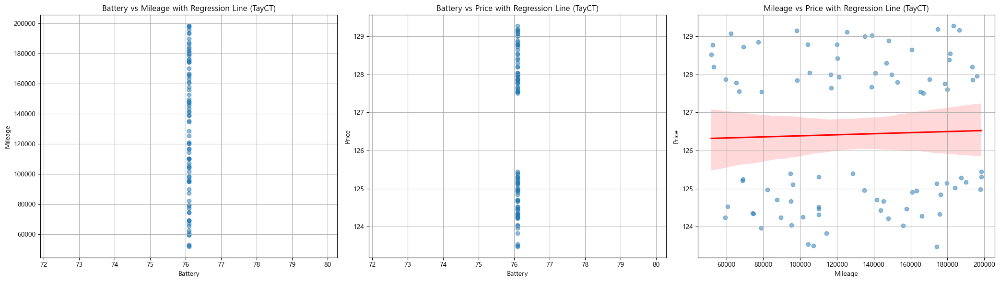

In [20]:
# ----------------------------------------------------------------------------------------------------
# TayCT 모델 

model_name = "TayCT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 2) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

In [21]:
result

,Id,Model,Manufacturer,Model_year,Drivetrain,Warranty,Accident,Condition,Battery,Mileage,Price
102,TRAIN_0976,TayCT,P사,0,AWD,2,No,Pre-Owned,76.093,186493,129.16
179,TRAIN_3731,TayCT,P사,0,AWD,2,No,Pre-Owned,76.093,68795,125.21
206,TRAIN_2719,TayCT,P사,0,AWD,2,Yes,Pre-Owned,76.093,82307,124.97
514,TRAIN_2862,TayCT,P사,0,AWD,2,No,Pre-Owned,76.093,166087,124.28
773,TRAIN_7035,TayCT,P사,0,AWD,2,No,Pre-Owned,76.093,120356,128.42
792,TRAIN_6101,TayCT,P사,0,AWD,2,No,Pre-Owned,76.093,59494,127.87
807,TRAIN_6534,TayCT,P사,0,AWD,2,No,Pre-Owned,76.093,178703,127.75
899,TRAIN_0058,TayCT,P사,0,AWD,2,No,Pre-Owned,76.093,110041,124.47
905,TRAIN_6557,TayCT,P사,0,AWD,2,No,Pre-Owned,76.093,135175,129.00
1078,TRAIN_6412,TayCT,P사,0,AWD,2,No,Pre-Owned,76.093,51761,128.52


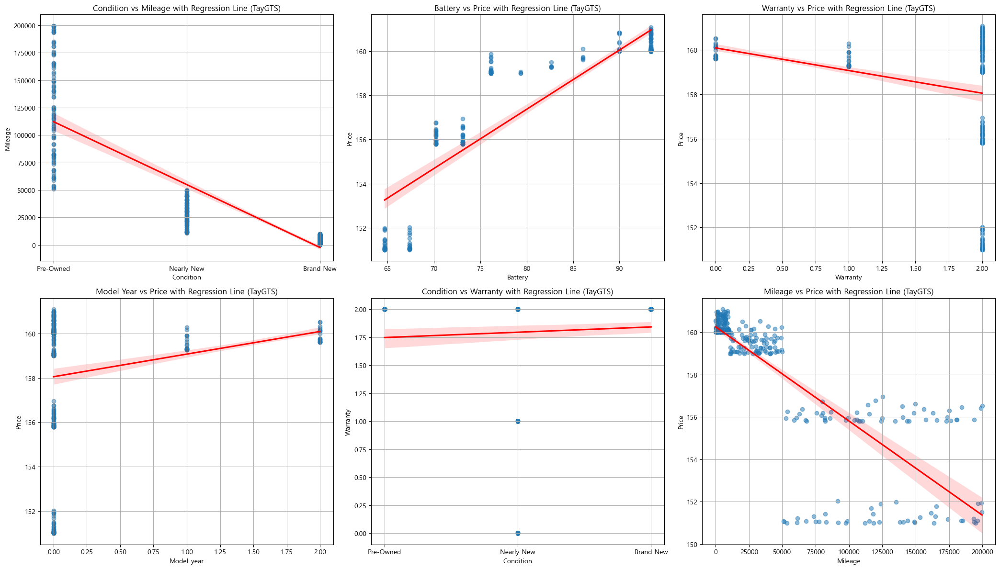

In [46]:
# ----------------------------------------------------------------------------------------------------
# TayGTS 모델 

model_name = "TayGTS"

result = learning.loc[(learning["Model"] == model_name), :]

result.loc[result["Condition"] == "Brand New","Condition"] = 2.0
result.loc[result["Condition"] == "Nearly New","Condition"] = 1.0
result.loc[result["Condition"] == "Pre-Owned","Condition"] = 0.0

result["Condition"] = result["Condition"].astype("float64")

# Figure 생성
plt.figure(figsize=(21, 12))

# 1행 3열 그래프
plt.subplot(2, 3, 1)  # (2행 3열) 중 1번째
sns.regplot(data=result, x="Condition", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Mileage")
plt.title(f"Condition vs Mileage with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 2)  # (2행 3열) 중 2번째
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 3)  # (2행 3열) 중 3번째
sns.regplot(data=result, x="Warranty", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Warranty")
plt.ylabel("Price")
plt.title(f"Warranty vs Price with Regression Line ({model_name})")
plt.grid(True)

# 2행 3열 그래프
plt.subplot(2, 3, 4)  # (2행 3열) 중 4번째
sns.regplot(data=result, x="Model_year", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Model_year")
plt.ylabel("Price")
plt.title(f"Model Year vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 5)  # (2행 3열) 중 5번째
sns.regplot(data=result, x="Condition", y="Warranty", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Warranty")
plt.title(f"Condition vs Warranty with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 6)  # (2행 3열) 중 6번째
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()  # 그래프 간 간격 자동 조정
plt.show()
# ----------------------------------------------------------------------------------------------------

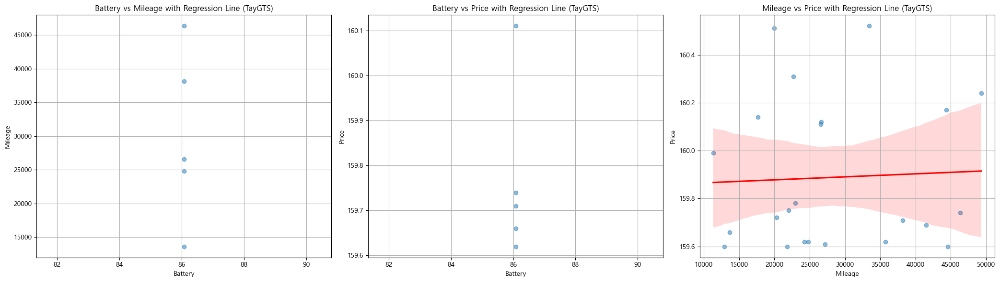

In [ ]:
# ----------------------------------------------------------------------------------------------------
# TayGTS 모델 

model_name = "TayGTS"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 0) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

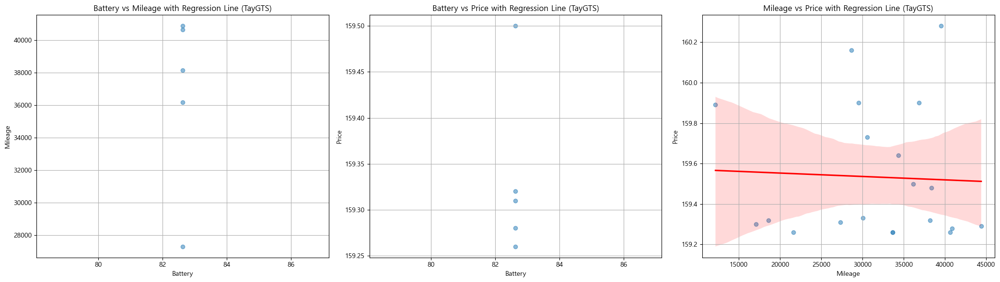

In [ ]:
# ----------------------------------------------------------------------------------------------------
# TayGTS 모델 

model_name = "TayGTS"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 1) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

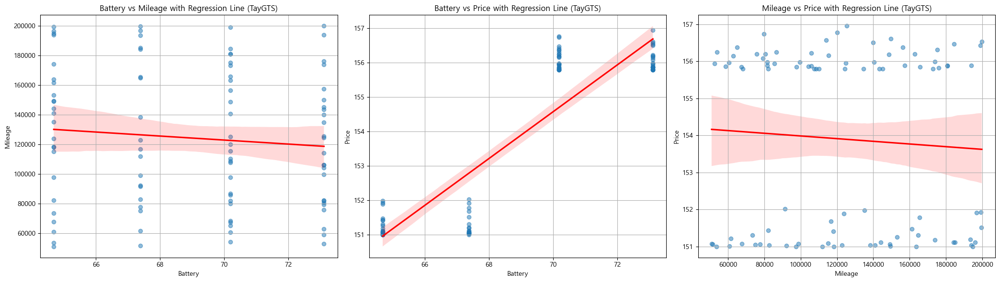

In [ ]:
# ----------------------------------------------------------------------------------------------------
# TayGTS 모델 

model_name = "TayGTS"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 2) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

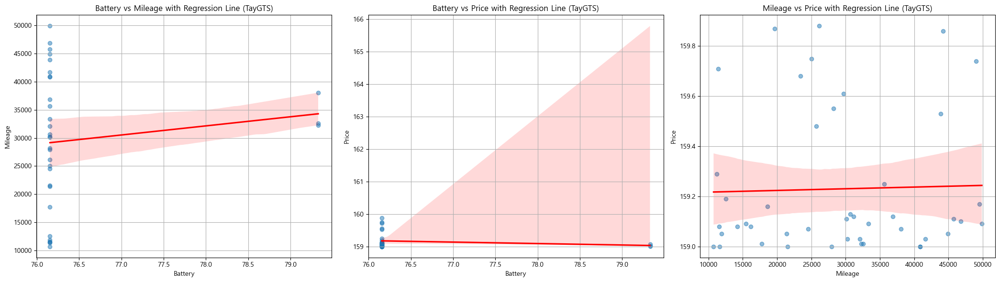

In [ ]:
# ----------------------------------------------------------------------------------------------------
# TayGTS 모델 

model_name = "TayGTS"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 2) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

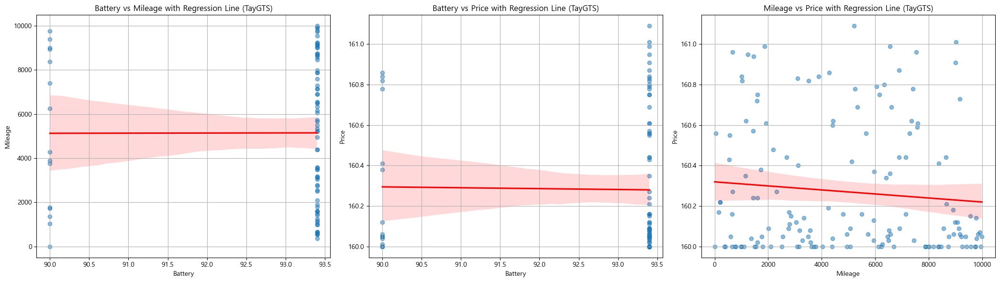

In [ ]:
# ----------------------------------------------------------------------------------------------------
# TayGTS 모델 

model_name = "TayGTS"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 2) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

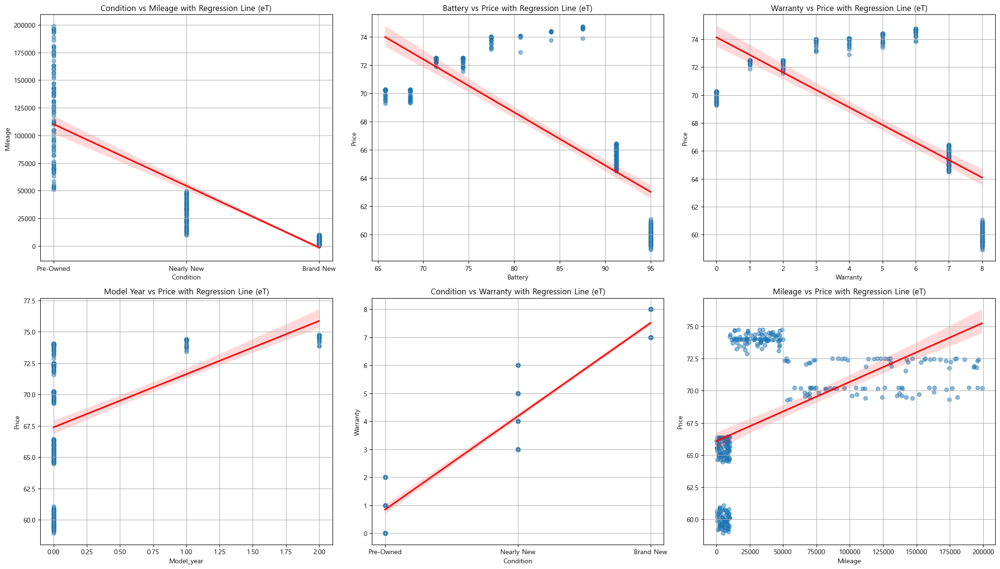

In [47]:
# ----------------------------------------------------------------------------------------------------
# eT 모델 

model_name = "eT"

result = learning.loc[(learning["Model"] == model_name), :]

result.loc[result["Condition"] == "Brand New","Condition"] = 2.0
result.loc[result["Condition"] == "Nearly New","Condition"] = 1.0
result.loc[result["Condition"] == "Pre-Owned","Condition"] = 0.0

result["Condition"] = result["Condition"].astype("float64")

# Figure 생성
plt.figure(figsize=(21, 12))

# 1행 3열 그래프
plt.subplot(2, 3, 1)  # (2행 3열) 중 1번째
sns.regplot(data=result, x="Condition", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Mileage")
plt.title(f"Condition vs Mileage with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 2)  # (2행 3열) 중 2번째
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 3)  # (2행 3열) 중 3번째
sns.regplot(data=result, x="Warranty", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Warranty")
plt.ylabel("Price")
plt.title(f"Warranty vs Price with Regression Line ({model_name})")
plt.grid(True)

# 2행 3열 그래프
plt.subplot(2, 3, 4)  # (2행 3열) 중 4번째
sns.regplot(data=result, x="Model_year", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Model_year")
plt.ylabel("Price")
plt.title(f"Model Year vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 5)  # (2행 3열) 중 5번째
sns.regplot(data=result, x="Condition", y="Warranty", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Warranty")
plt.title(f"Condition vs Warranty with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 6)  # (2행 3열) 중 6번째
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()  # 그래프 간 간격 자동 조정
plt.show()
# ----------------------------------------------------------------------------------------------------

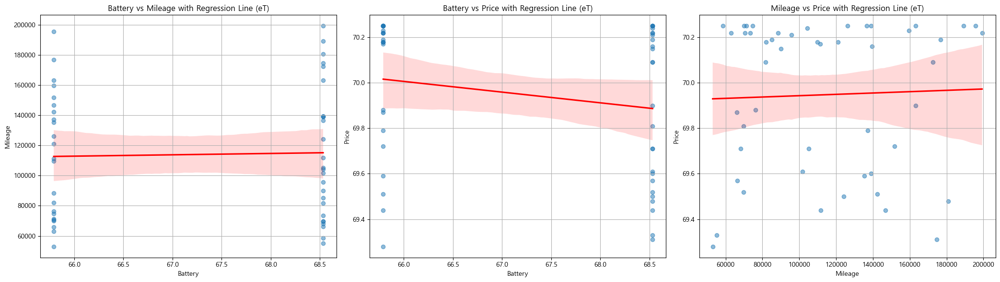

In [ ]:
# ----------------------------------------------------------------------------------------------------
# eT 모델 

model_name = "eT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 0) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

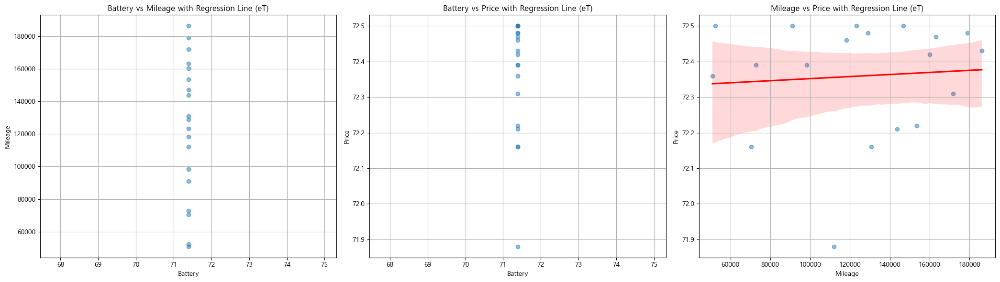

In [ ]:
# ----------------------------------------------------------------------------------------------------
# eT 모델 

model_name = "eT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 1) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

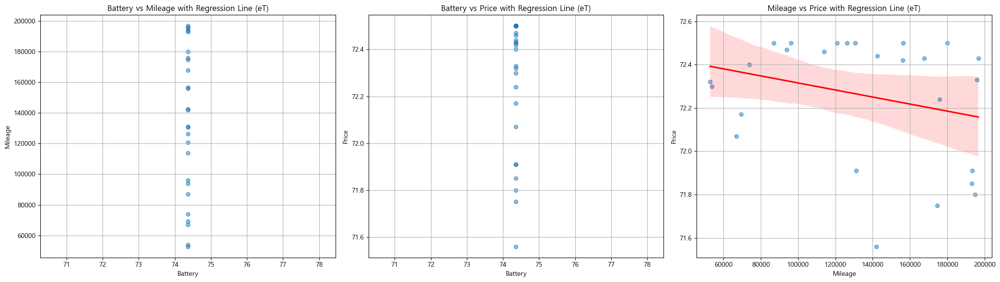

In [ ]:
# ----------------------------------------------------------------------------------------------------
# eT 모델 

model_name = "eT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 2) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

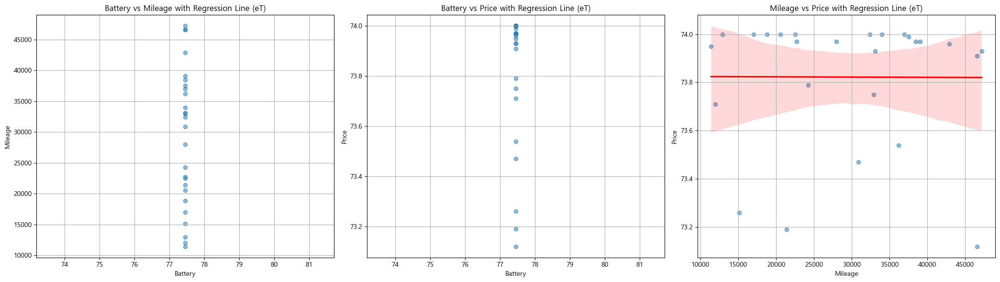

In [ ]:
# ----------------------------------------------------------------------------------------------------
# eT 모델 

model_name = "eT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 3) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

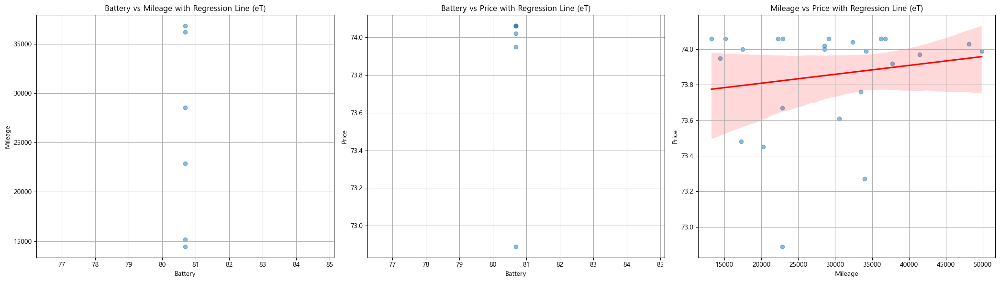

In [ ]:
# ----------------------------------------------------------------------------------------------------
# eT 모델 

model_name = "eT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 4) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

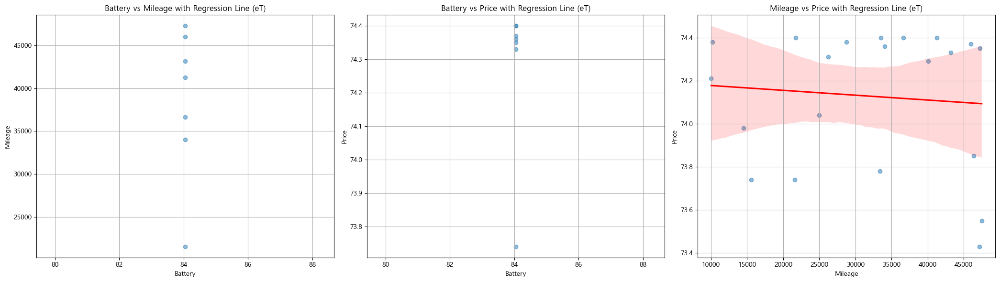

In [ ]:
# ----------------------------------------------------------------------------------------------------
# eT 모델 

model_name = "eT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 5) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

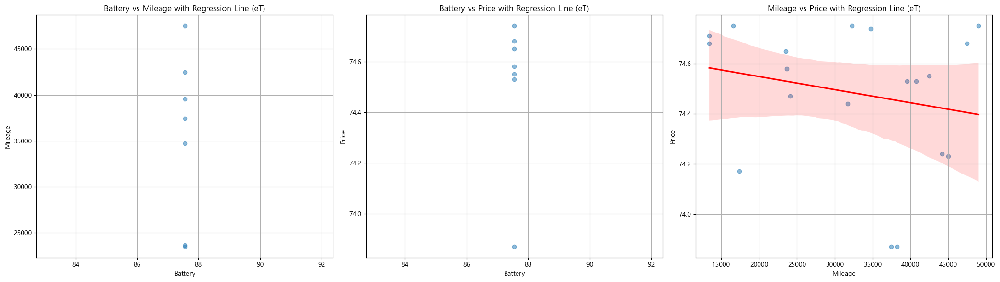

In [ ]:
# ----------------------------------------------------------------------------------------------------
# eT 모델 

model_name = "eT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 6) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

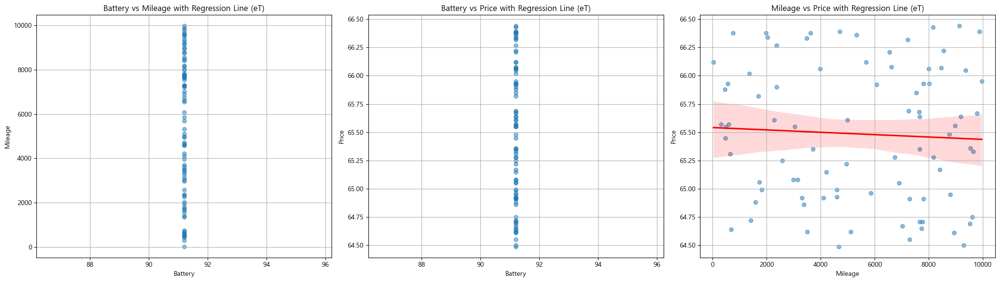

In [ ]:
# ----------------------------------------------------------------------------------------------------
# eT 모델 

model_name = "eT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 7) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

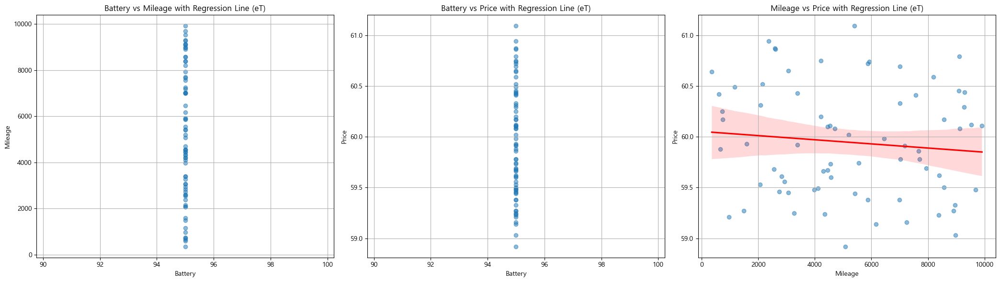

In [ ]:
# ----------------------------------------------------------------------------------------------------
# eT 모델 

model_name = "eT"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 8) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

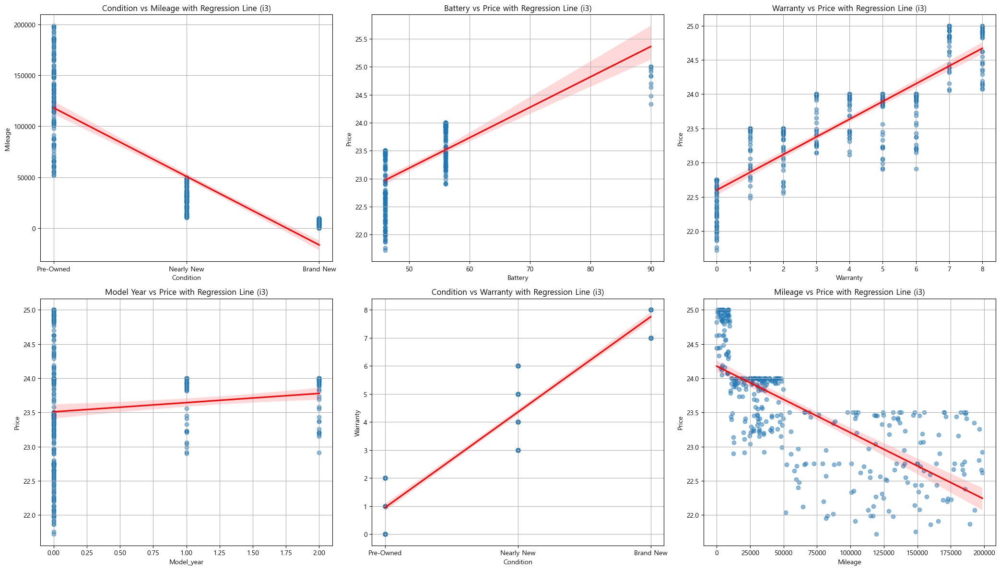

In [48]:
# ----------------------------------------------------------------------------------------------------
# i3 모델 

model_name = "i3"

result = learning.loc[(learning["Model"] == model_name), :]

result.loc[result["Condition"] == "Brand New","Condition"] = 2.0
result.loc[result["Condition"] == "Nearly New","Condition"] = 1.0
result.loc[result["Condition"] == "Pre-Owned","Condition"] = 0.0

result["Condition"] = result["Condition"].astype("float64")

# Figure 생성
plt.figure(figsize=(21, 12))

# 1행 3열 그래프
plt.subplot(2, 3, 1)  # (2행 3열) 중 1번째
sns.regplot(data=result, x="Condition", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Mileage")
plt.title(f"Condition vs Mileage with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 2)  # (2행 3열) 중 2번째
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 3)  # (2행 3열) 중 3번째
sns.regplot(data=result, x="Warranty", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Warranty")
plt.ylabel("Price")
plt.title(f"Warranty vs Price with Regression Line ({model_name})")
plt.grid(True)

# 2행 3열 그래프
plt.subplot(2, 3, 4)  # (2행 3열) 중 4번째
sns.regplot(data=result, x="Model_year", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Model_year")
plt.ylabel("Price")
plt.title(f"Model Year vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 5)  # (2행 3열) 중 5번째
sns.regplot(data=result, x="Condition", y="Warranty", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Warranty")
plt.title(f"Condition vs Warranty with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 6)  # (2행 3열) 중 6번째
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()  # 그래프 간 간격 자동 조정
plt.show()
# ----------------------------------------------------------------------------------------------------

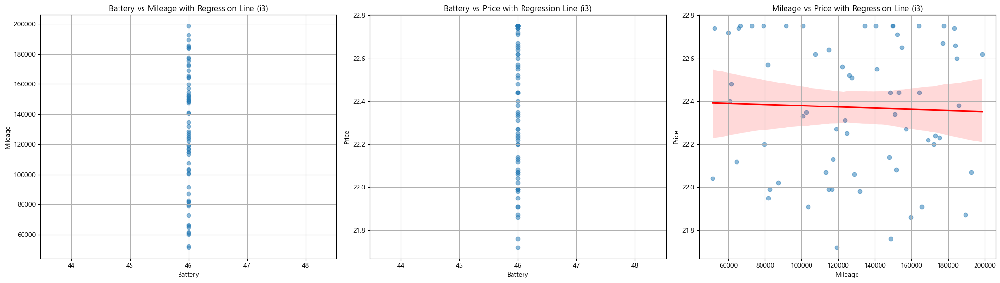

In [ ]:
# ----------------------------------------------------------------------------------------------------
# i3 모델 

model_name = "i3"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 0) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

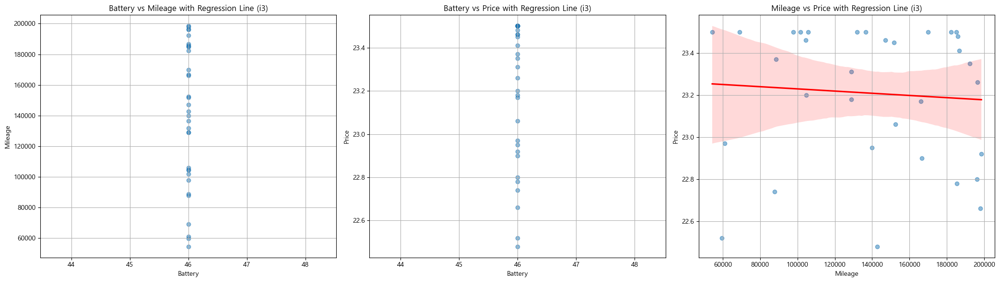

In [ ]:
# ----------------------------------------------------------------------------------------------------
# i3 모델 

model_name = "i3"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 1) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

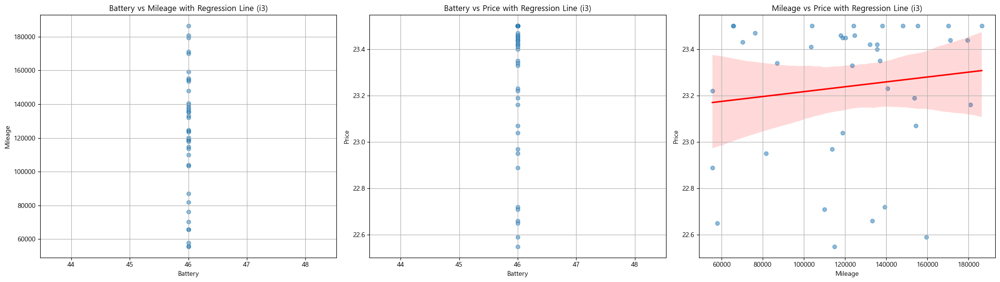

In [ ]:
# ----------------------------------------------------------------------------------------------------
# i3 모델 

model_name = "i3"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 2) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

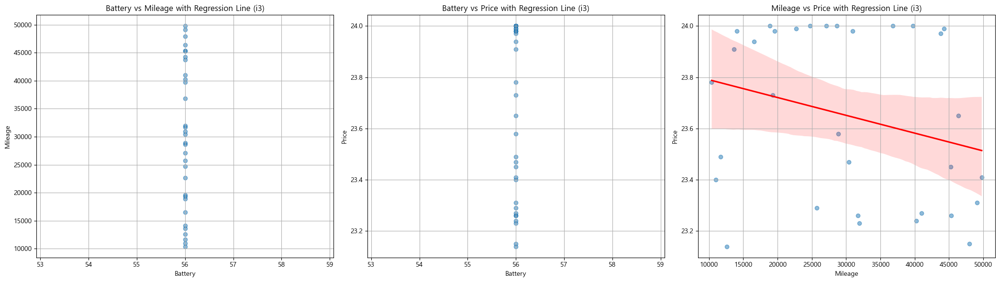

In [ ]:
# ----------------------------------------------------------------------------------------------------
# i3 모델 

model_name = "i3"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 3) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

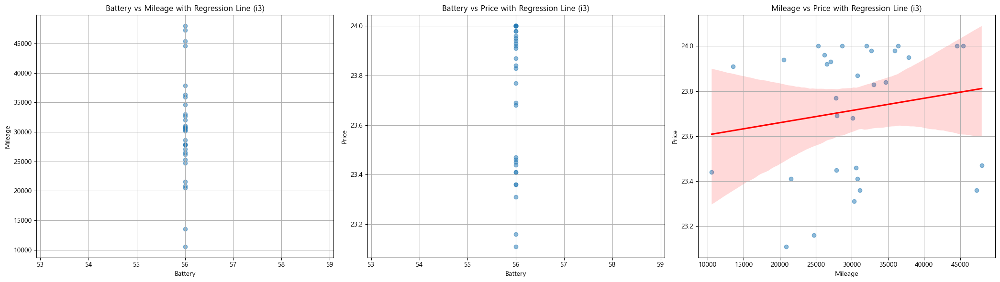

In [ ]:
# ----------------------------------------------------------------------------------------------------
# i3 모델 

model_name = "i3"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 4) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

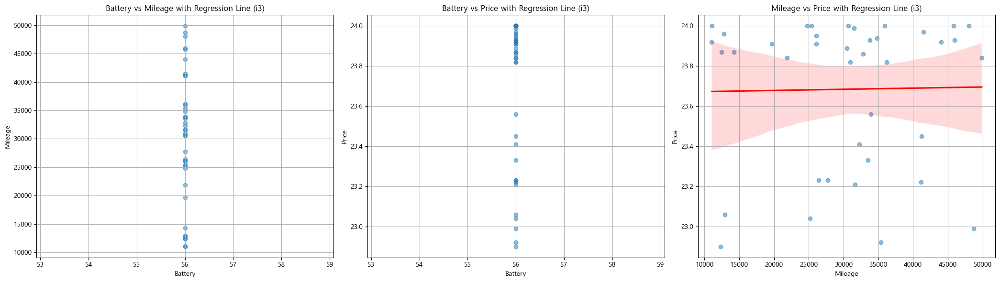

In [ ]:
# ----------------------------------------------------------------------------------------------------
# i3 모델 

model_name = "i3"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 5) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

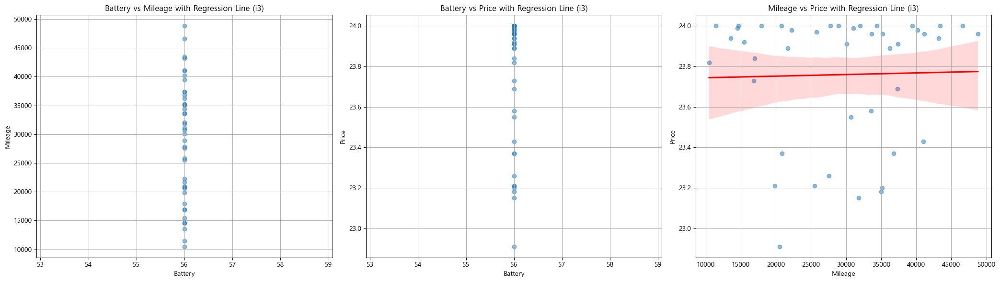

In [ ]:
# ----------------------------------------------------------------------------------------------------
# i3 모델 

model_name = "i3"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 6) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

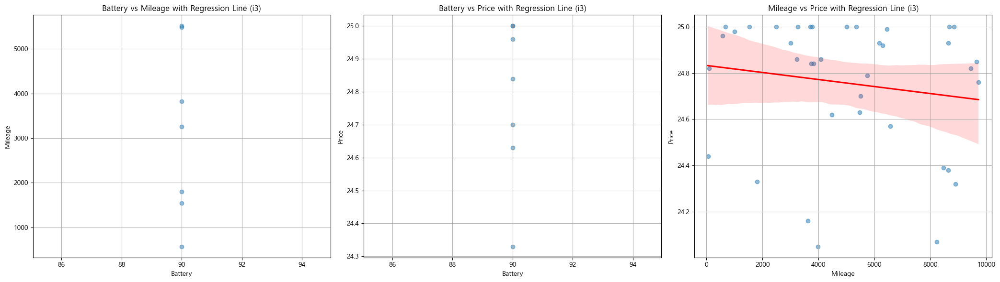

In [ ]:
# ----------------------------------------------------------------------------------------------------
# i3 모델 

model_name = "i3"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 7) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

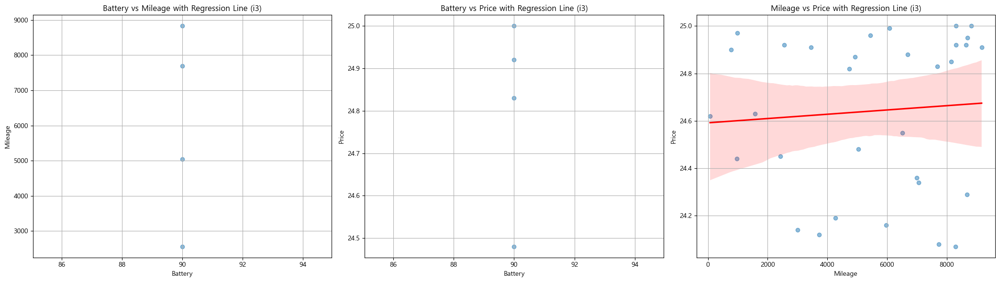

In [ ]:
# ----------------------------------------------------------------------------------------------------
# i3 모델 

model_name = "i3"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 8) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

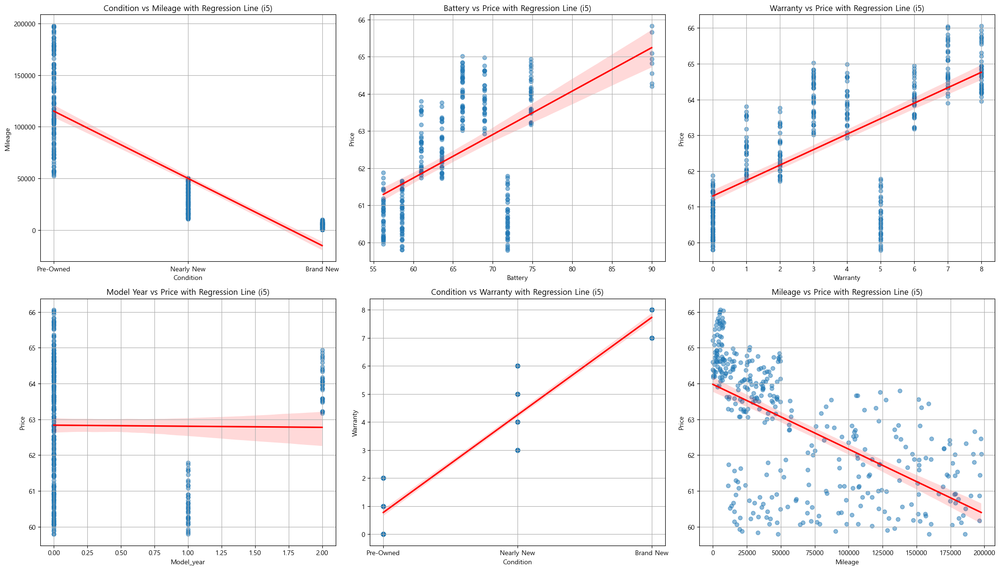

In [49]:
# ----------------------------------------------------------------------------------------------------
# i5 모델 

model_name = "i5"

result = learning.loc[(learning["Model"] == model_name), :]

result.loc[result["Condition"] == "Brand New","Condition"] = 2.0
result.loc[result["Condition"] == "Nearly New","Condition"] = 1.0
result.loc[result["Condition"] == "Pre-Owned","Condition"] = 0.0

result["Condition"] = result["Condition"].astype("float64")

# Figure 생성
plt.figure(figsize=(21, 12))

# 1행 3열 그래프
plt.subplot(2, 3, 1)  # (2행 3열) 중 1번째
sns.regplot(data=result, x="Condition", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Mileage")
plt.title(f"Condition vs Mileage with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 2)  # (2행 3열) 중 2번째
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 3)  # (2행 3열) 중 3번째
sns.regplot(data=result, x="Warranty", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Warranty")
plt.ylabel("Price")
plt.title(f"Warranty vs Price with Regression Line ({model_name})")
plt.grid(True)

# 2행 3열 그래프
plt.subplot(2, 3, 4)  # (2행 3열) 중 4번째
sns.regplot(data=result, x="Model_year", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Model_year")
plt.ylabel("Price")
plt.title(f"Model Year vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 5)  # (2행 3열) 중 5번째
sns.regplot(data=result, x="Condition", y="Warranty", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Warranty")
plt.title(f"Condition vs Warranty with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 6)  # (2행 3열) 중 6번째
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()  # 그래프 간 간격 자동 조정
plt.show()
# ----------------------------------------------------------------------------------------------------

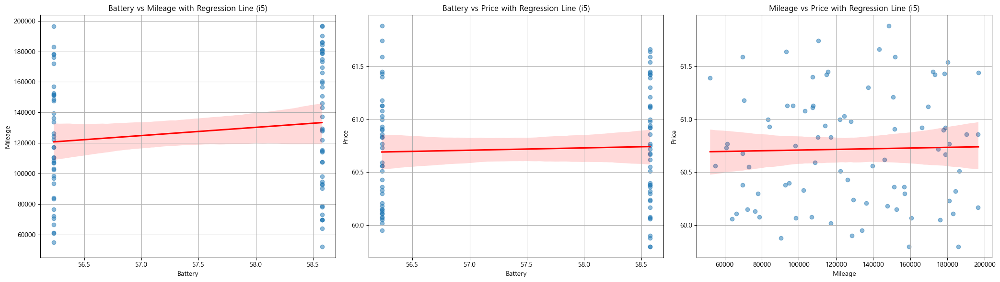

In [ ]:
# ----------------------------------------------------------------------------------------------------
# i5 모델 

model_name = "i5"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 0) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

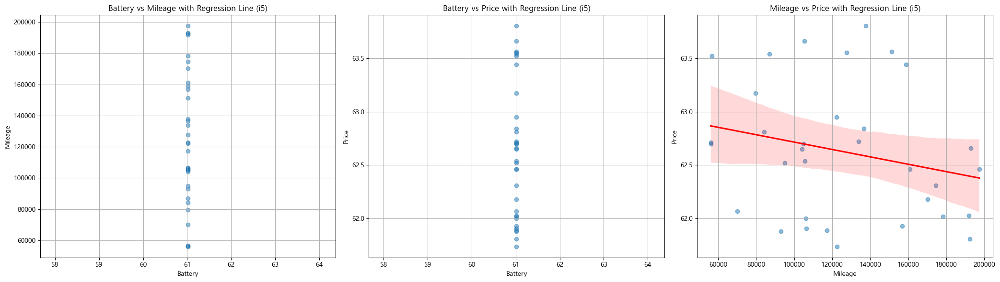

In [ ]:
# ----------------------------------------------------------------------------------------------------
# i5 모델 

model_name = "i5"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 1) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

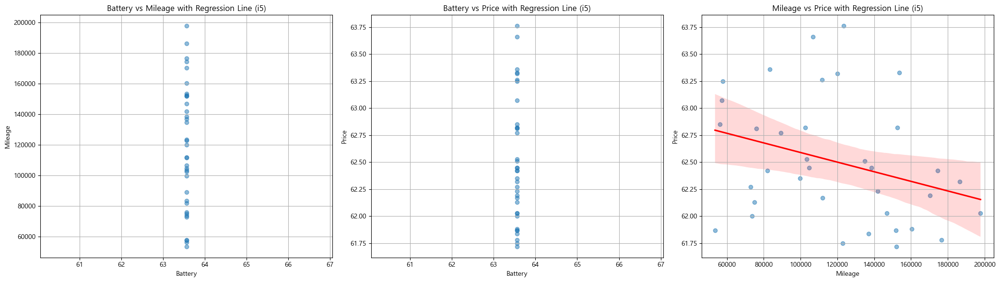

In [ ]:
# ----------------------------------------------------------------------------------------------------
# i5 모델 

model_name = "i5"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 2) &
                      (learning["Condition"] == "Pre-Owned"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

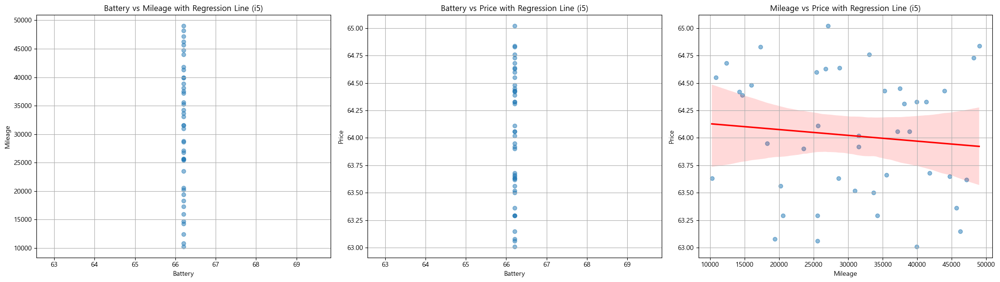

In [ ]:
# ----------------------------------------------------------------------------------------------------
# i5 모델 

model_name = "i5"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 3) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

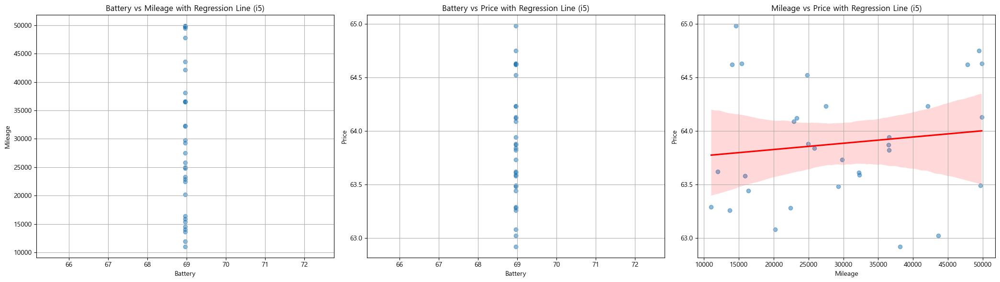

In [ ]:
# ----------------------------------------------------------------------------------------------------
# i5 모델 

model_name = "i5"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 4) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

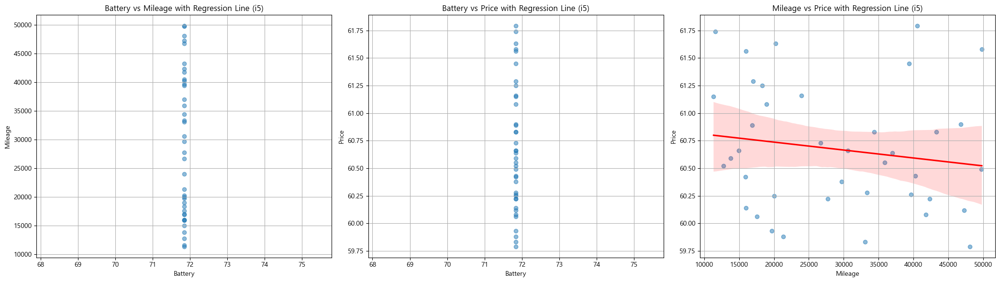

In [ ]:
# ----------------------------------------------------------------------------------------------------
# i5 모델 

model_name = "i5"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 5) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

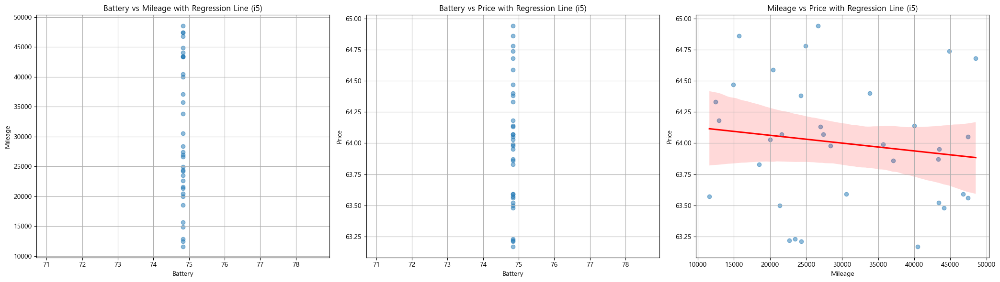

In [ ]:
# ----------------------------------------------------------------------------------------------------
# i5 모델 

model_name = "i5"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 6) &
                      (learning["Condition"] == "Nearly New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

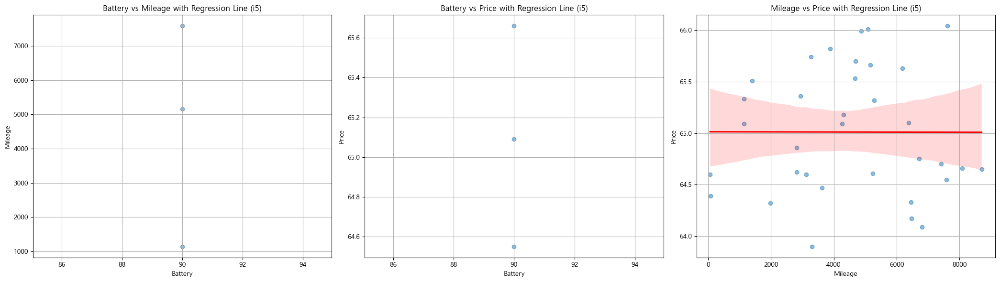

In [ ]:
# ----------------------------------------------------------------------------------------------------
# i5 모델 

model_name = "i5"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 7) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

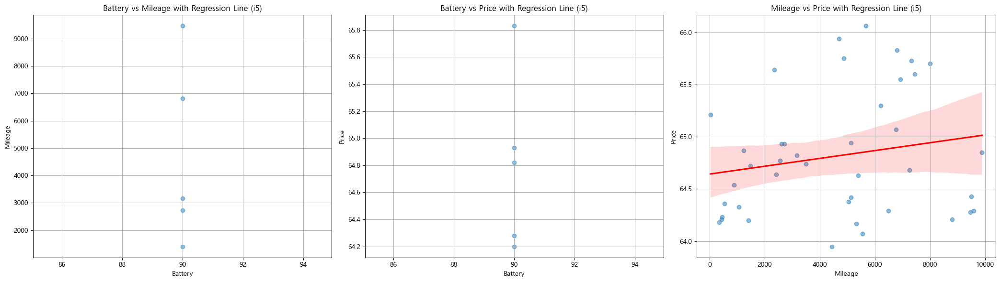

In [ ]:
# ----------------------------------------------------------------------------------------------------
# i5 모델 

model_name = "i5"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 8) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)


# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

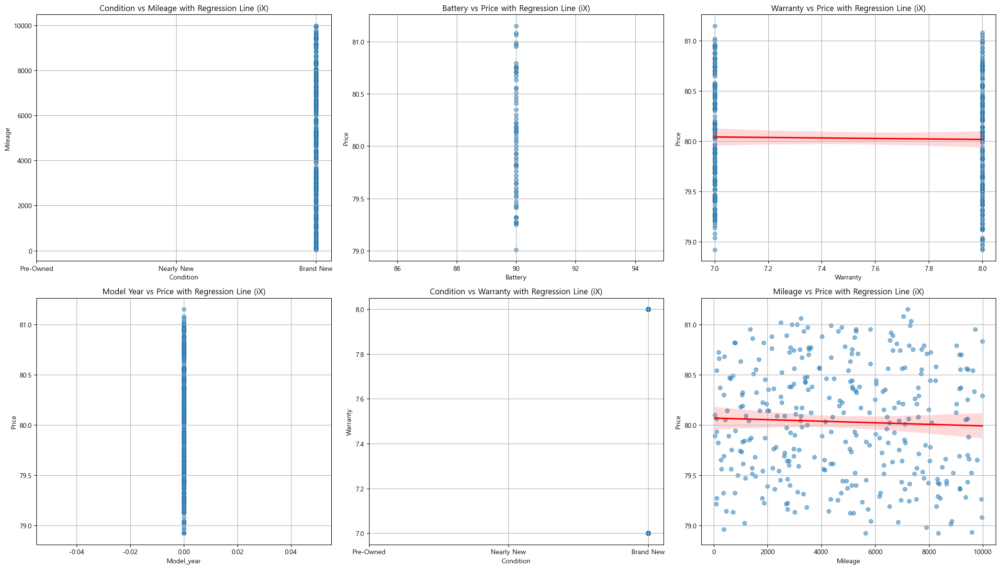

In [50]:
# ----------------------------------------------------------------------------------------------------
# iX 모델 

model_name = "iX"

result = learning.loc[(learning["Model"] == model_name), :]

result.loc[result["Condition"] == "Brand New","Condition"] = 2.0
result.loc[result["Condition"] == "Nearly New","Condition"] = 1.0
result.loc[result["Condition"] == "Pre-Owned","Condition"] = 0.0

result["Condition"] = result["Condition"].astype("float64")

# Figure 생성
plt.figure(figsize=(21, 12))

# 1행 3열 그래프
plt.subplot(2, 3, 1)  # (2행 3열) 중 1번째
sns.regplot(data=result, x="Condition", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Mileage")
plt.title(f"Condition vs Mileage with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 2)  # (2행 3열) 중 2번째
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 3)  # (2행 3열) 중 3번째
sns.regplot(data=result, x="Warranty", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Warranty")
plt.ylabel("Price")
plt.title(f"Warranty vs Price with Regression Line ({model_name})")
plt.grid(True)

# 2행 3열 그래프
plt.subplot(2, 3, 4)  # (2행 3열) 중 4번째
sns.regplot(data=result, x="Model_year", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Model_year")
plt.ylabel("Price")
plt.title(f"Model Year vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(2, 3, 5)  # (2행 3열) 중 5번째
sns.regplot(data=result, x="Condition", y="Warranty", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Condition")
plt.ylabel("Warranty")
plt.title(f"Condition vs Warranty with Regression Line ({model_name})")
plt.xticks(ticks=[0.0, 1.0, 2.0], labels=["Pre-Owned", "Nearly New", "Brand New"])
plt.grid(True)

plt.subplot(2, 3, 6)  # (2행 3열) 중 6번째
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()  # 그래프 간 간격 자동 조정
plt.show()
# ----------------------------------------------------------------------------------------------------

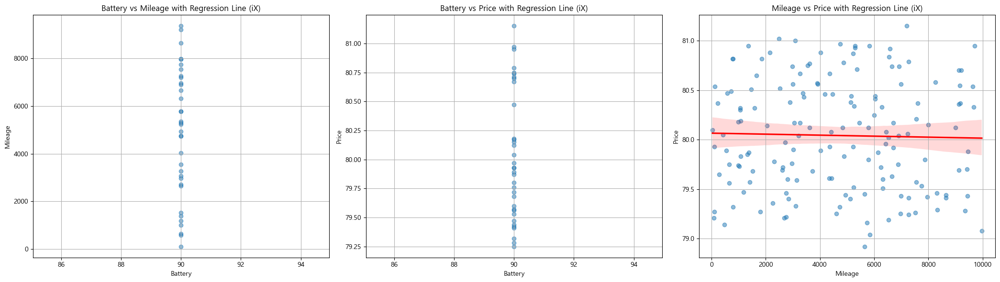

In [ ]:
# ----------------------------------------------------------------------------------------------------
# iX 모델 

model_name = "iX"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 7) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------

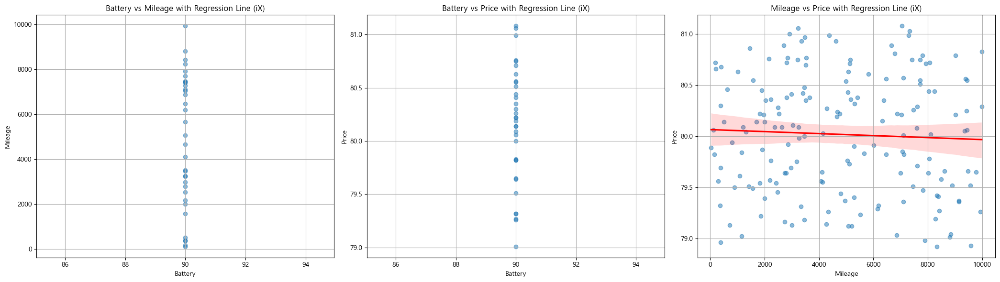

In [ ]:
# ----------------------------------------------------------------------------------------------------
# iX 모델 

model_name = "iX"

result = learning.loc[(learning["Model"] == model_name) &
                      (learning["Warranty"] == 8) &
                      (learning["Condition"] == "Brand New"), :]

# Figure 생성
plt.figure(figsize=(21, 6))

#  시각화
plt.subplot(1, 3, 1)  # 1행 3열 중 1 번째 그래프
sns.regplot(data=result, x="Battery", y="Mileage", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Mileage")
plt.title(f"Battery vs Mileage with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 2)  # 1행 3열 중 2 번째 그래프
sns.regplot(data=result, x="Battery", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Battery")
plt.ylabel("Price")
plt.title(f"Battery vs Price with Regression Line ({model_name})")
plt.grid(True)

plt.subplot(1, 3, 3)  # 1행 3열 중 3 번째 그래프
sns.regplot(data=result, x="Mileage", y="Price", scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.xlabel("Mileage")
plt.ylabel("Price")
plt.title(f"Mileage vs Price with Regression Line ({model_name})")
plt.grid(True)

# 전체 그래프 표시
plt.tight_layout()
plt.show()
# ----------------------------------------------------------------------------------------------------